In [1]:
using Pkg
using Conda
using WebIO
using Interact
using DifferentialEquations
using DiffEqFlux
using DiffEqSensitivity, OrdinaryDiffEq, Zygote
using Plots
using Lux, Optim, Test
using Optimization, OptimizationPolyalgorithms

using BifurcationKit
using Revise
using SparseArrays, LinearAlgebra, DiffEqOperators, Setfield, Parameters
using GaussianProcesses
using Distributions,Random
using ForwardDiff
using MAT
using CSV
using DataFrames

using DataDrivenDiffEq
using ModelingToolkit
using Surrogates,SurrogatesAbstractGPs
using ReservoirComputing

gr()

WebIO._IJuliaInit()

┌ Warning: OrcV2 initialization failed with
│   err = ErrorException("could not load library \"C:\\Users\\周天恒\\.julia\\artifacts\\12030a5c187a7e327b57d45e3397edf672ab442d\\bin\\libLLVMExtra-12.dll\"\nThe specified procedure could not be found. ")
└ @ Enzyme.Compiler.JIT C:\Users\周天恒\.julia\packages\Enzyme\di3zM\src\compiler\orcv2.jl:103
┌ Info: DataDrivenDiffEq : OccamNet is available.
└ @ DataDrivenDiffEq C:\Users\周天恒\.julia\packages\DataDrivenDiffEq\s9jl3\src\DataDrivenDiffEq.jl:168


Plots.GRBackend()

In [2]:
function Duffing(u,p,t)
    b,alpha_2,mu,v,rho,delta_st,wn_2,Phi,w = p
    x,y = u
    du1 = y
    du2 = -b*y - alpha_2*x - mu*x^3 - v*x^5 - rho*x^7 + delta_st * wn_2 *Phi * cos(w*t)
    du = [du1,du2]
end

function Duffing_Approx(u,p,t)
    b,alpha_2,mu,v,rho,delta_st,wn_2,Phi,w = p
    x,y = u
    du1 = y
    #there is no v and rho
    du2 = -b*y - alpha_2*x - mu*x^3 + delta_st * wn_2 *Phi * cos(w*t)
    du = [du1,du2]
end

Duffing_Approx (generic function with 1 method)

In [3]:
initial_1 = [1.0,0.0]
datasize_1 = 20
timespan_1 = (0.0,10.0)
t_1 = range(timespan_1[1],timespan_1[2],length=datasize_1)
#param_1 = [0.3159,1.0,1.499,-0.3921,0.0422,1.0,1.0,1.0,round(2*pi*19.95,digits = 3)]
param_1 = [0.3159,1.0,1.499,-1.0,0.0422,1.0,1.0,1.0,round(2*pi*19.95,digits = 3)]
prob_Duffing = ODEProblem(Duffing,initial_1,timespan_1,param_1)
sol_Duffing = solve(prob_Duffing,Tsit5(),saveat=t_1)

prob_Duffing_A = ODEProblem(Duffing_Approx,initial_1,timespan_1,param_1)
sol_Duffing_A = solve(prob_Duffing_A,Tsit5(),saveat=t_1)

retcode: Success
Interpolation: 1st order linear
t: 20-element Vector{Float64}:
  0.0
  0.5263157894736842
  1.0526315789473684
  1.5789473684210527
  2.1052631578947367
  2.6315789473684212
  3.1578947368421053
  3.6842105263157894
  4.2105263157894735
  4.7368421052631575
  5.2631578947368425
  5.7894736842105265
  6.315789473684211
  6.842105263157895
  7.368421052631579
  7.894736842105263
  8.421052631578947
  8.947368421052632
  9.473684210526315
 10.0
u: 20-element Vector{Vector{Float64}}:
 [1.0, 0.0]
 [0.7075137832645869, -0.9660025505790213]
 [0.1377353305695019, -1.1012410892929378]
 [-0.3877505568486175, -0.8538257700480537]
 [-0.7025199934024, -0.2880252643720388]
 [-0.6735678126384862, 0.37140196230056044]
 [-0.37598613936169717, 0.6888894604731564]
 [-0.004706982326779668, 0.6828069763559168]
 [0.31100631400081175, 0.4942340850421393]
 [0.4875641883347875, 0.15828979344087216]
 [0.47445883384159876, -0.19556174908587498]
 [0.3079624383954879, -0.40657929628418565]
 [0.077

In [4]:
t_5 = range(timespan_1[1],timespan_1[2],length=5)
t_10 = range(timespan_1[1],timespan_1[2],length=10)
t_15 = range(timespan_1[1],timespan_1[2],length=15)
t_30 = range(timespan_1[1],timespan_1[2],length=30)
t_45 = range(timespan_1[1],timespan_1[2],length=45)
t_true = range(timespan_1[1],timespan_1[2],length=1000)


prob_Duffing = ODEProblem(Duffing,initial_1,timespan_1,param_1)
sol_Duffing_5 = solve(prob_Duffing,Tsit5(),saveat=t_5)
sol_Duffing_10 = solve(prob_Duffing,Tsit5(),saveat=t_10)
sol_Duffing_15 = solve(prob_Duffing,Tsit5(),saveat=t_15)
sol_Duffing_30 = solve(prob_Duffing,Tsit5(),saveat=t_30)
sol_Duffing_45 = solve(prob_Duffing,Tsit5(),saveat=t_45)
sol_Duffing_true = solve(prob_Duffing,Tsit5(),saveat=t_true)

timespan_2 = (0,12)
prob_Duffing_2 = ODEProblem(Duffing,initial_1,(0,12),param_1)
t_true_12 = range(timespan_2[1],timespan_2[2],length = 1201)
sol_Duffing_true_12 = solve(prob_Duffing_2,Tsit5(),saveat=t_true_12)

retcode: Success
Interpolation: 1st order linear
t: 1201-element Vector{Float64}:
  0.0
  0.01
  0.02
  0.03
  0.04
  0.05
  0.06
  0.07
  0.08
  0.09
  0.1
  0.11
  0.12
  ⋮
 11.89
 11.9
 11.91
 11.92
 11.93
 11.94
 11.95
 11.96
 11.97
 11.98
 11.99
 12.0
u: 1201-element Vector{Vector{Float64}}:
 [1.0, 0.0]
 [0.9999667595780697, -0.00782197402021255]
 [0.9998069919279216, -0.0260330774977596]
 [0.9994234558327589, -0.05067826221078608]
 [0.998816115898468, -0.06888183587173323]
 [0.9980829112036719, -0.07654716032492938]
 [0.9972856617017324, -0.08403410435993175]
 [0.9963657379528157, -0.1018317869292094]
 [0.9952255710429456, -0.12623434591712035]
 [0.9938637173285196, -0.14427639588899943]
 [0.9923780237394543, -0.15172371358580614]
 [0.9908299849107354, -0.15887739409042176]
 [0.9891636336343137, -0.17624414174076486]
 ⋮
 [0.1628084652113291, -0.06878422631369555]
 [0.16210600059788952, -0.07347157270625666]
 [0.16131610466220944, -0.08437709519975428]
 [0.16044548349176466, -0.08

1206.7057561997542

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


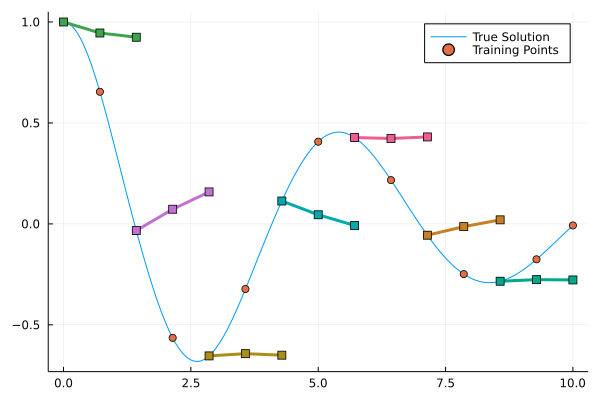

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1040.3621555286015

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


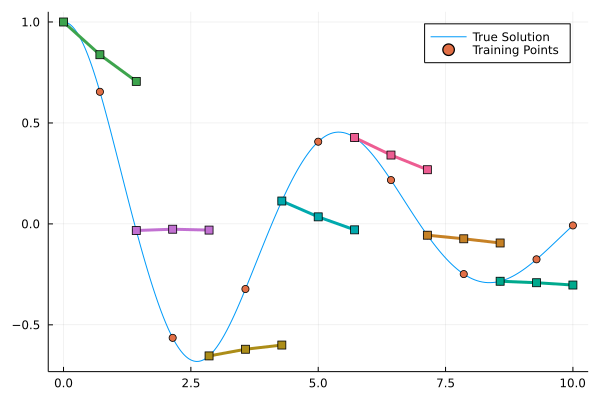

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


894.5574339186635

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


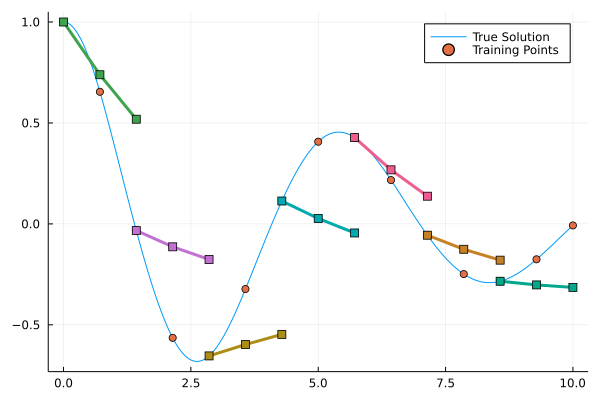

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


769.9689872675407

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


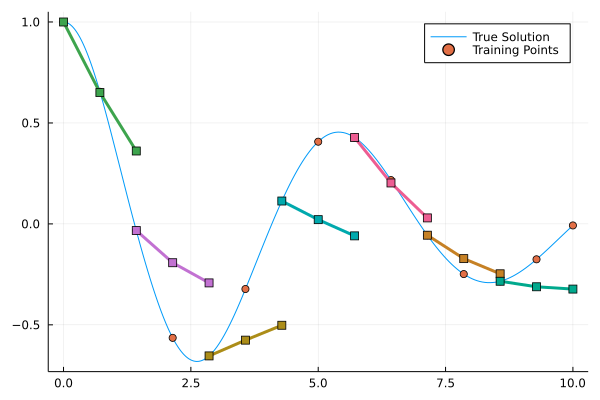

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


676.0261953833646

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


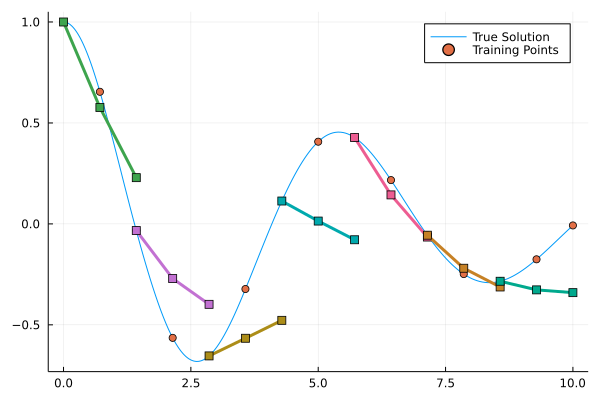

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


625.225942748911

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


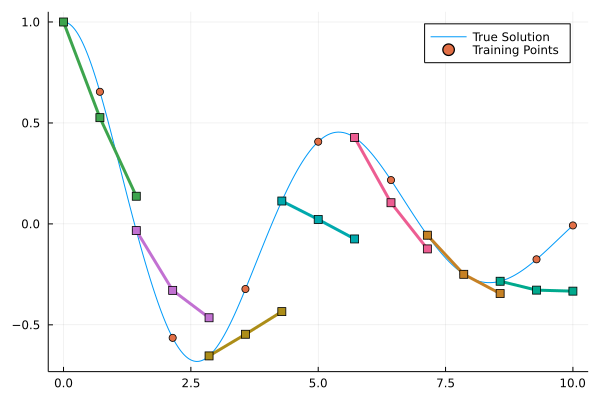

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


567.9342291122848

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


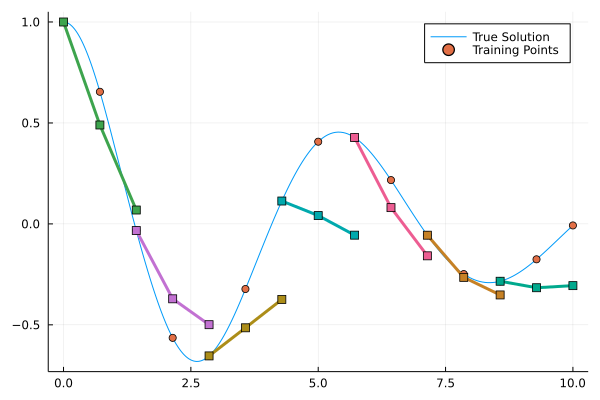

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


518.9889614601769

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


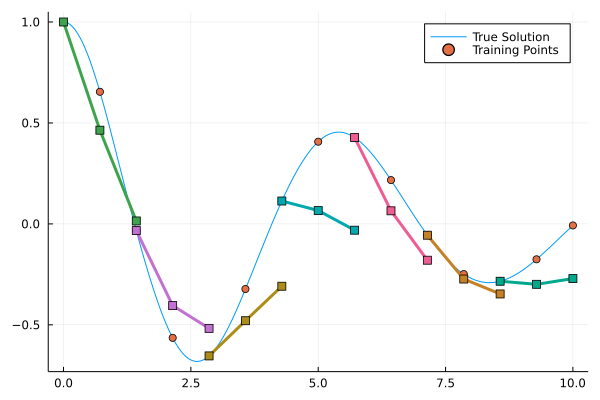

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


465.4456686535438

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


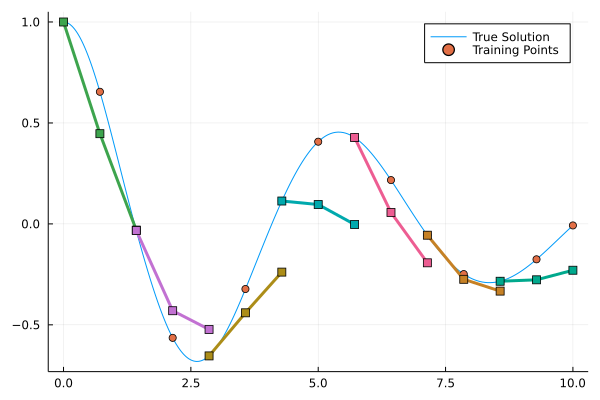

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


423.6700139242544

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


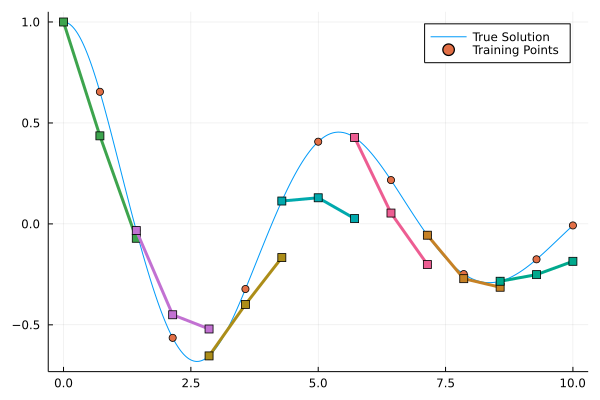

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


374.2216285658933

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


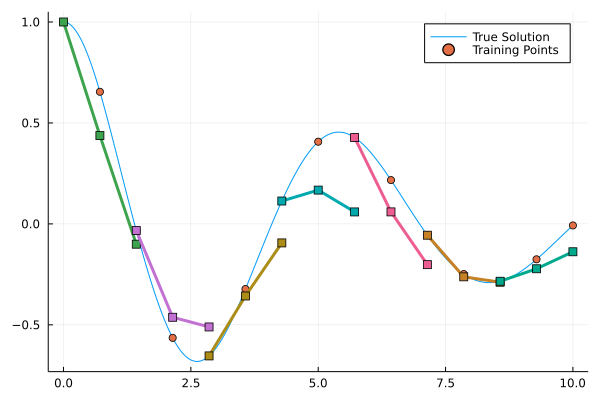

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


325.9436174471233

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


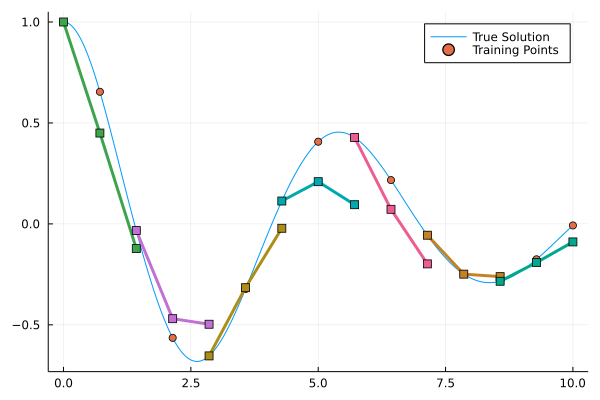

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


274.6277323179361

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


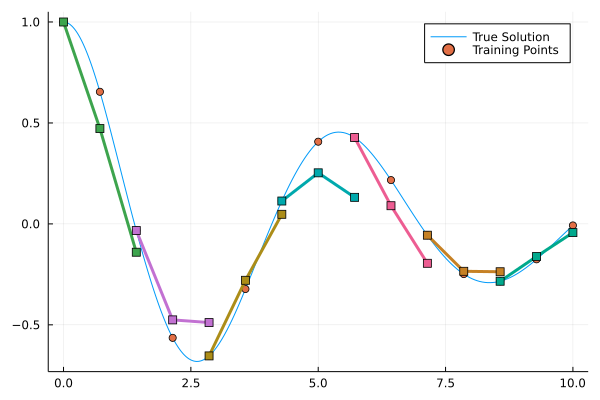

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


247.9352306070845

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


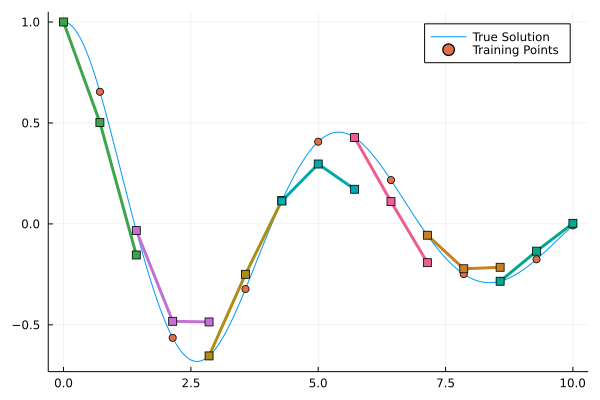

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


245.28568257637653

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


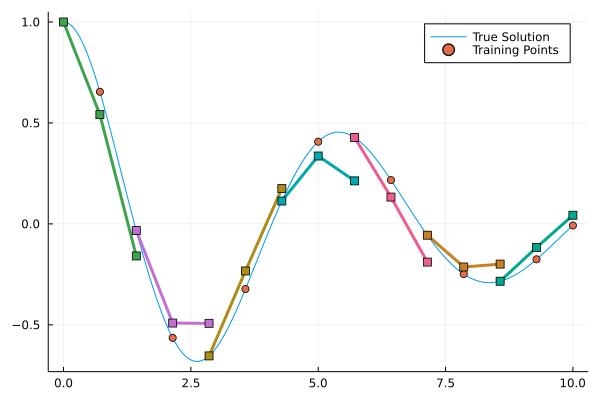

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


253.0822915501992

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


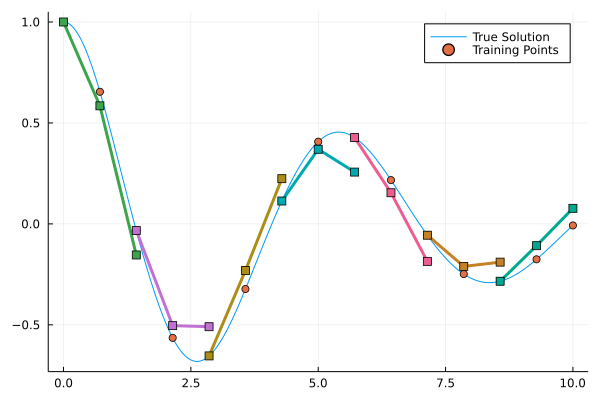

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


259.5933390148467

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


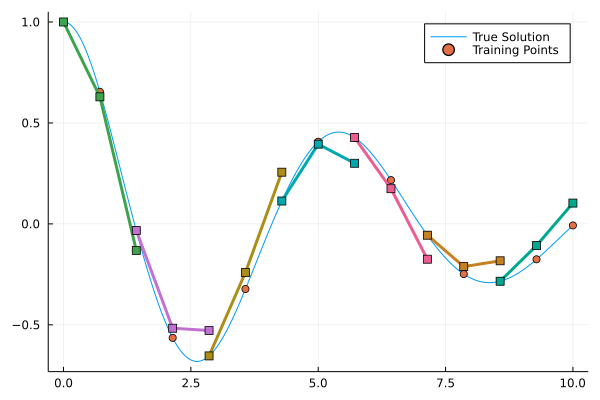

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


245.6974624106645

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


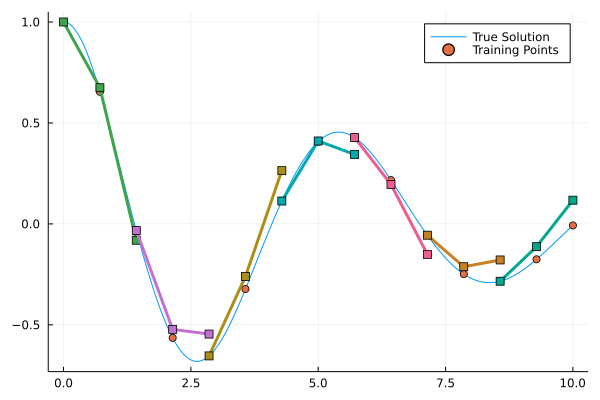

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


242.52586879974245

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


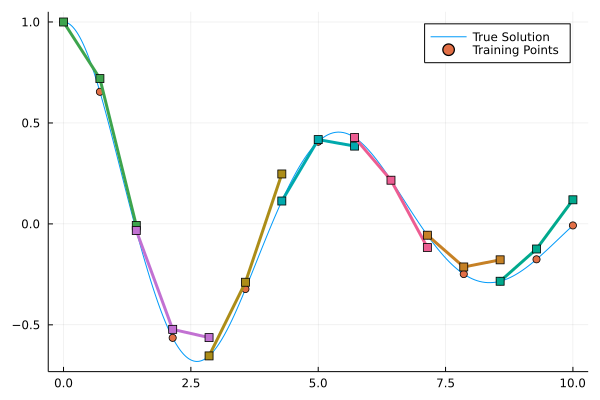

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


235.0827756058901

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


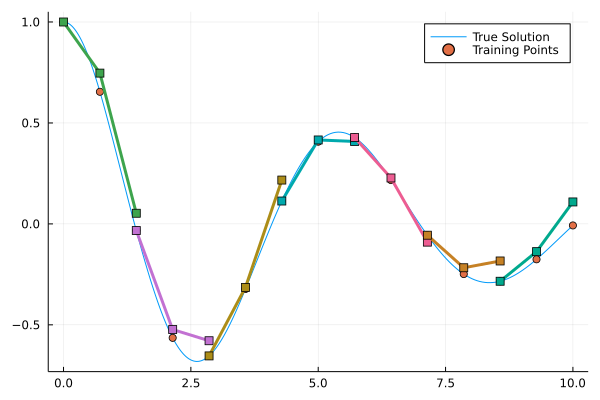

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


208.25805973714293

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


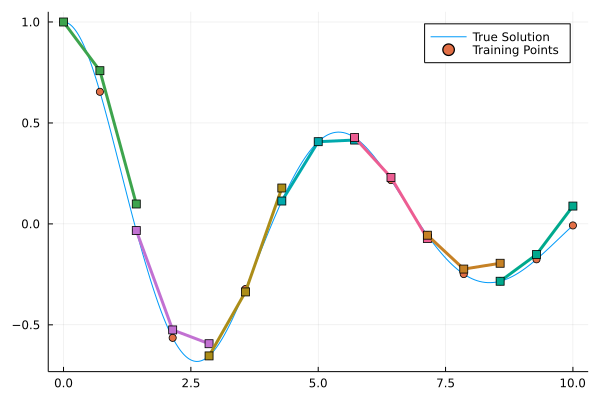

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


166.99147580665883

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


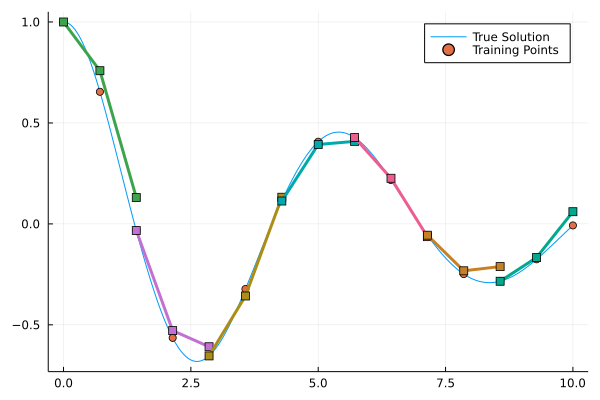

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


143.99891370654572

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


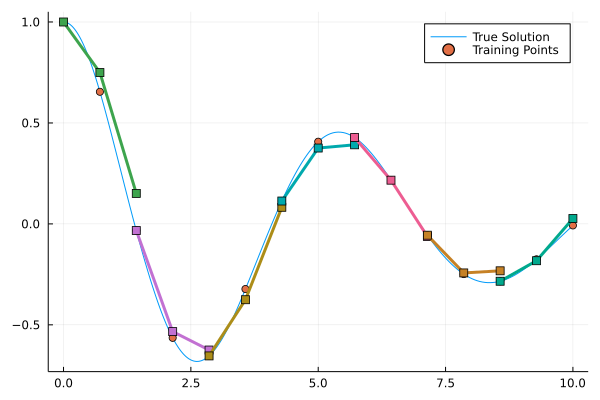

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


150.65627765655373

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


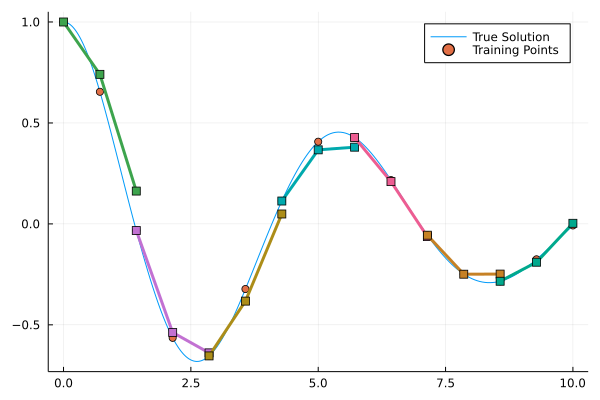

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


146.93212582306052

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


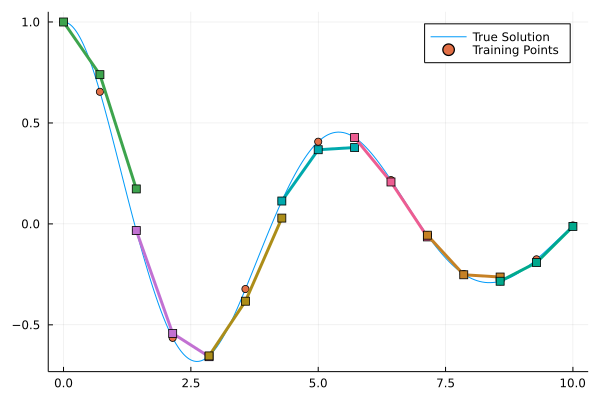

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


136.56641895950384

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


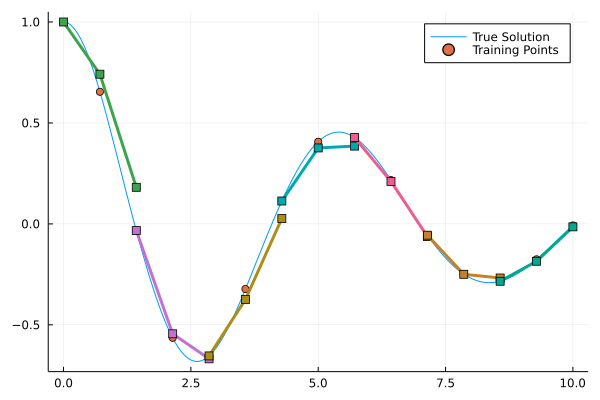

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.96673114215946

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


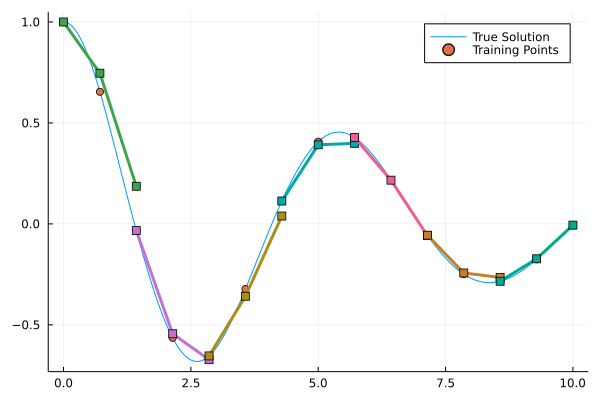

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


145.9331882777744

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


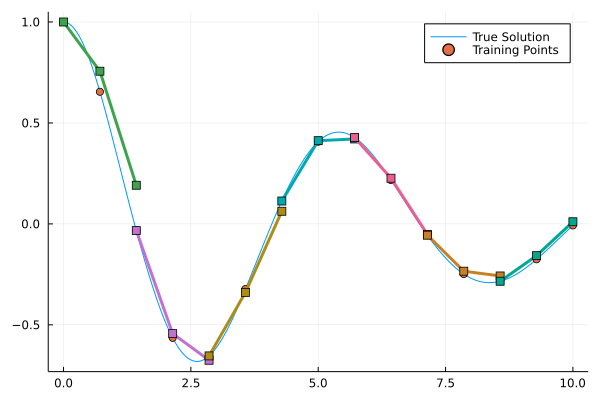

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


157.18066976867826

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


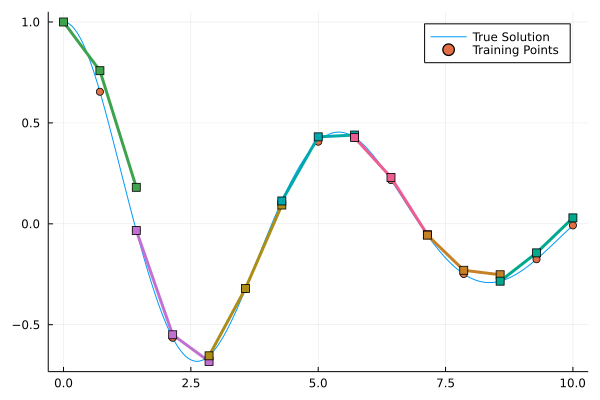

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


158.00427008378773

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


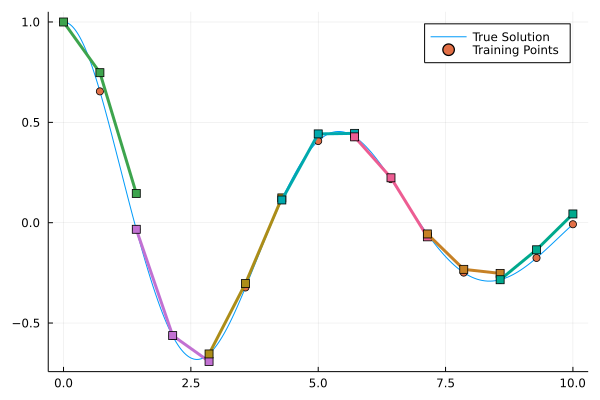

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


152.72538012531052

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


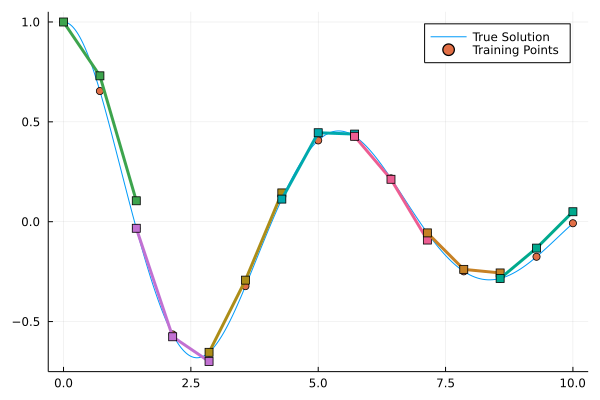

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


136.46615414464733

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


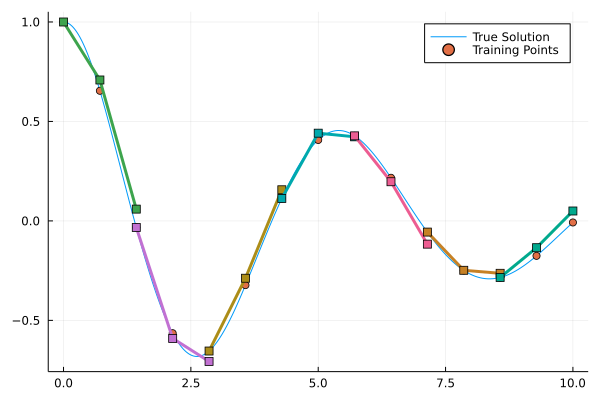

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


121.78006296609446

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


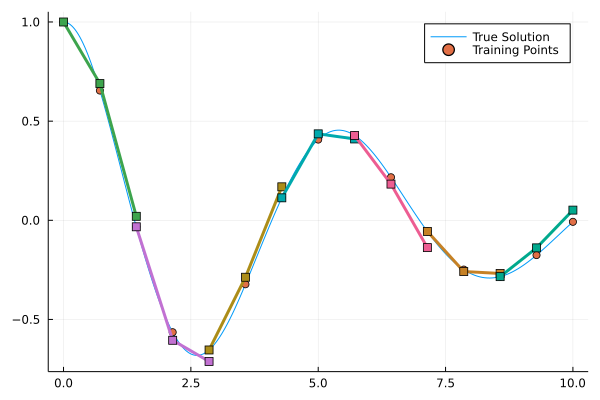

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


116.79093618568444

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


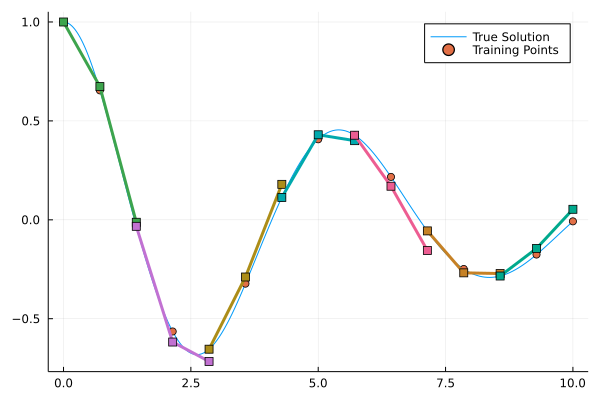

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


112.84454918424979

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


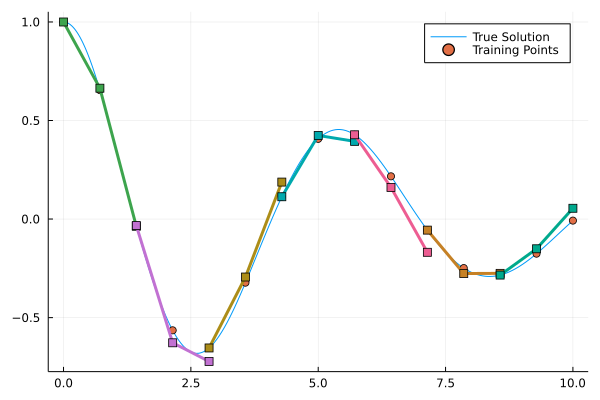

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


107.34583909823343

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


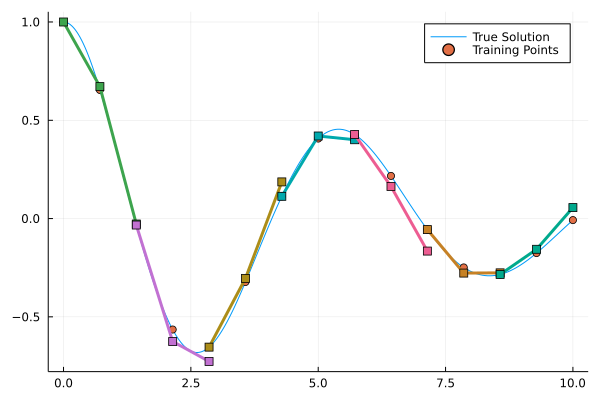

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


100.76118549532977

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


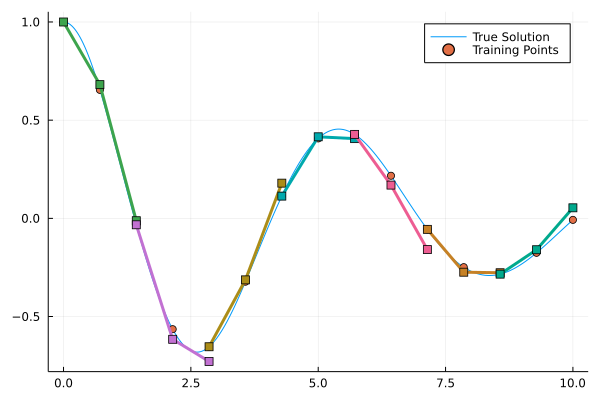

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


102.27644810966734

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


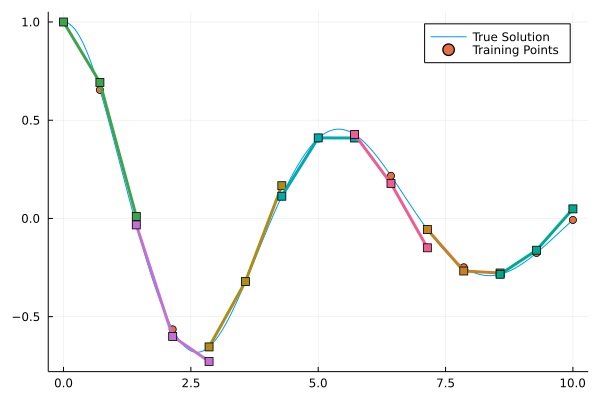

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


104.60431293429696

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


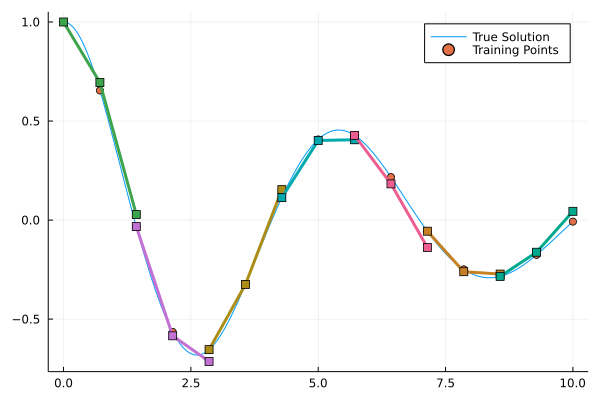

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


95.85756448030615

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


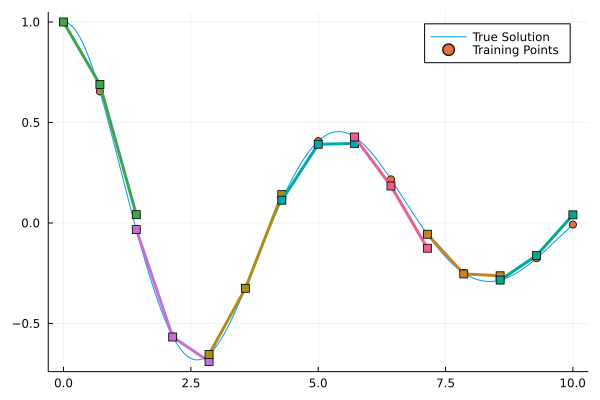

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


99.59615063138281

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


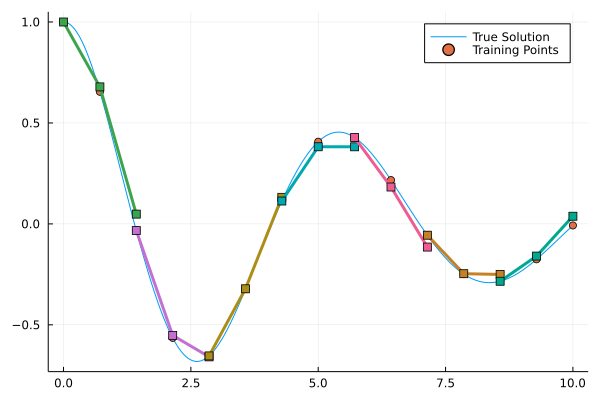

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


104.78389561303183

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


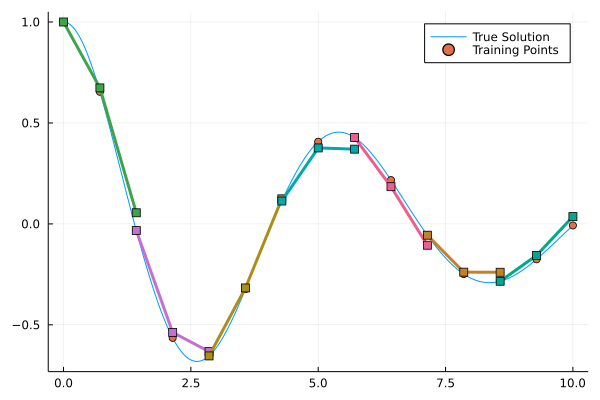

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


94.85959852763824

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


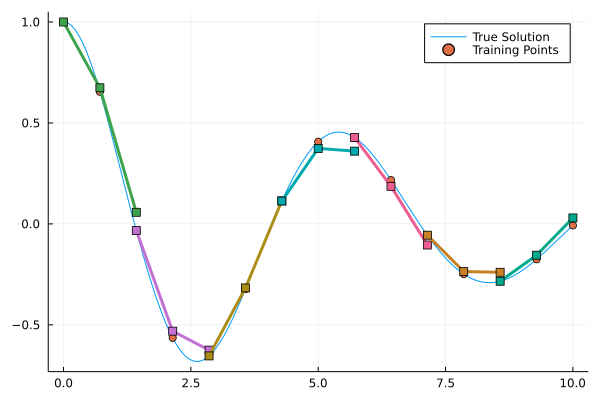

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


101.71183528756477

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


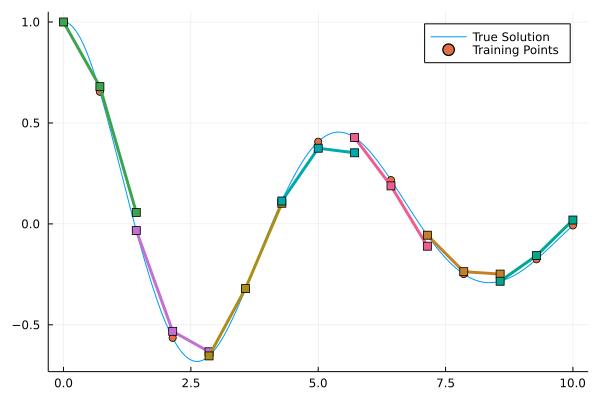

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


102.29493504752791

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


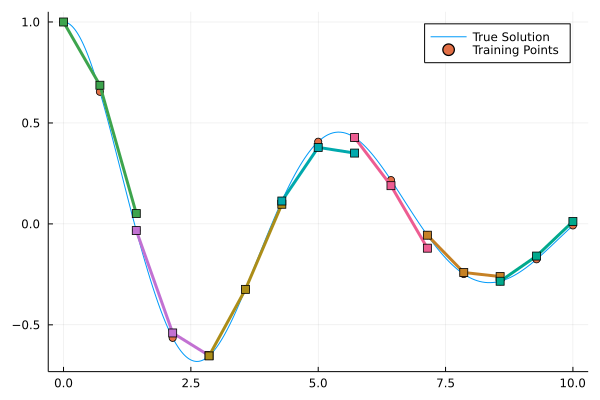

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


108.88353756783212

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


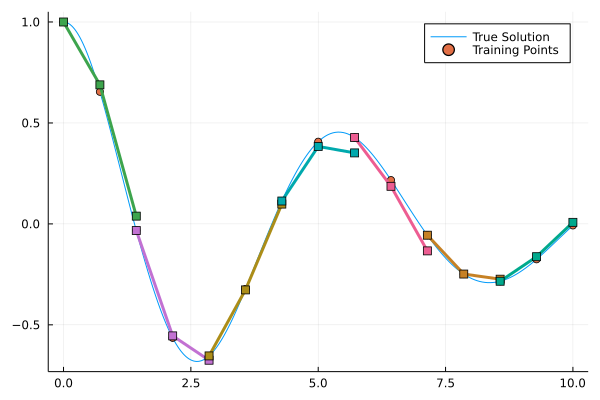

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


101.4899646936871

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


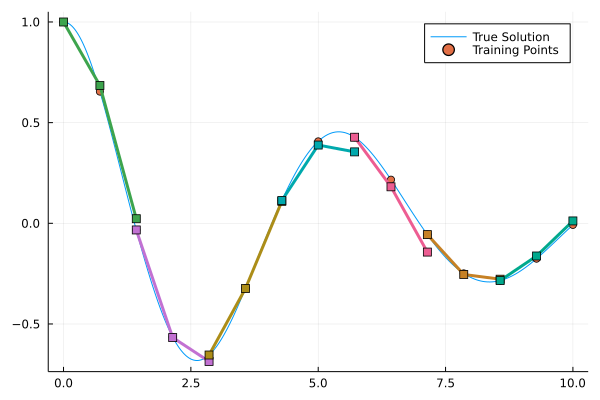

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


94.56305011495533

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


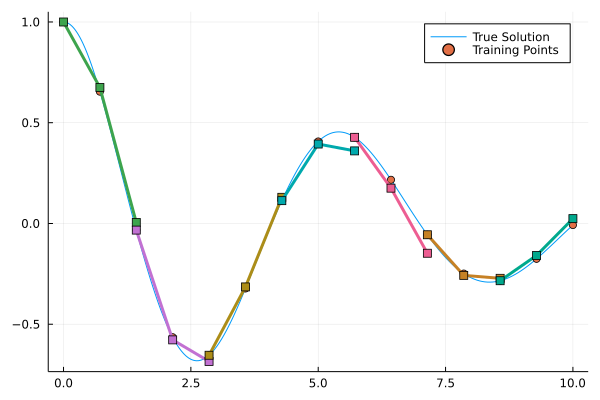

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


92.26268945221237

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


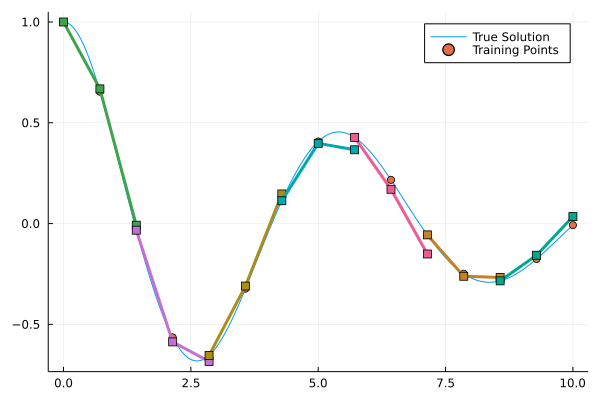

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


91.68549577538866

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


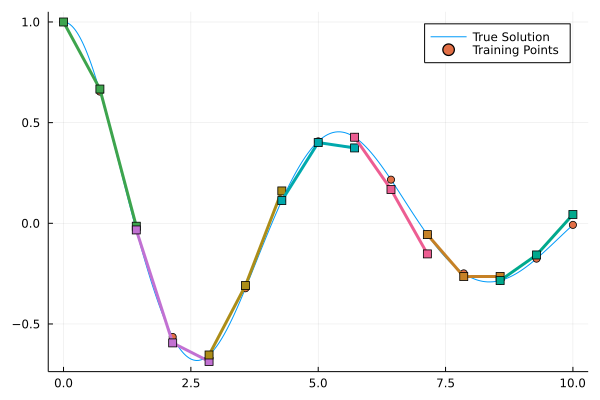

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


100.16066776379742

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


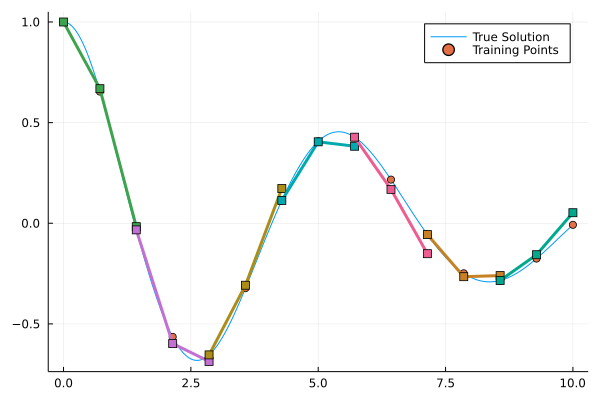

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


97.34803286944505

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


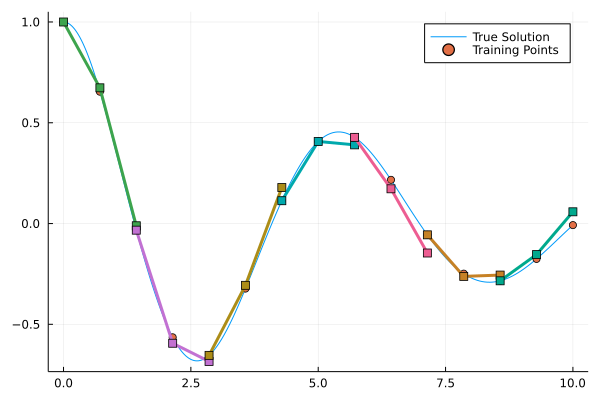

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


87.83652666315112

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


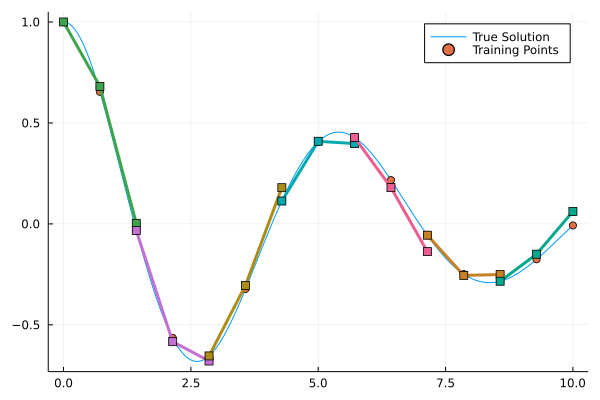

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


97.18175075966957

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


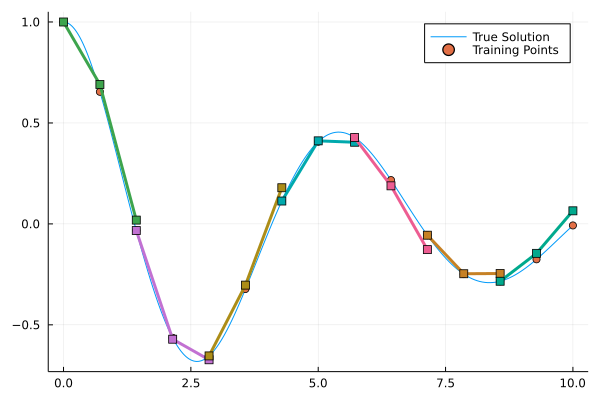

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


95.2015580821838

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


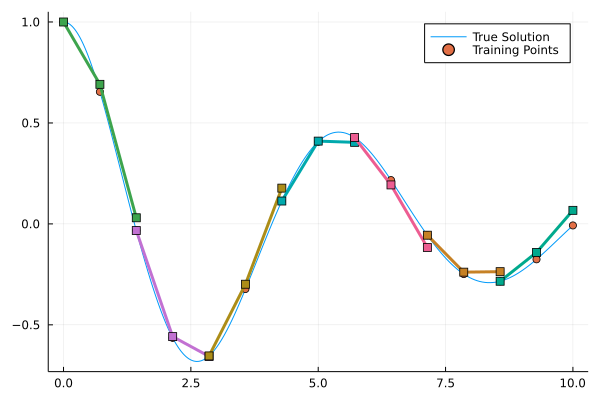

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


93.78256194053779

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


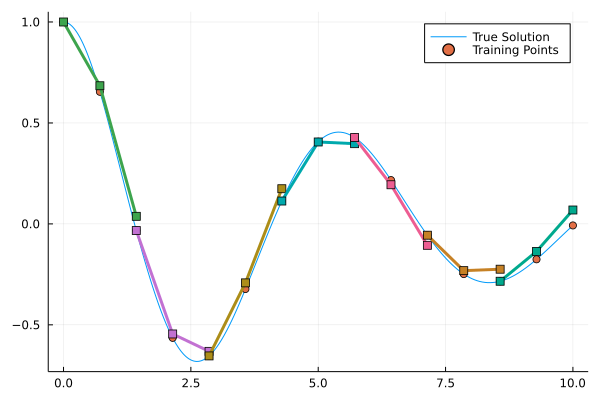

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


95.66421564222526

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


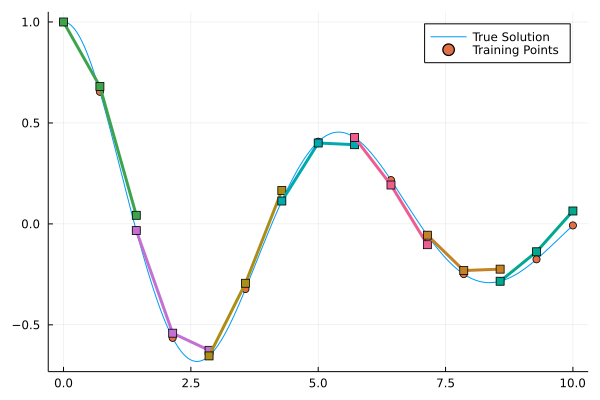

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


89.90162345309056

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


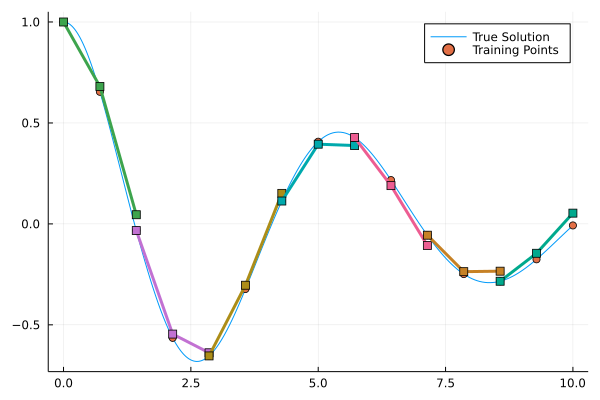

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.16313577646581

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


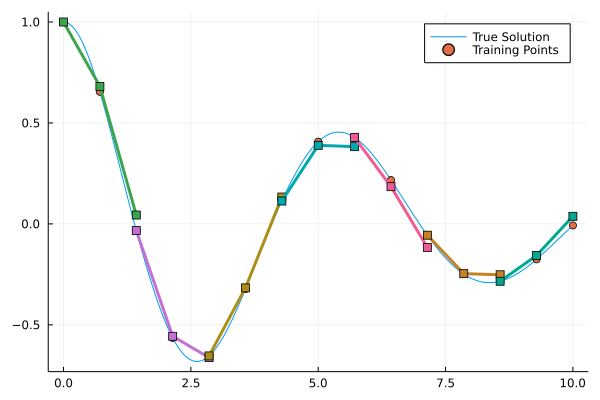

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


87.63321181187132

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


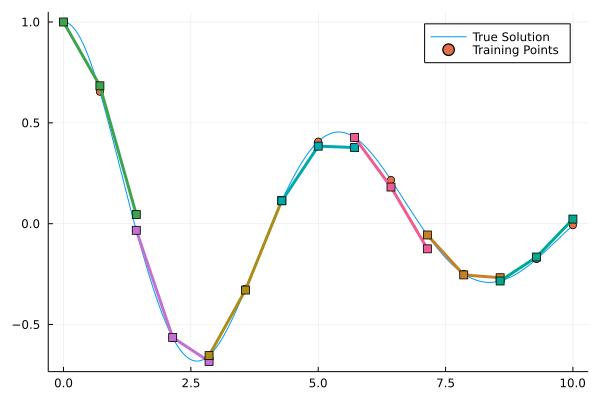

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


91.83024648083612

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


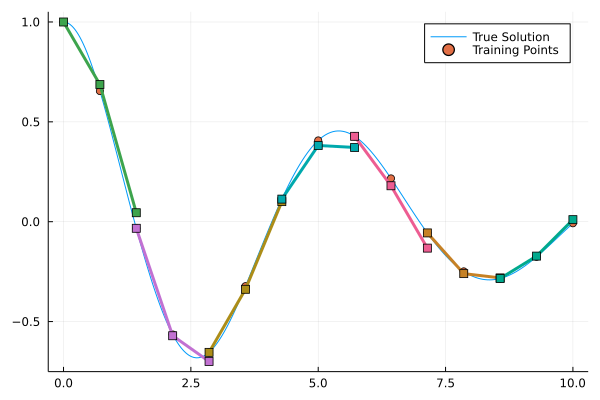

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


92.03601810645252

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


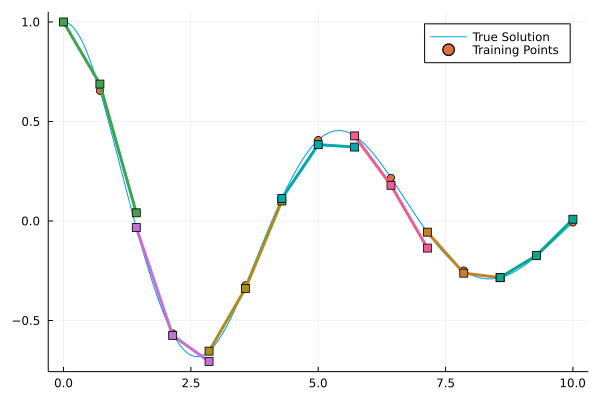

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.60116930793048

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


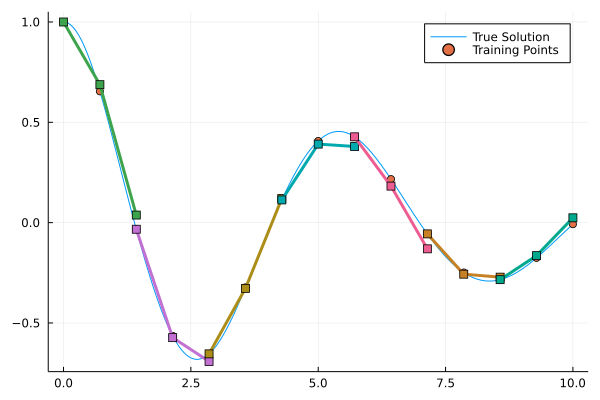

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.8778820108071

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


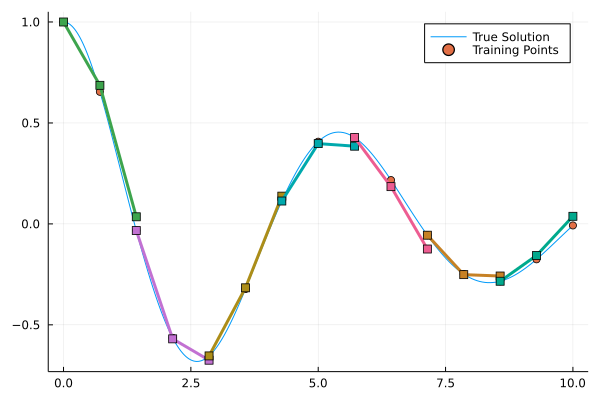

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.8362435302597

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


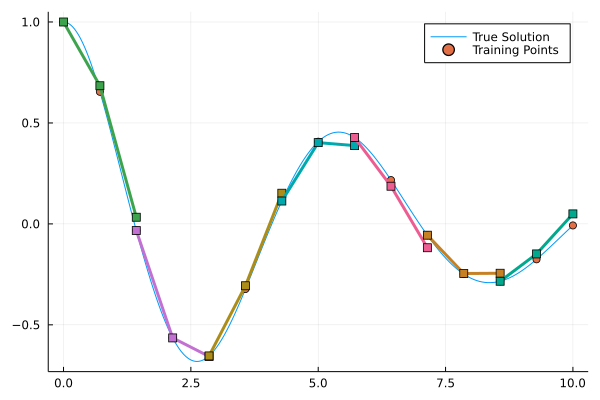

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


89.41215288686209

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


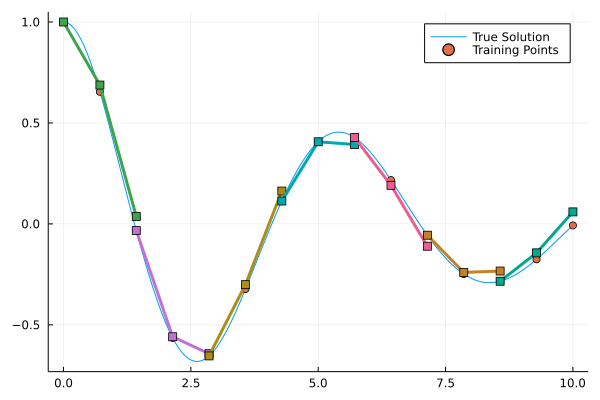

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.74406342846271

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


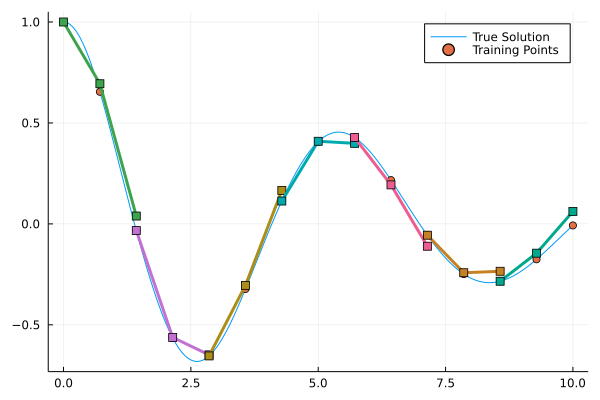

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.97509050694762

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


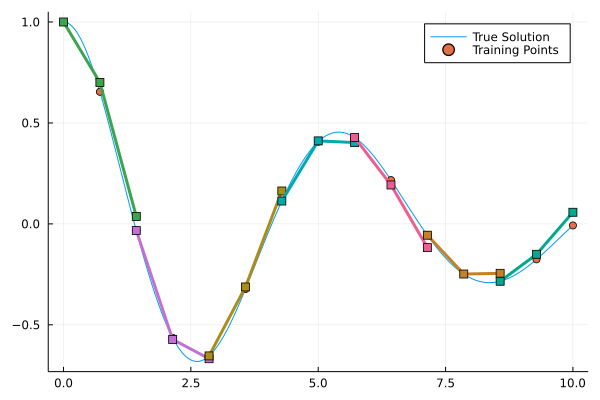

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.07790948245966

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


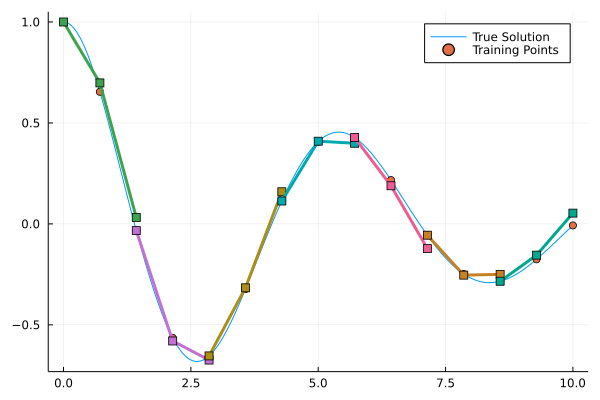

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


88.50211420604985

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


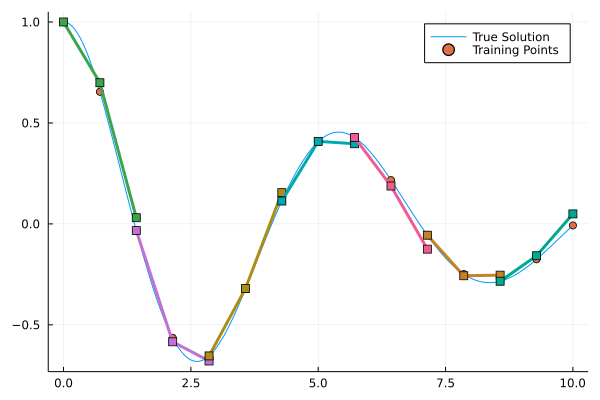

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.33028941590705

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


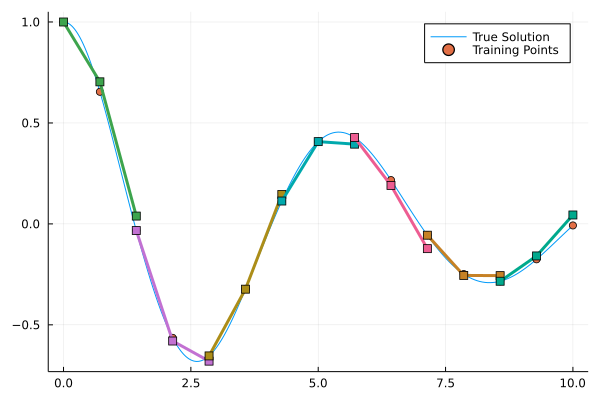

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


86.04404519787694

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


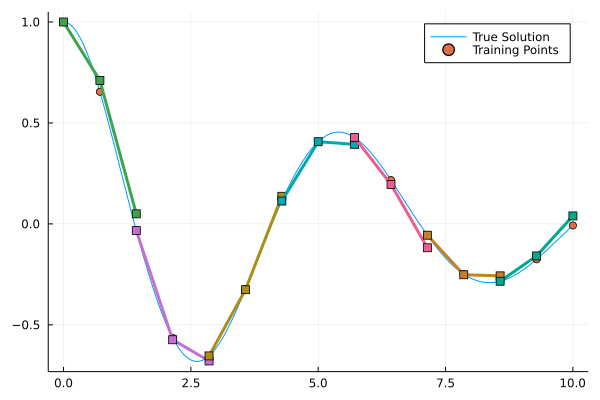

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.11734258542478

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


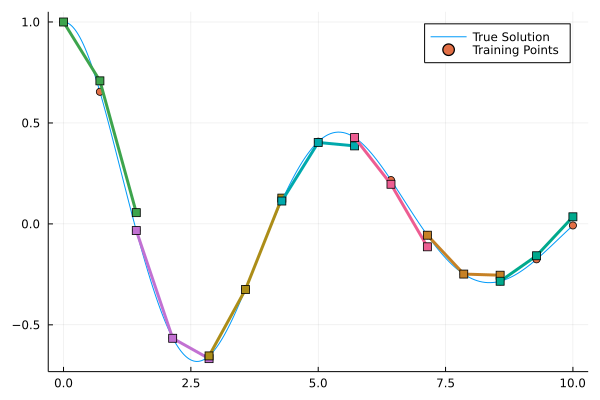

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.13953723428179

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


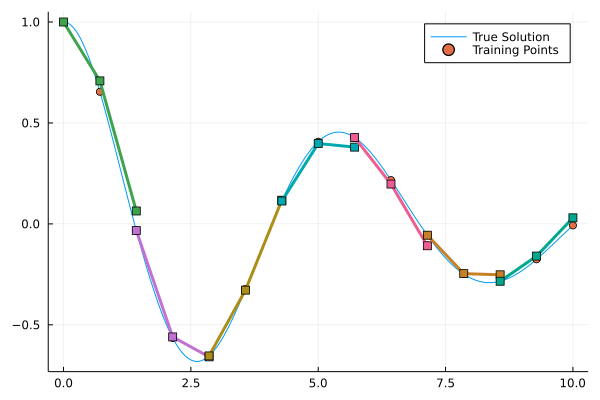

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.08424682825965

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


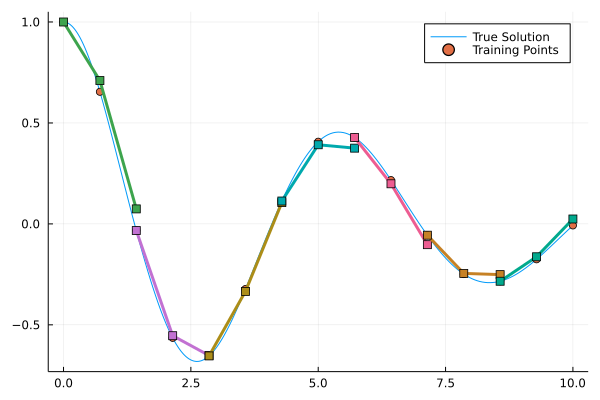

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.99515696510113

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


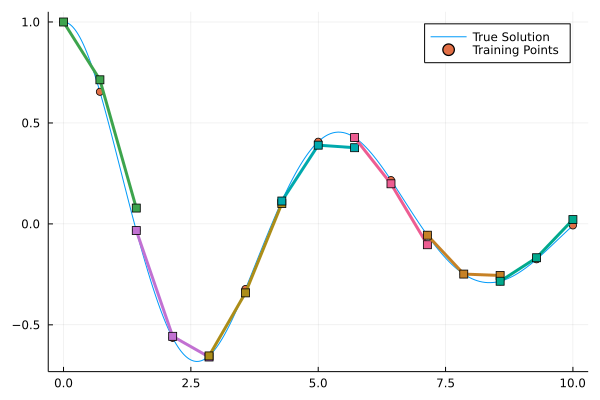

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.83847789526725

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


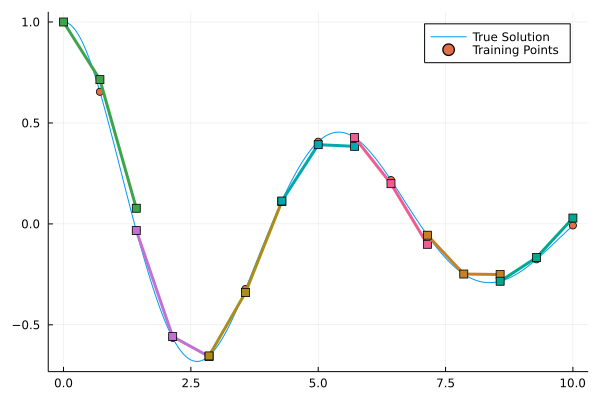

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.34164844603634

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


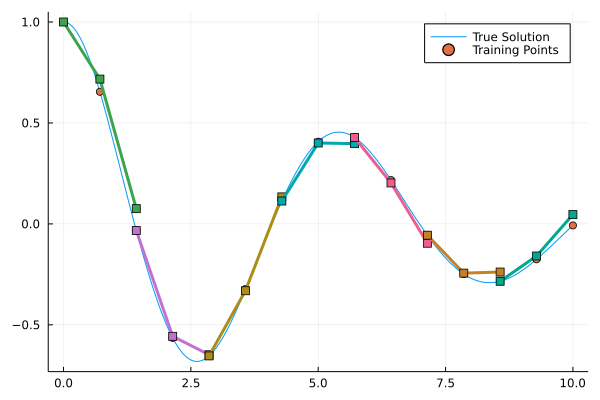

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


92.45800987254015

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


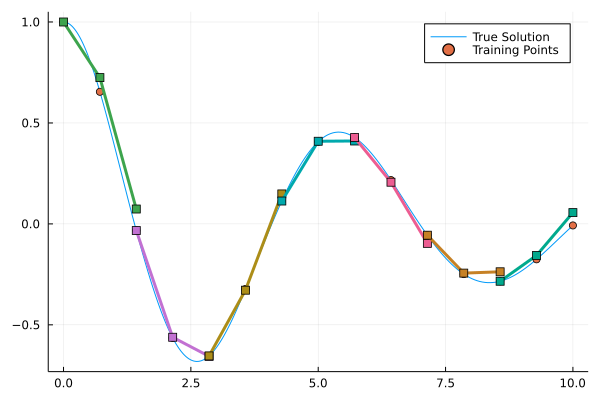

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


91.16873907074267

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


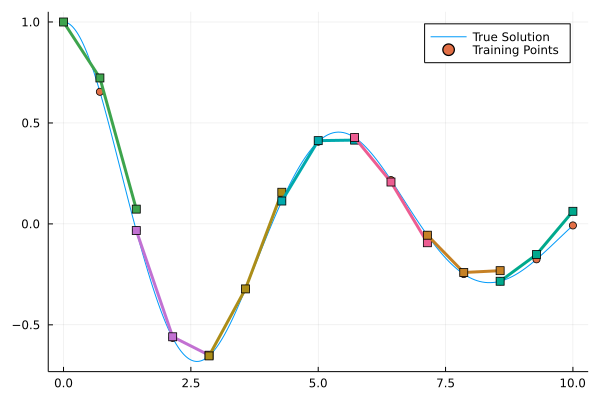

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.27788799990424

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


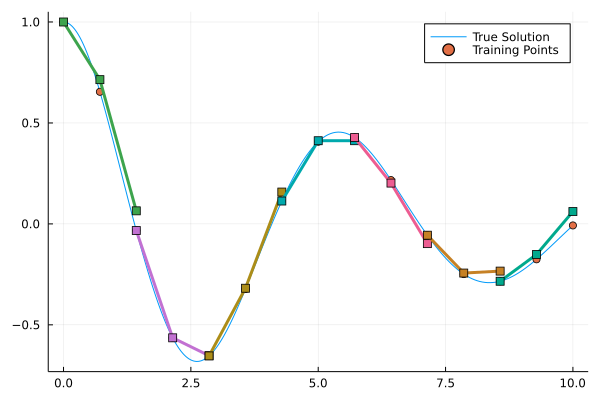

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.37112253230549

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


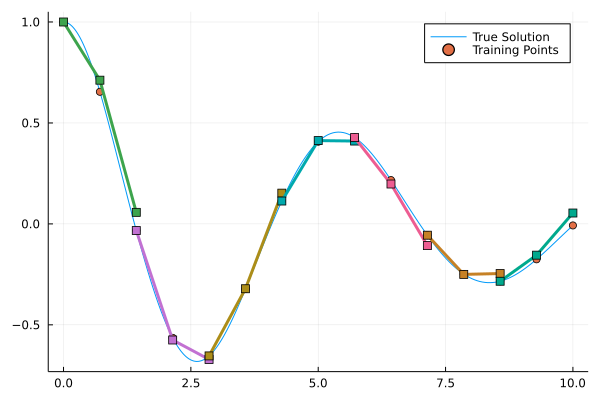

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.5093194731174

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


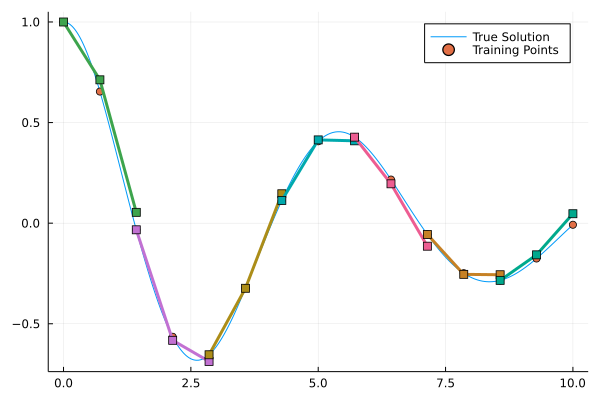

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.60834900584113

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


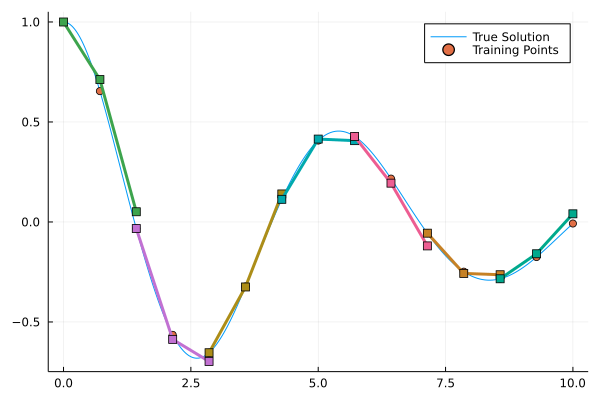

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.72217924526464

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


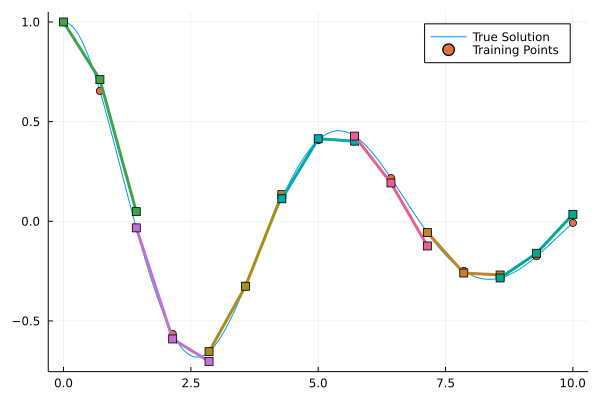

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.51924263305966

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


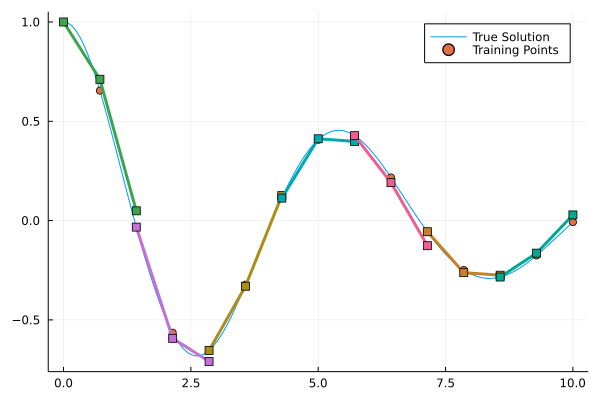

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


82.08202062740916

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


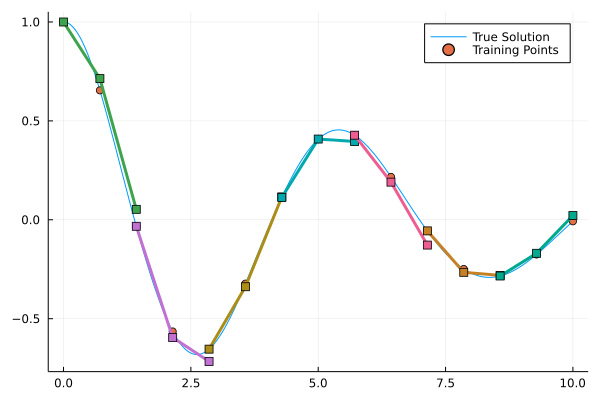

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


86.03503295818473

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


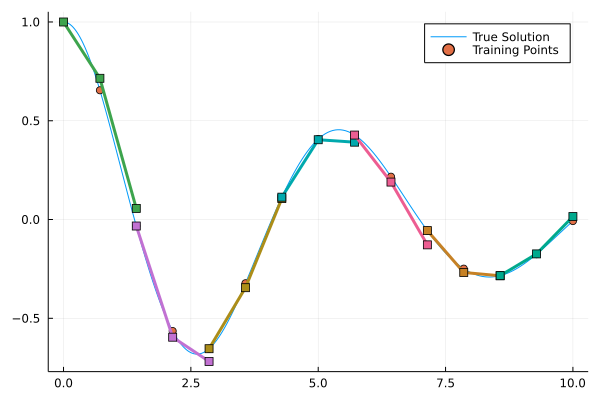

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


81.3577268631347

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


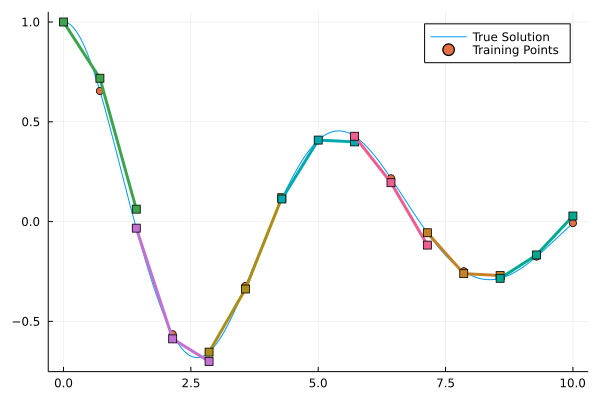

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.32079124363817

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


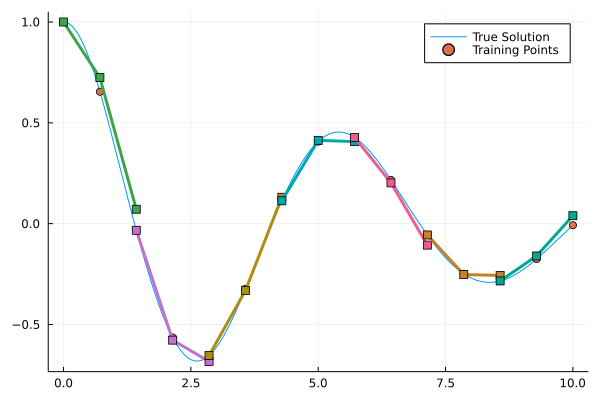

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.0926706789531

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


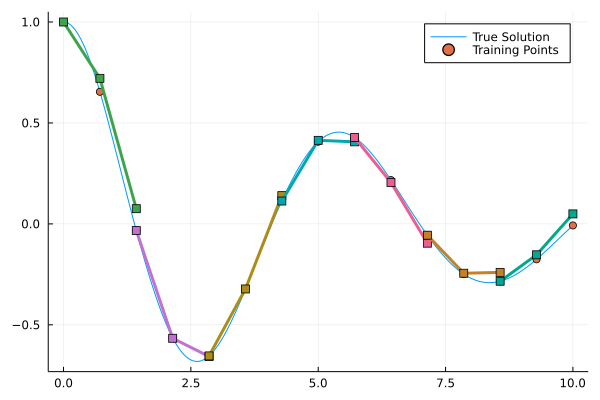

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


88.2723412136053

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


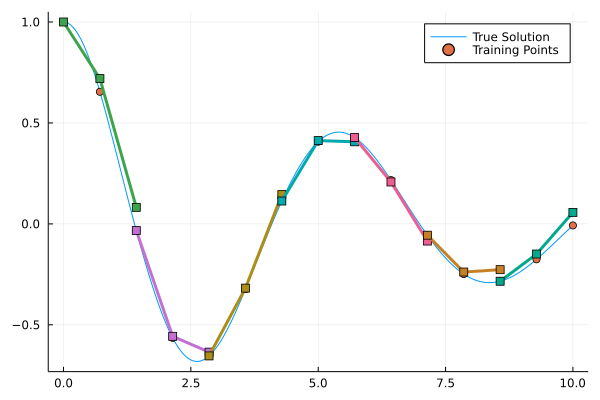

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


84.90251314152727

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


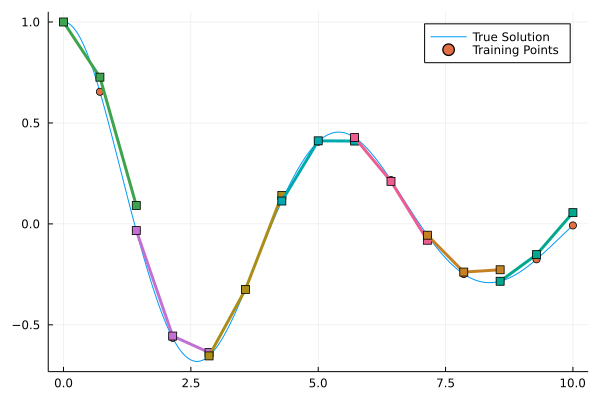

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.02993785842273

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


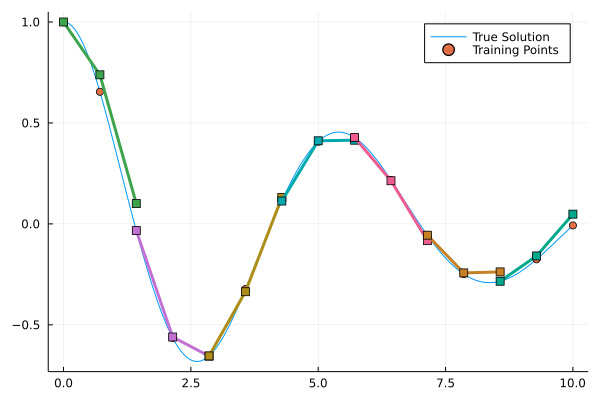

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


81.26056306580436

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


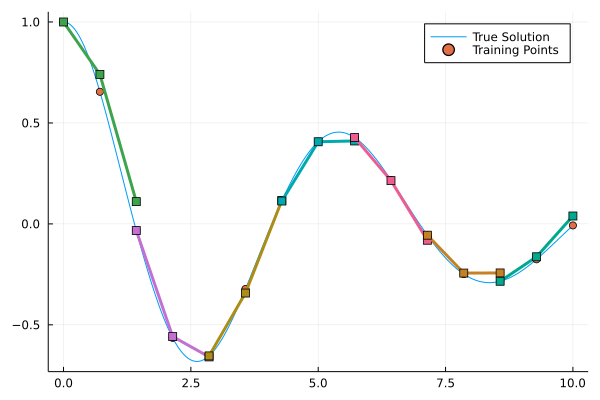

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


84.09876631422571

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


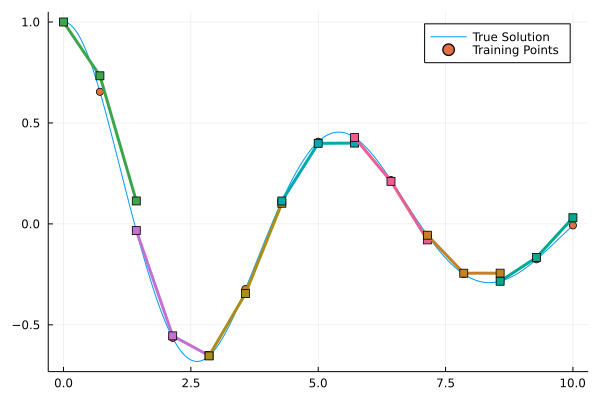

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


86.12820851795817

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


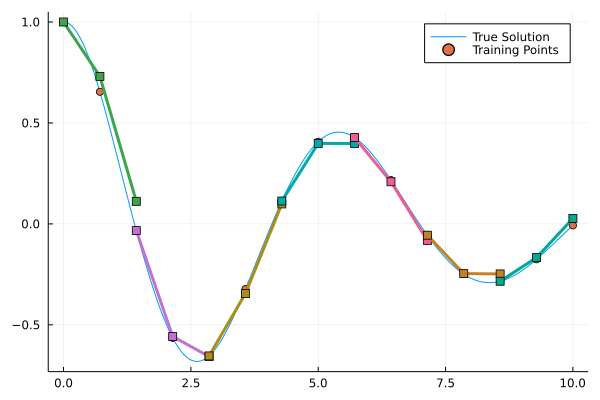

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.23796497320357

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


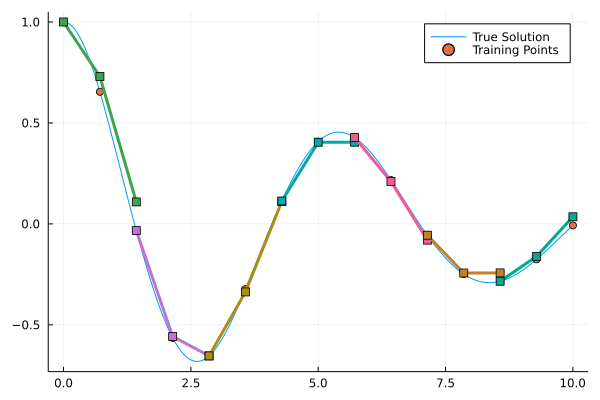

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


85.7666240282151

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


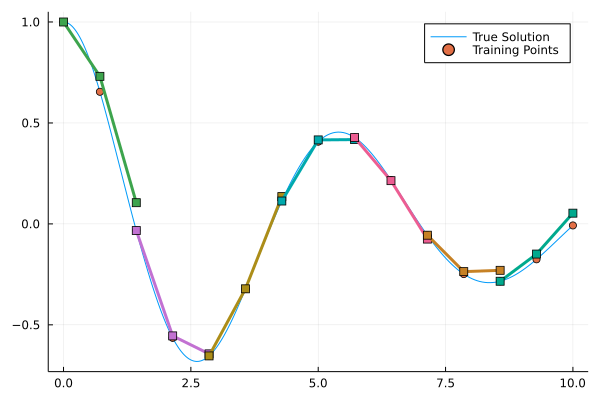

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


83.90472691463253

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


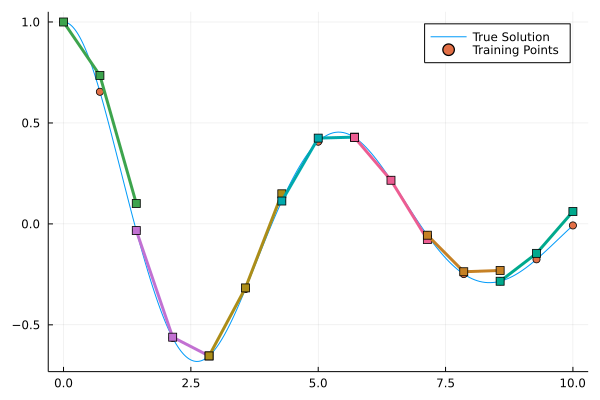

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.0926706789531

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


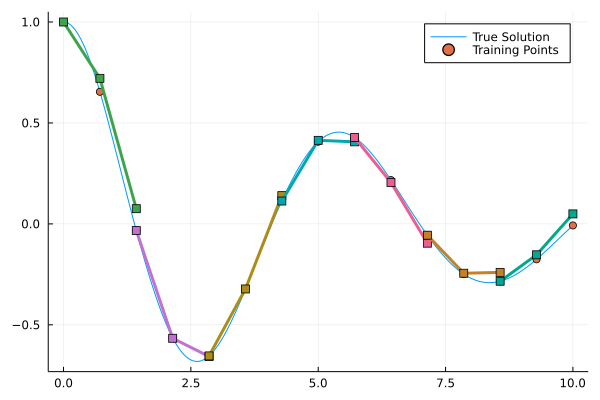

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


80.0926706789531

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


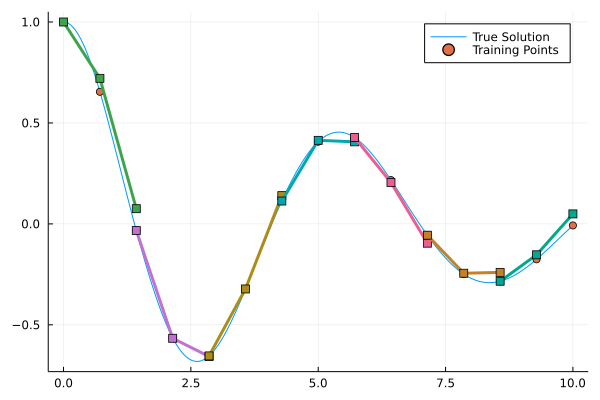

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


79.22146499431678

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


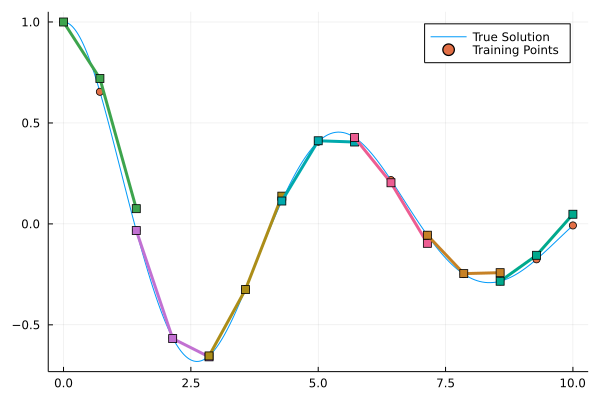

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


77.96149407015976

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


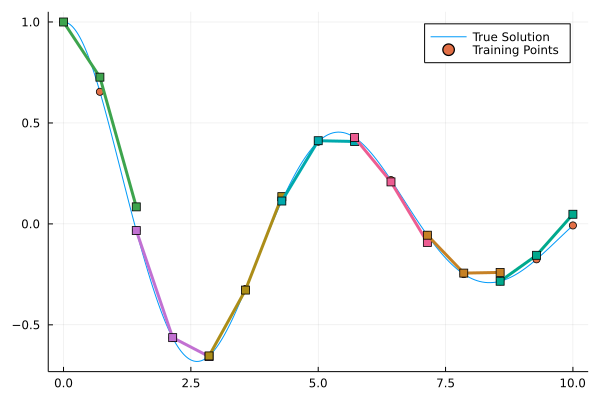

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


77.67407607475116

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


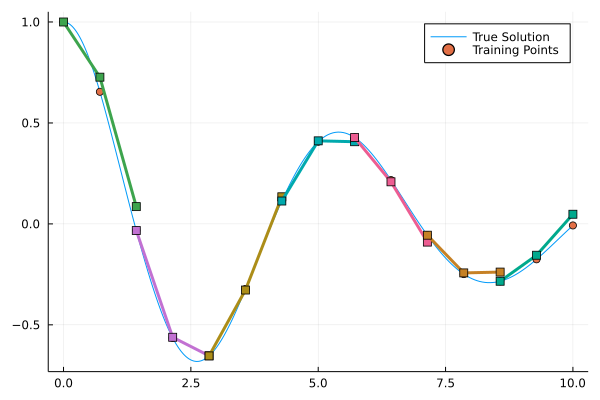

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


76.19781047264024

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


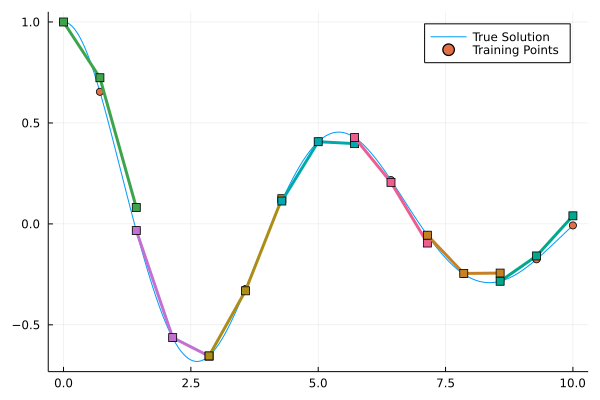

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


76.1953077893618

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


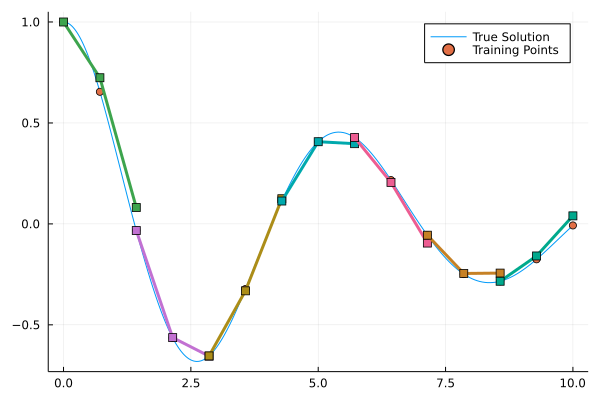

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


75.2667236446937

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


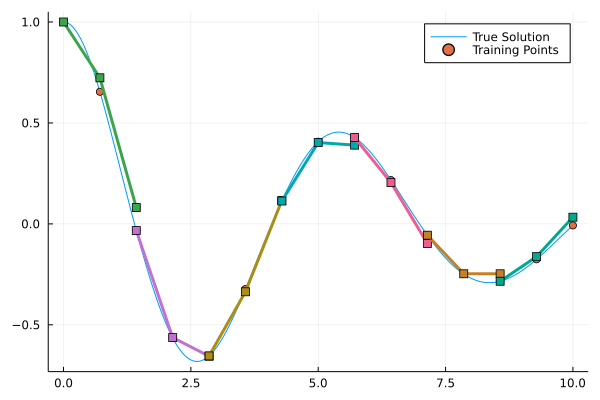

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


75.06955841458273

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


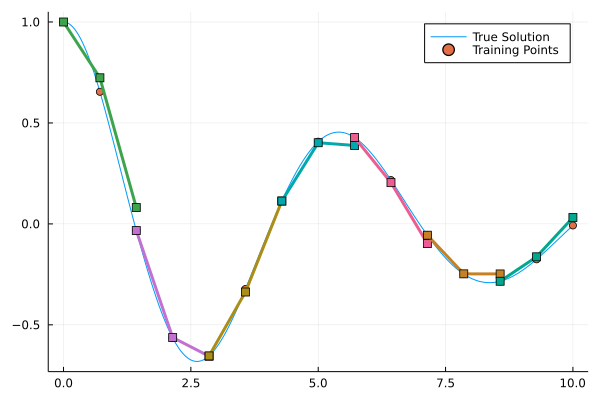

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.91758297184555

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


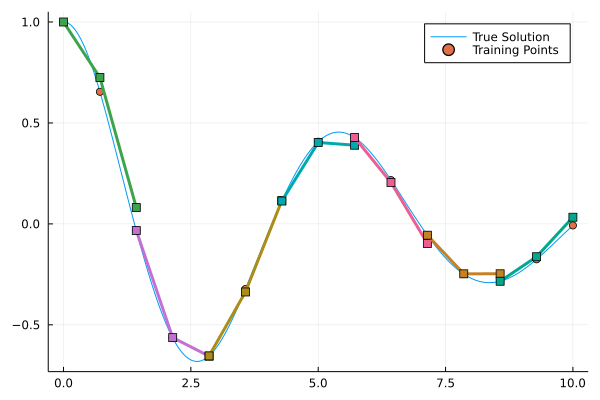

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.905971223133

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


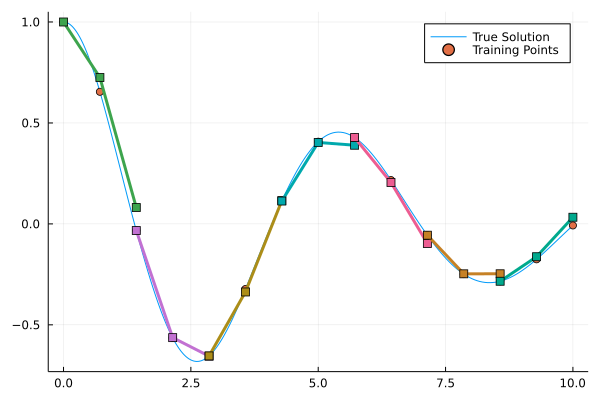

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.7518775753894

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


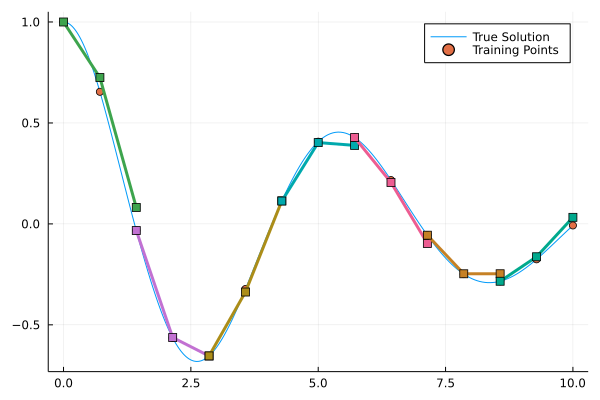

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.6957798096008

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


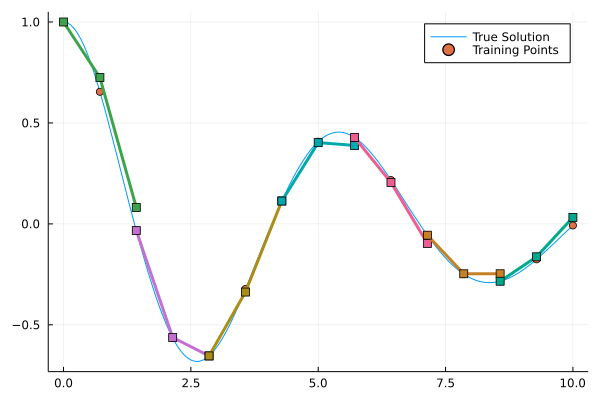

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.68976997702597

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


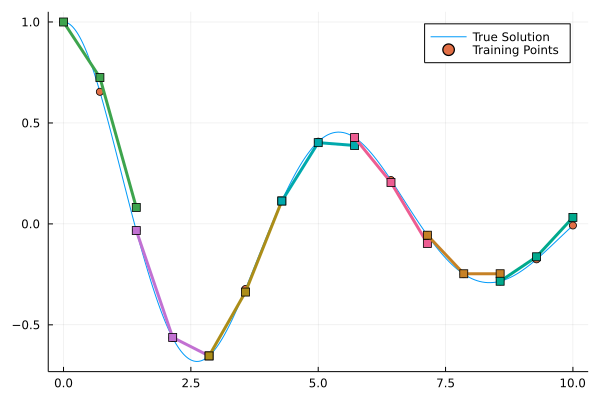

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.640929250681

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


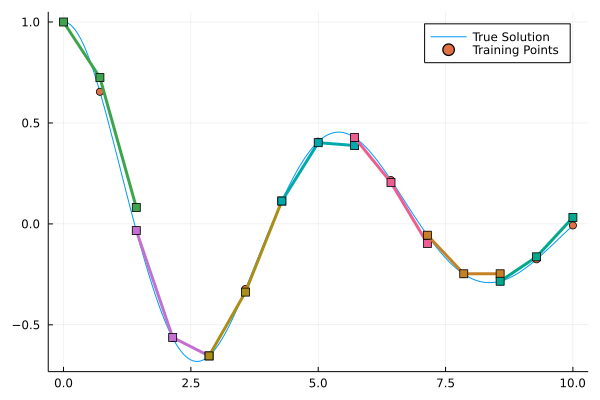

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.63716450474593

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


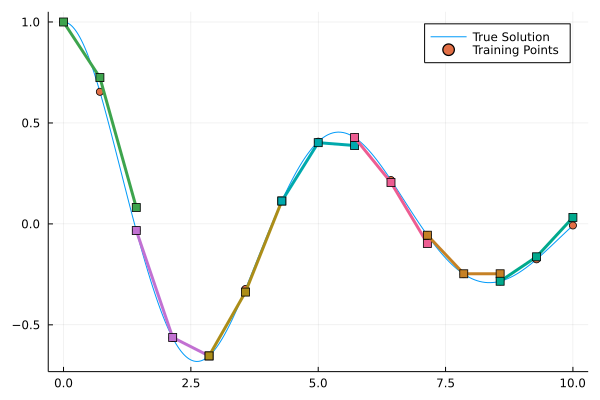

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.52675281387707

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


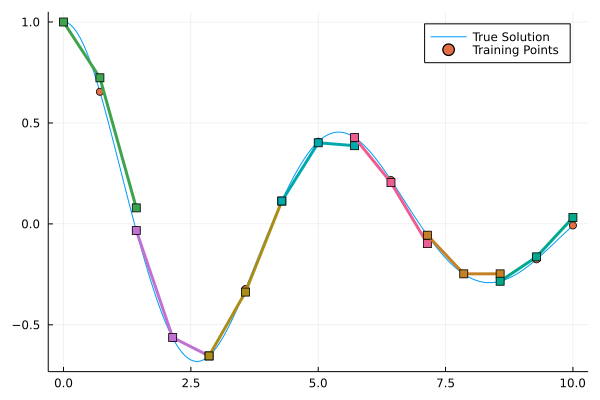

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


74.35616271493282

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


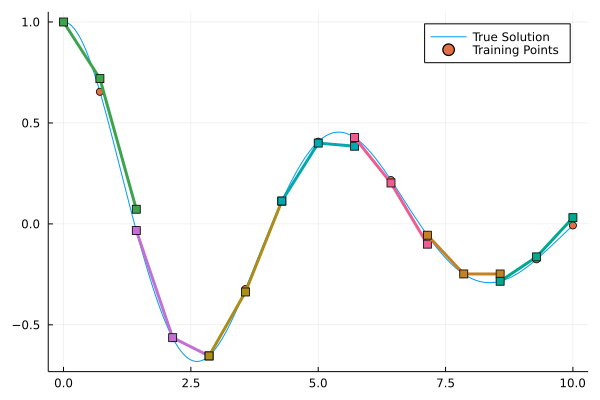

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


73.10742095640485

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


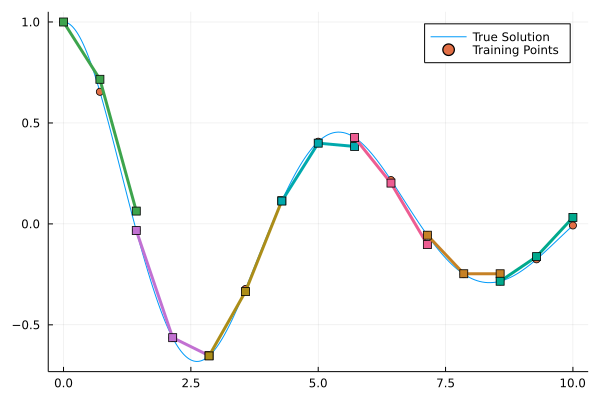

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


72.09561164394032

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


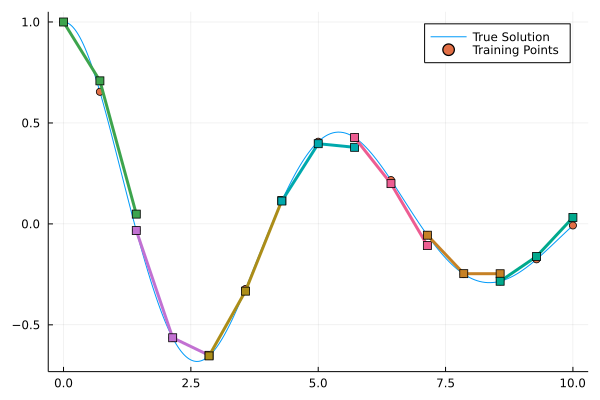

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


71.26618244609409

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


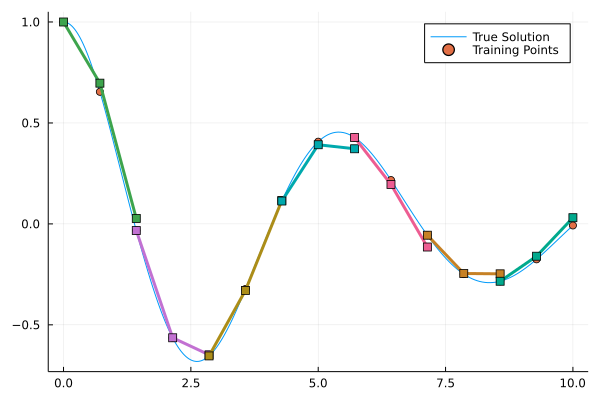

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


68.64856371009652

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


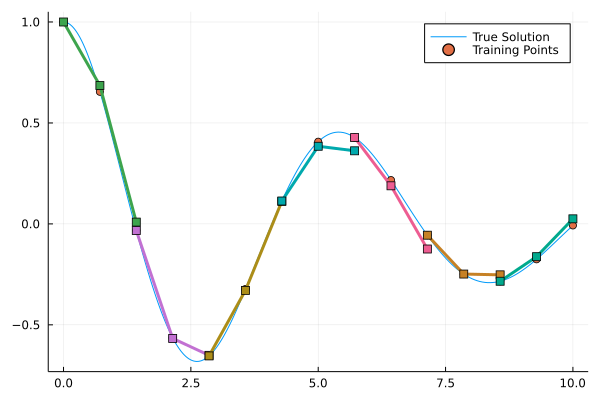

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


67.92242406084641

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


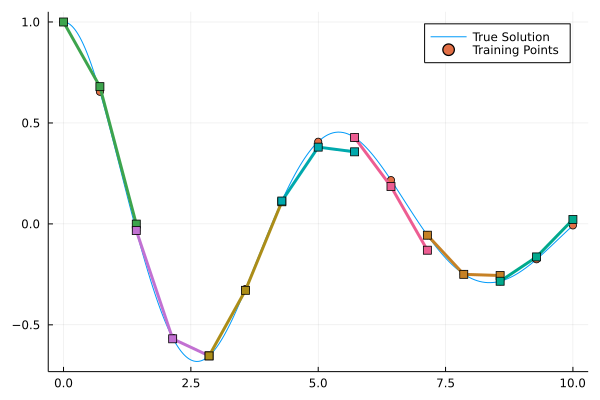

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


67.87663689605209

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


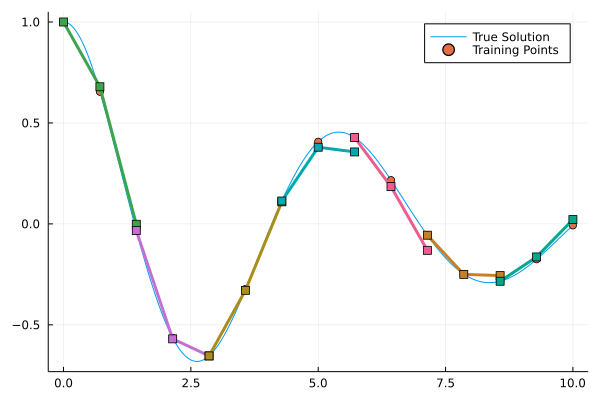

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


67.8724243450427

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


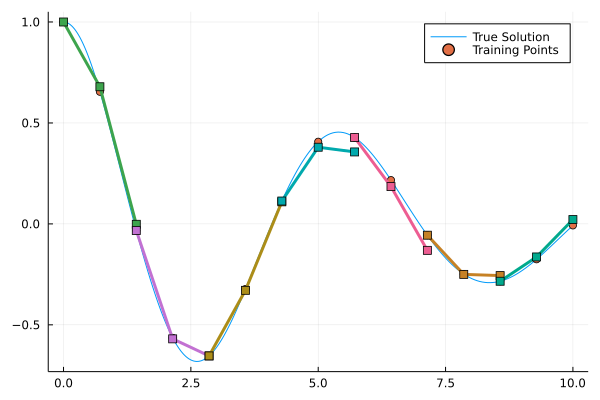

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


66.15972070267723

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


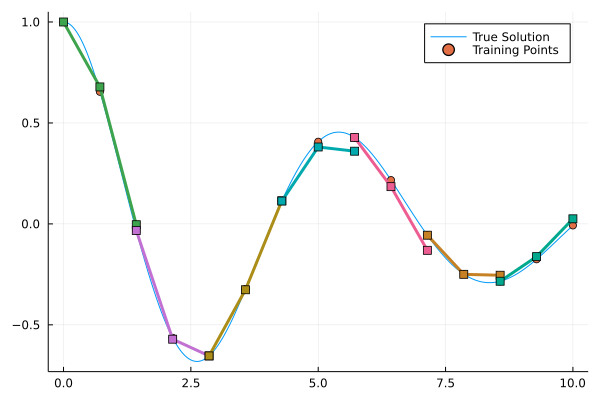

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


65.480452381328

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


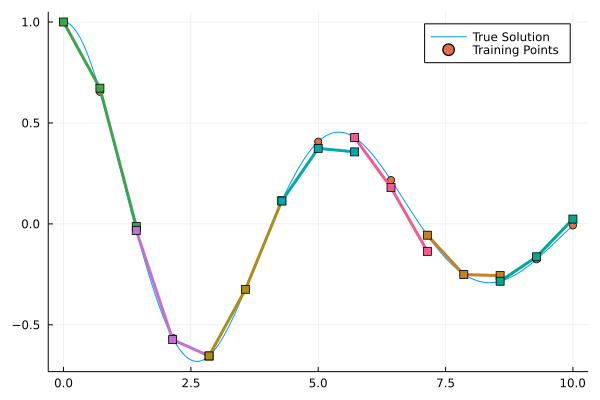

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


65.35778665412958

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


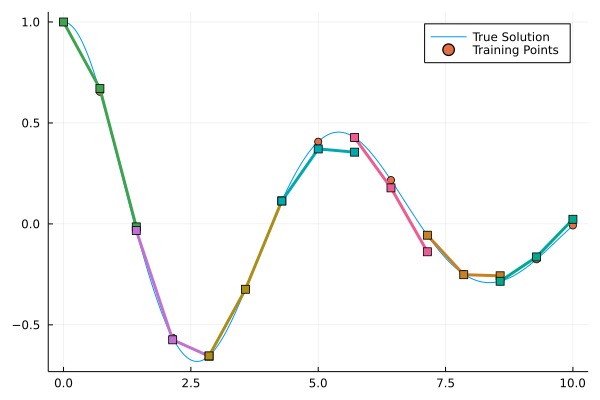

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


65.31304662150666

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


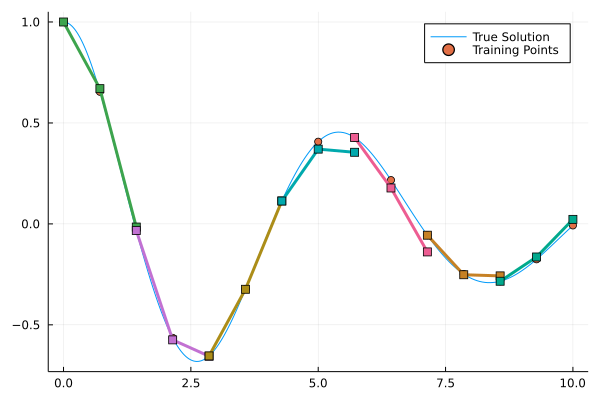

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


65.2783258953789

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


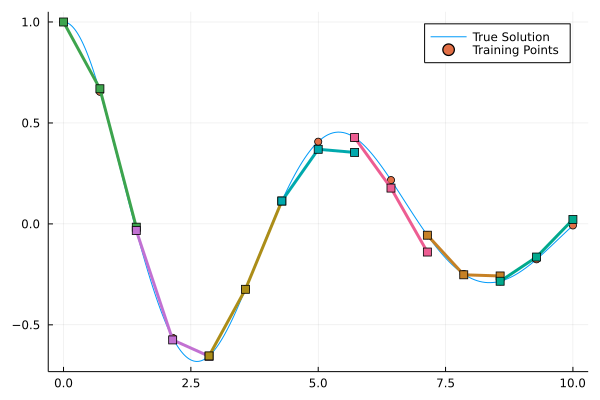

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


65.10172311784389

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


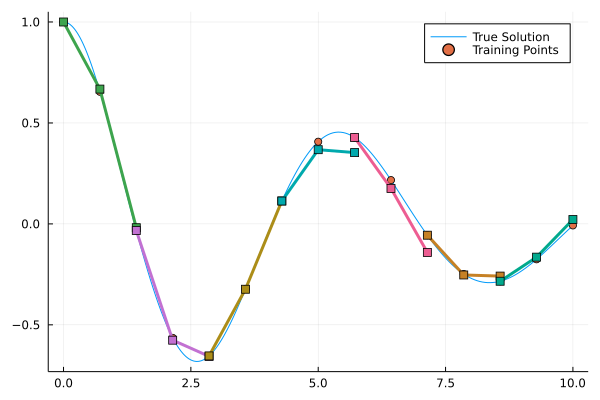

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


64.95441599329475

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


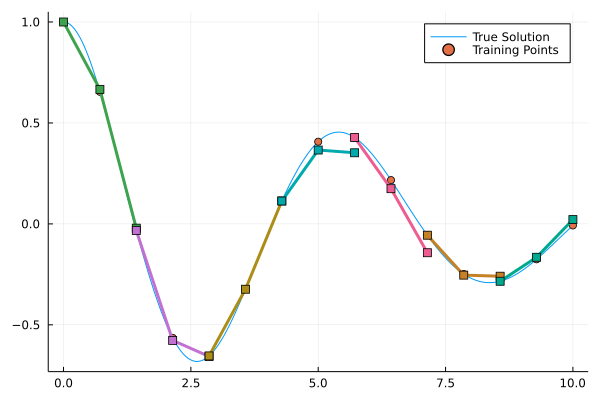

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


64.35143089014244

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


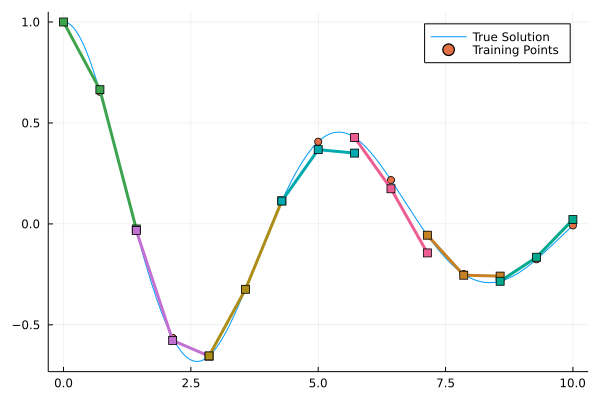

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


64.32130372985881

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


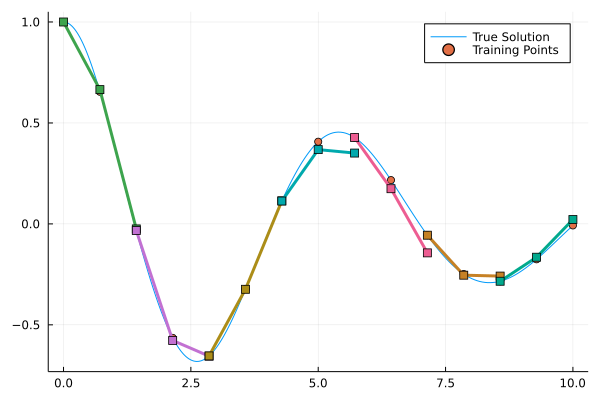

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


63.930919319815516

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


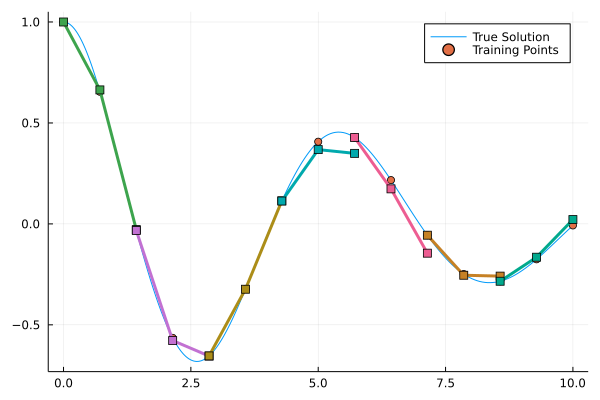

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


63.91043566563208

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


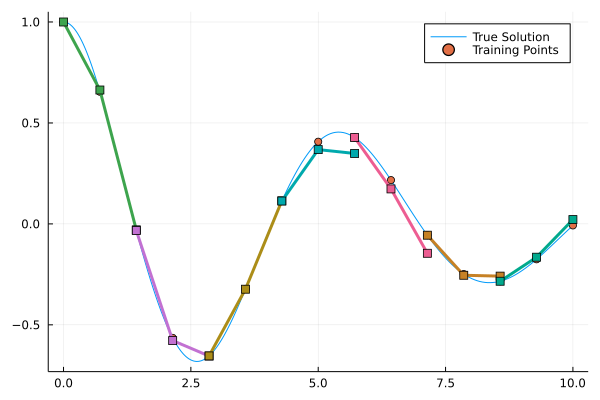

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


63.63523522020979

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


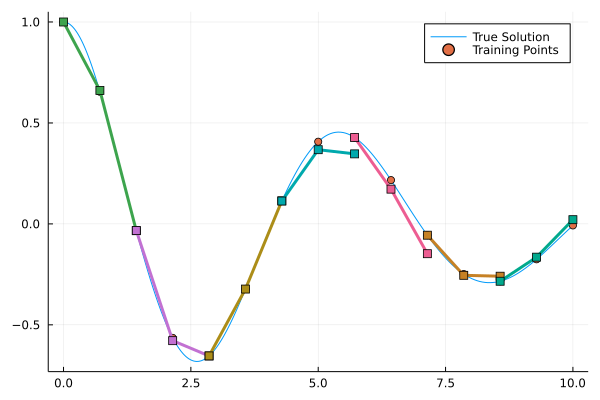

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


61.96650043211706

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


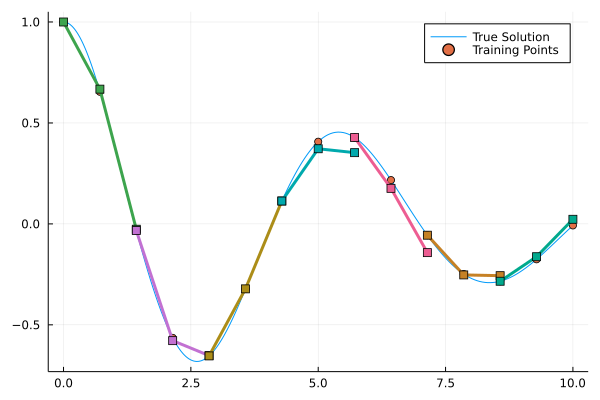

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


60.92627458334749

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


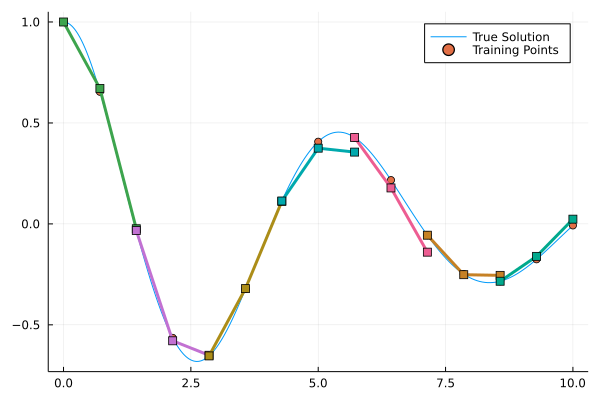

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


60.55090278322659

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


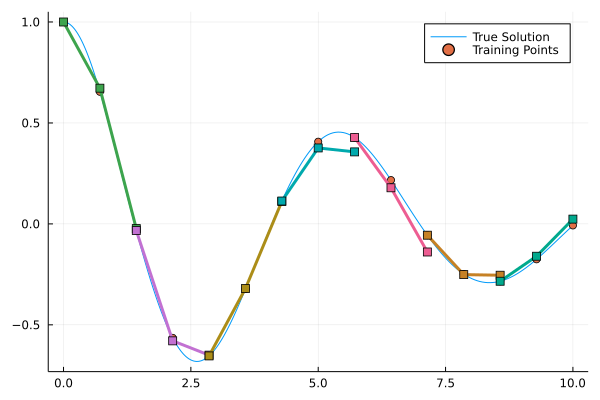

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


60.44675418345272

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


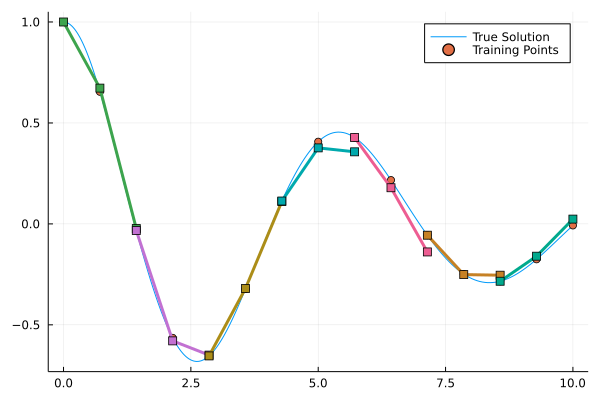

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


58.68305256549686

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


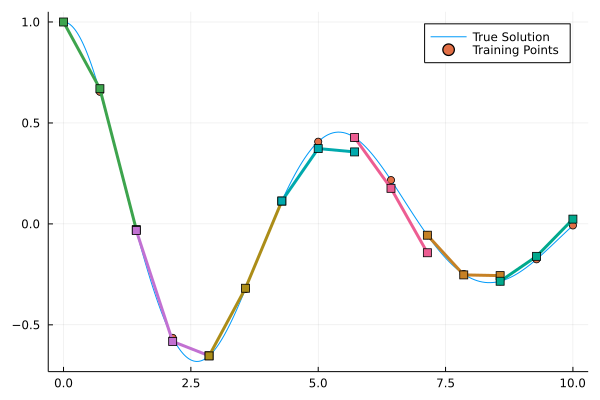

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


58.157345799972134

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


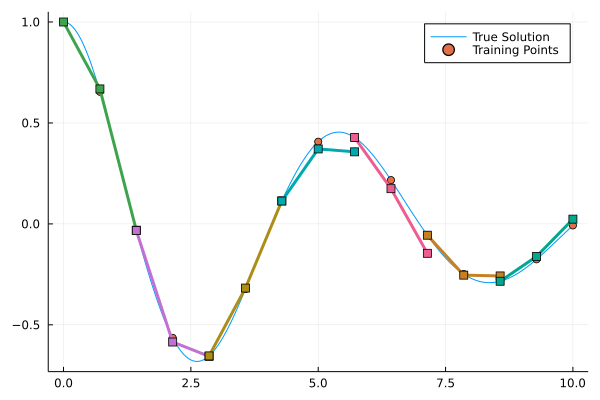

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


57.89058002727103

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


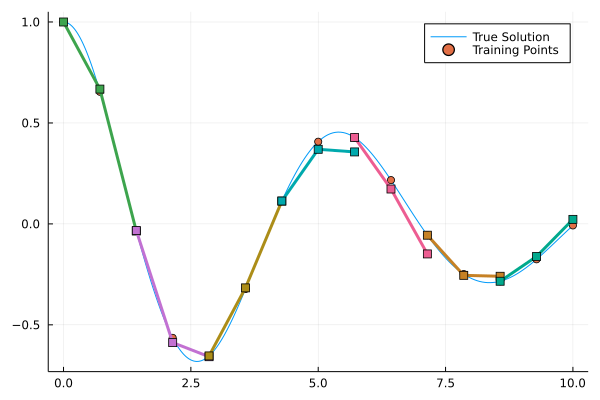

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


55.379426881786

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


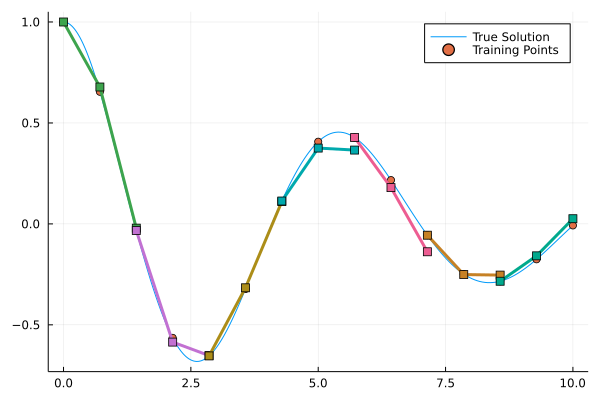

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


51.886809561621895

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


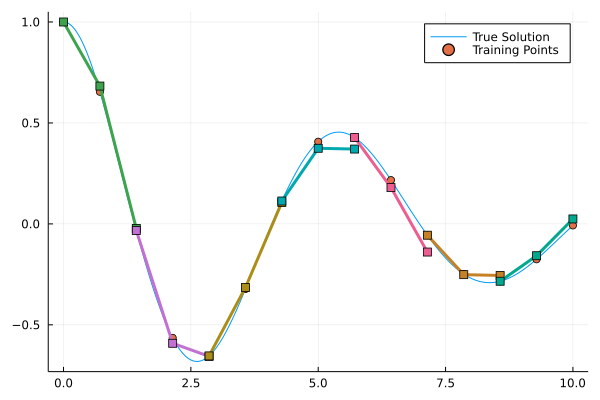

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


51.75800655303064

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


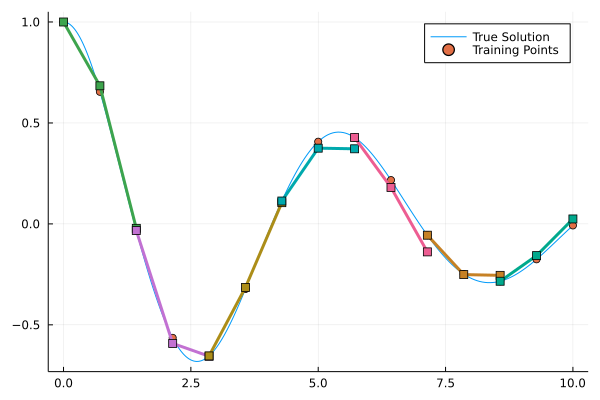

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


49.48693424162015

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


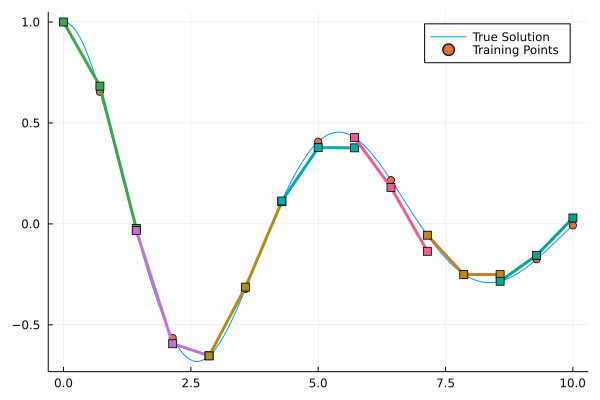

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


49.4749806777365

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


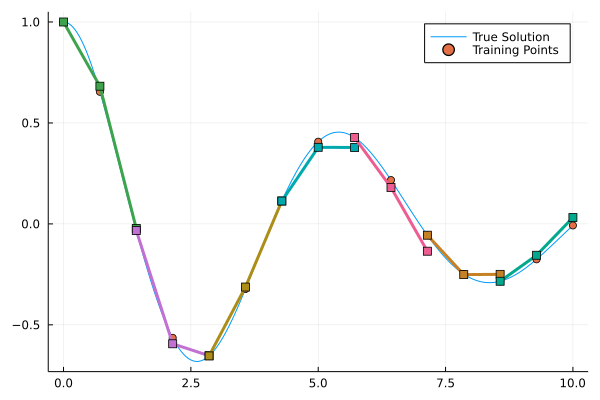

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


47.9014446569919

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


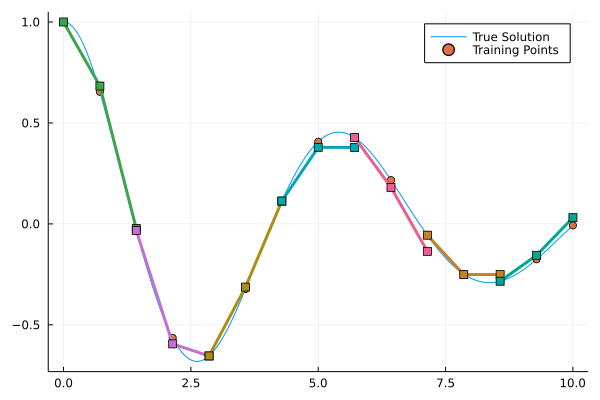

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


47.001433906538

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


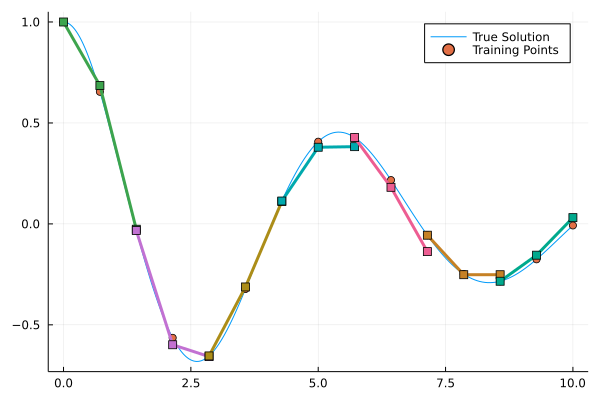

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


46.23011619044395

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


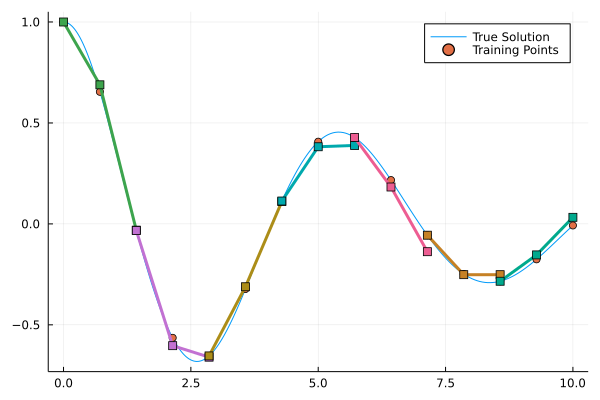

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


43.81348168363266

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


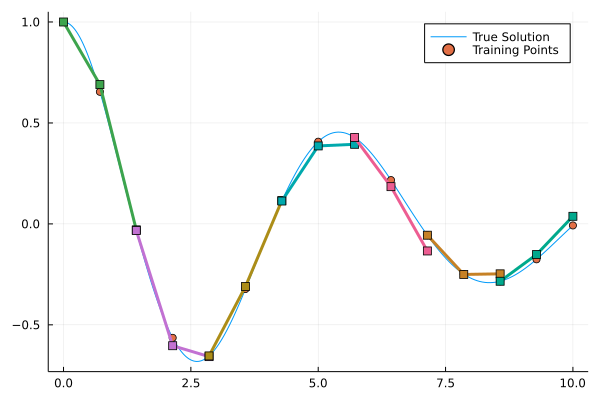

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


43.742936489436765

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


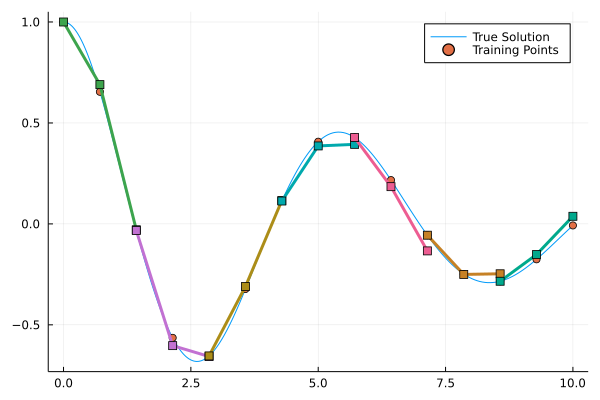

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


42.49036170709698

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


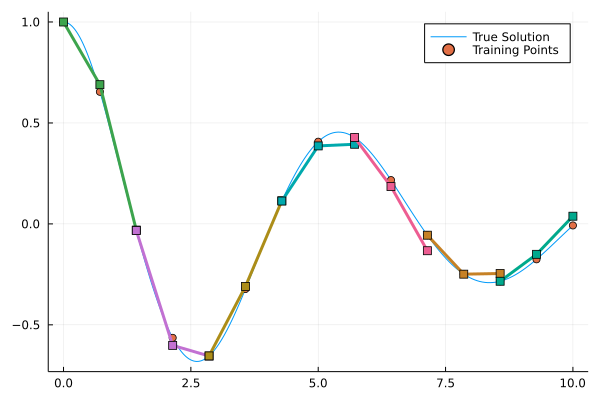

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


42.27255890047195

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


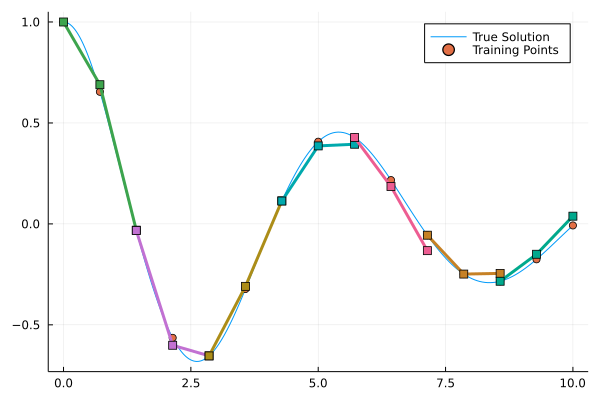

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


41.93727030850927

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


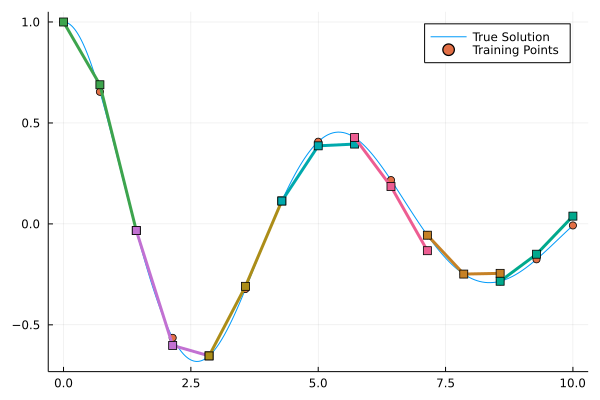

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


41.562517577995884

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


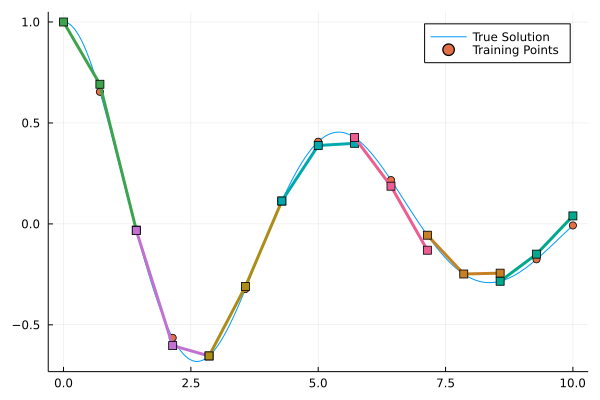

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


41.54965034801158

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


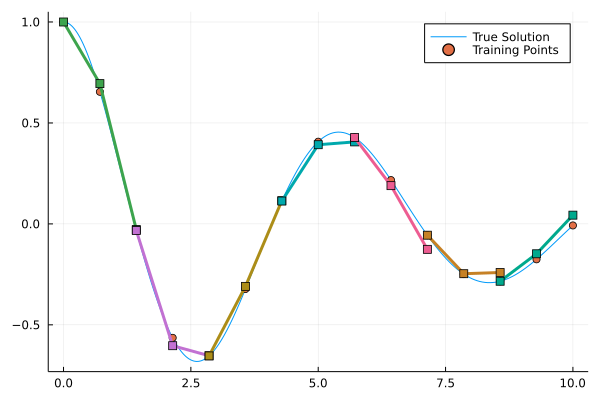

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


38.12901187020056

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


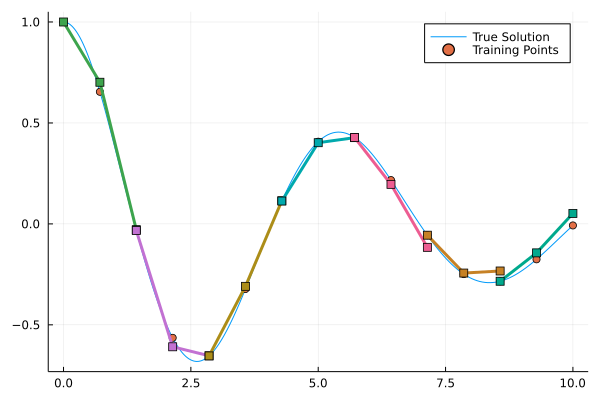

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


38.097105486889745

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


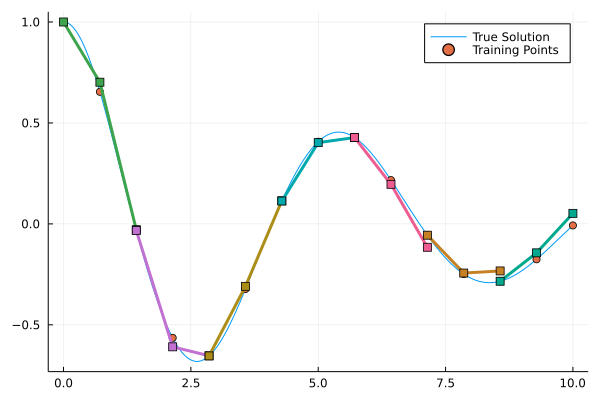

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


37.112477464909404

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


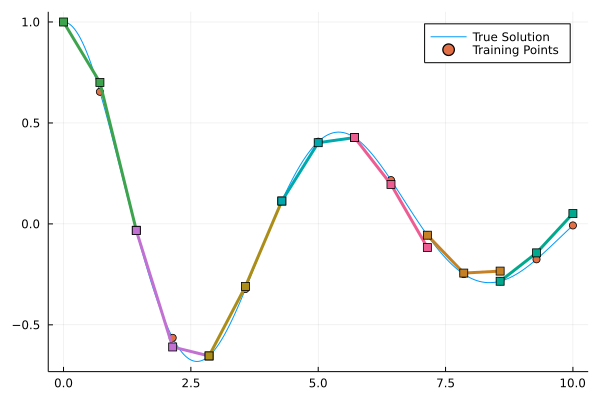

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


36.79857473643439

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


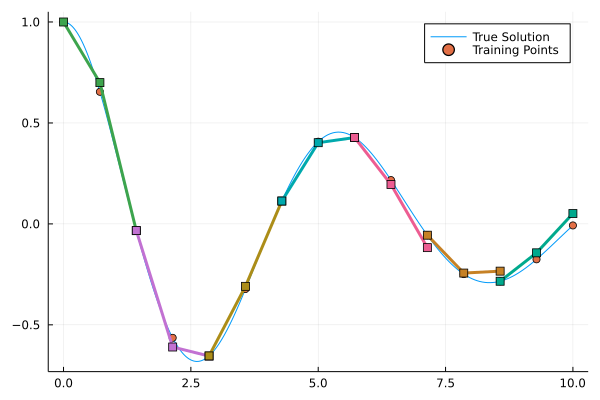

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


36.44505117627399

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


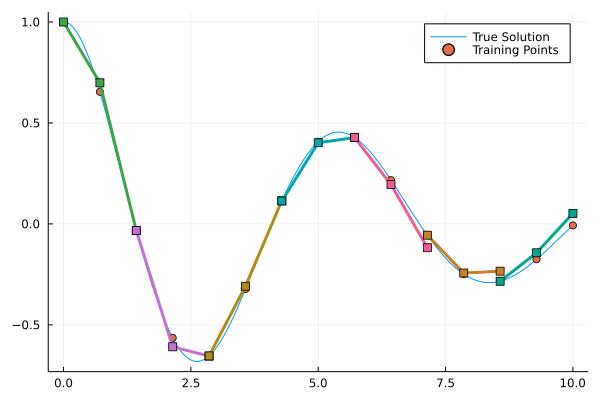

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


36.2293843526446

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


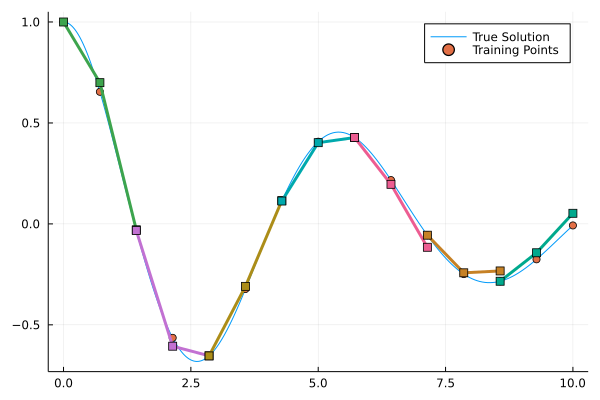

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


35.90064580901682

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


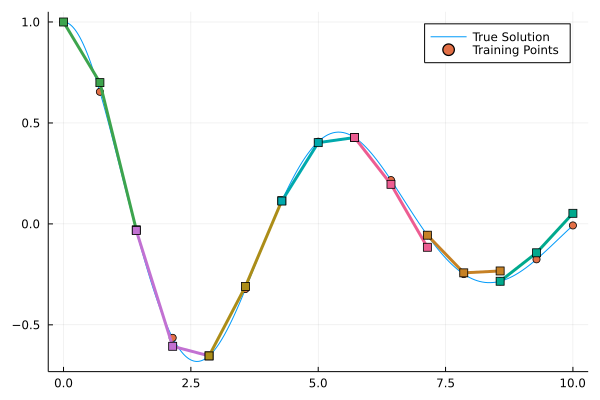

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


35.65562411715341

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


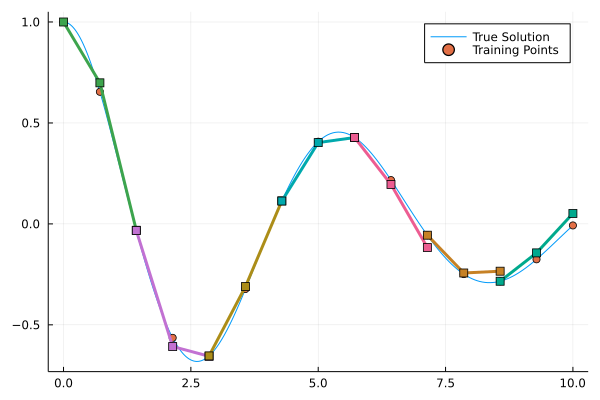

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


35.38298171471849

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


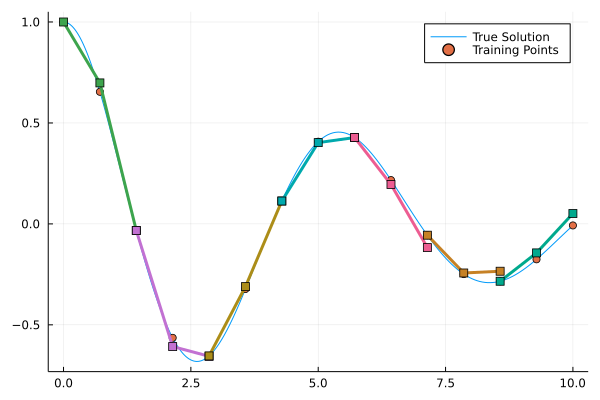

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


35.334795800334774

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


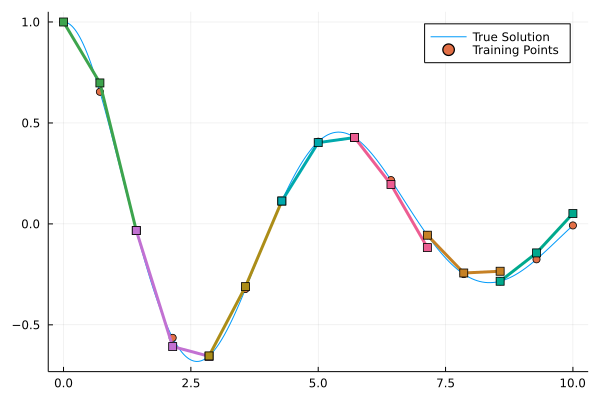

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


35.330573239544975

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


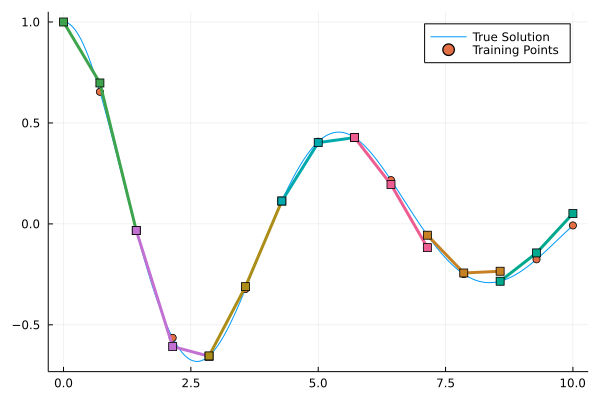

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


34.991801271607365

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


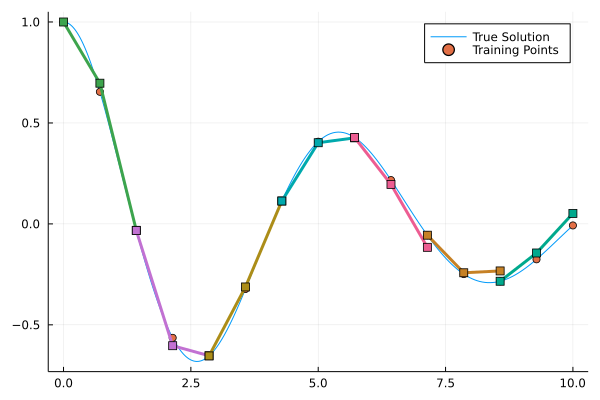

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


34.46179949558331

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


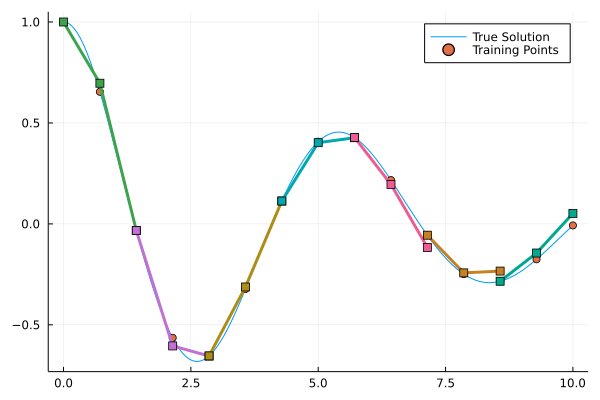

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


33.87014596957417

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


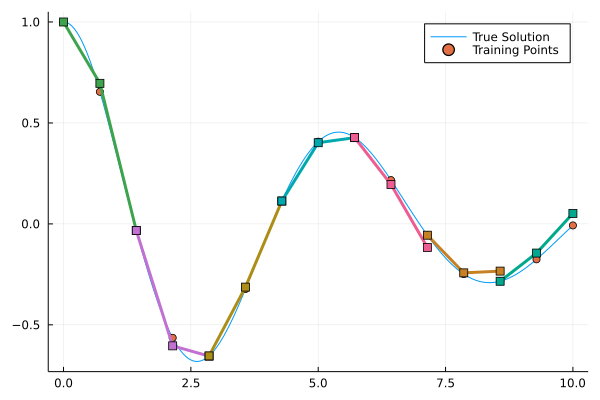

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


33.583534384506855

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


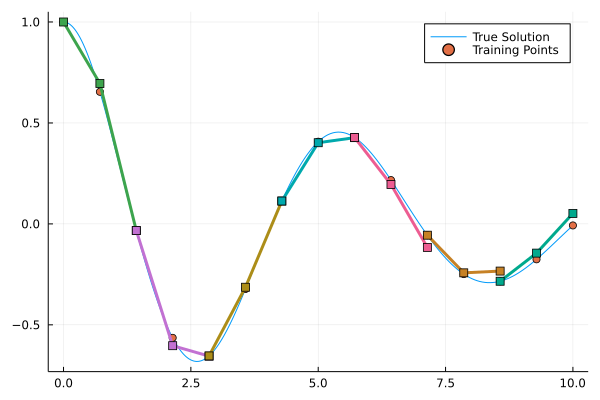

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


33.15150023939523

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


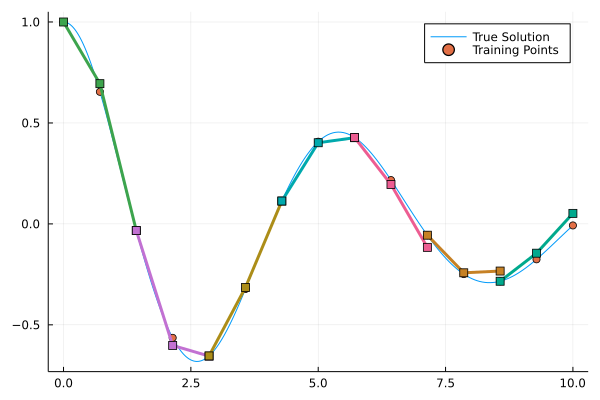

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


33.12899022171142

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


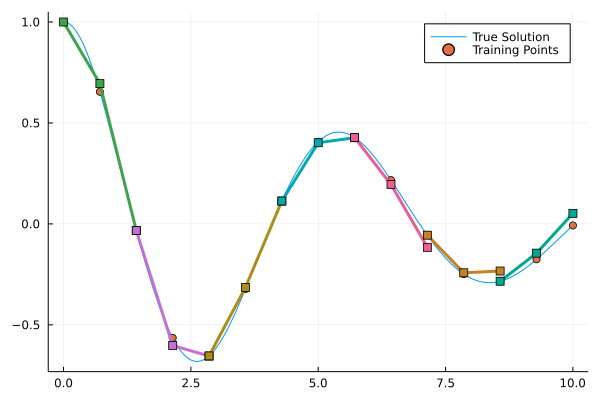

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


33.01081602773779

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


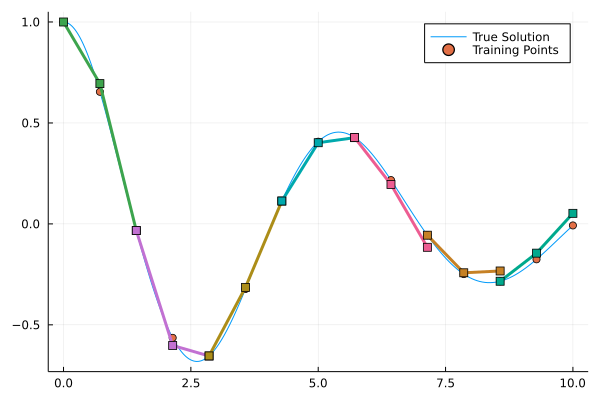

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.799533073069114

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


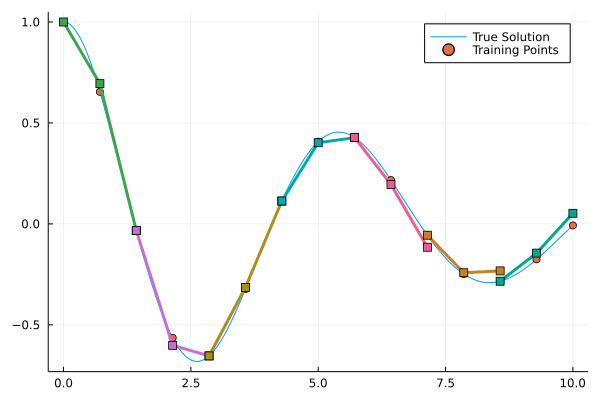

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.71979723811398

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


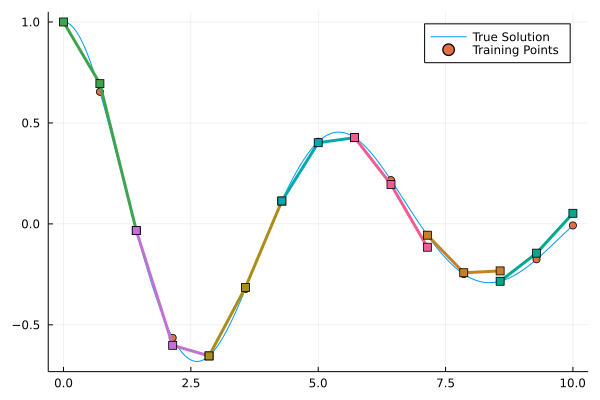

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.70831551135363

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


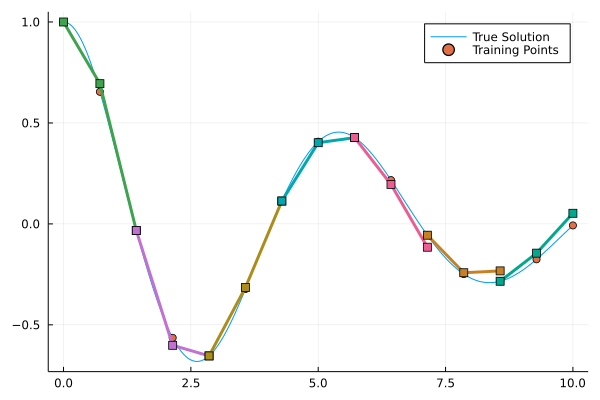

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.65492957771707

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


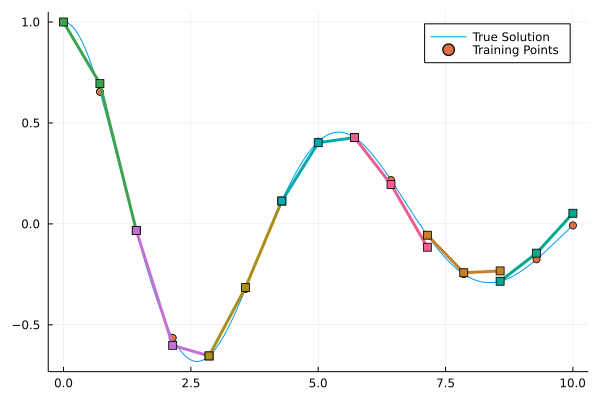

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.54194238576662

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


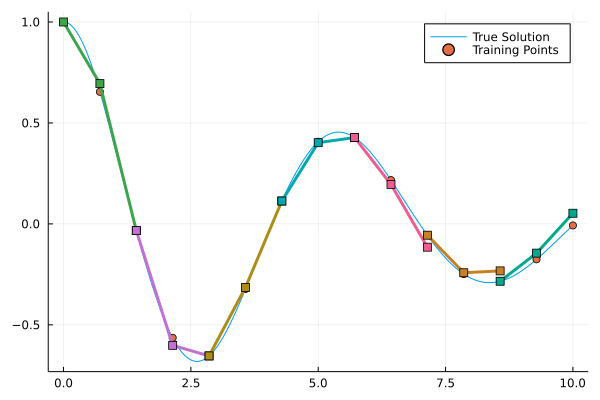

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.522599570846026

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


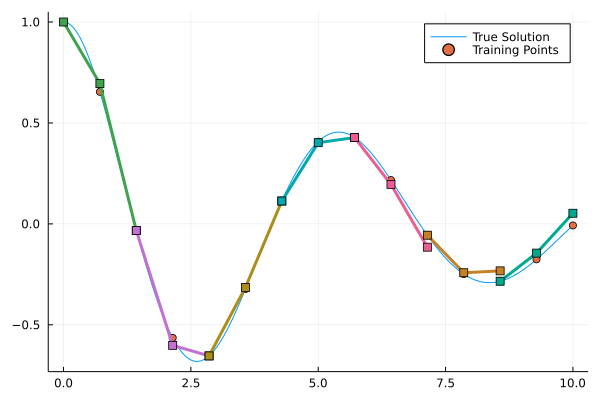

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.519950981301875

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


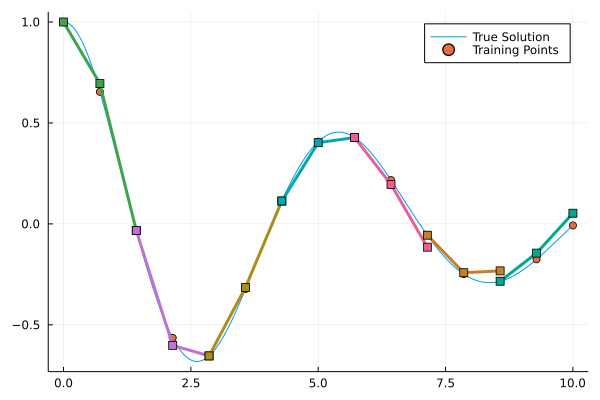

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.51649585681233

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


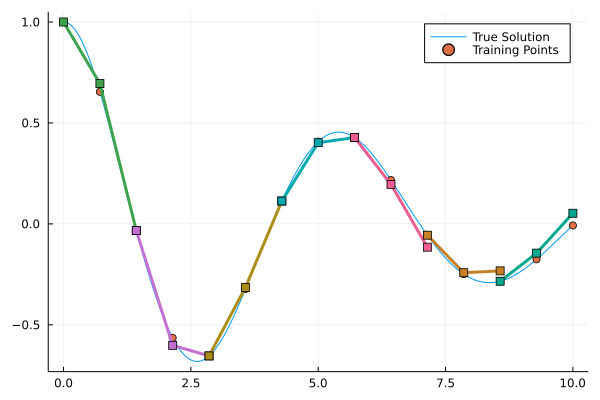

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.513826400671846

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


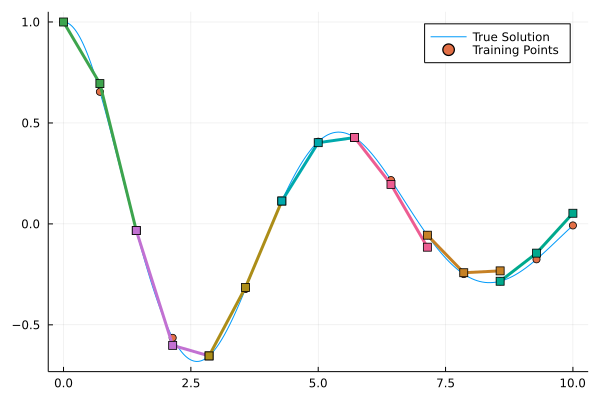

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.48910363713763

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


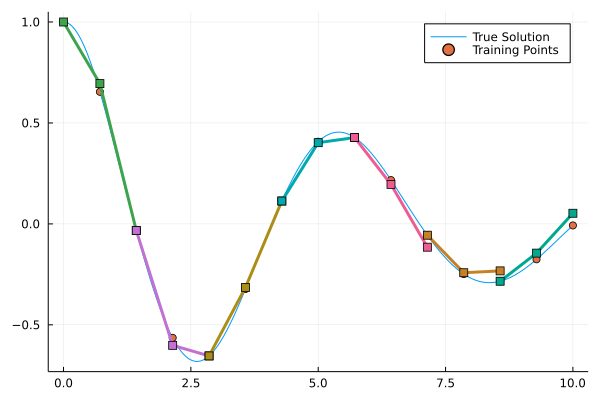

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.48586529994321

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


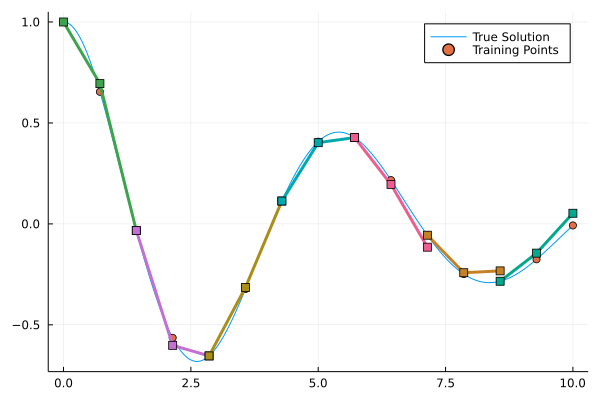

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.479770949471046

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


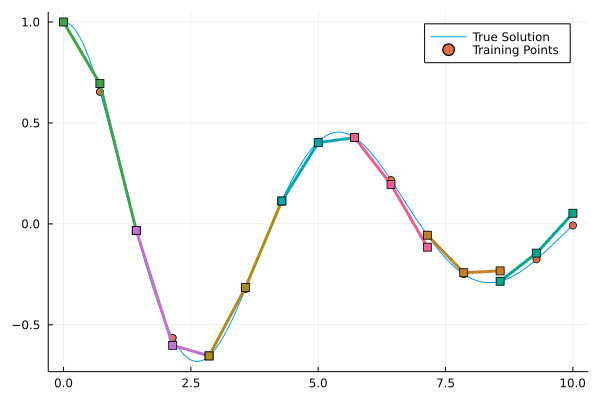

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.477419352253854

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


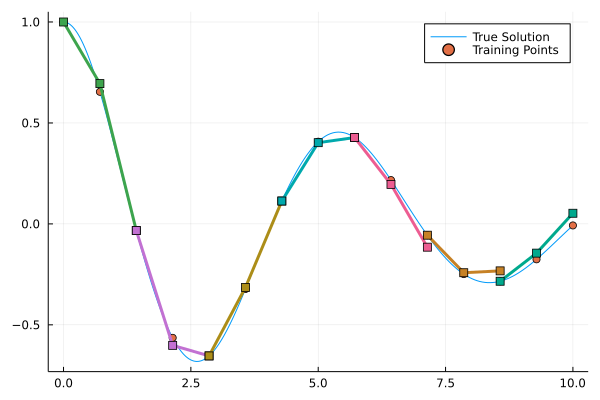

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.475995723155954

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


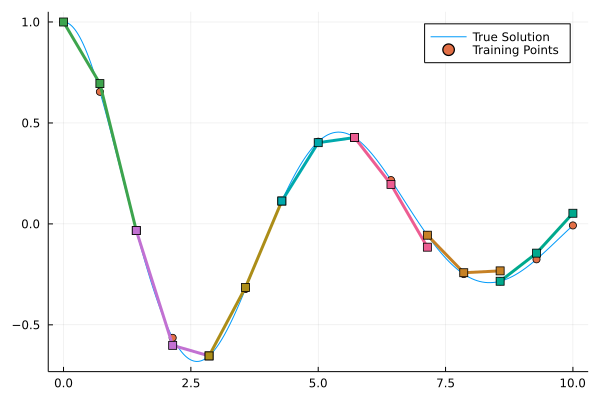

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.46859746729791

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


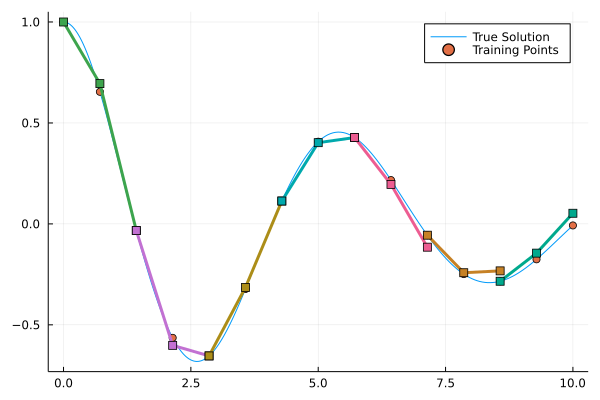

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.463984649885866

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


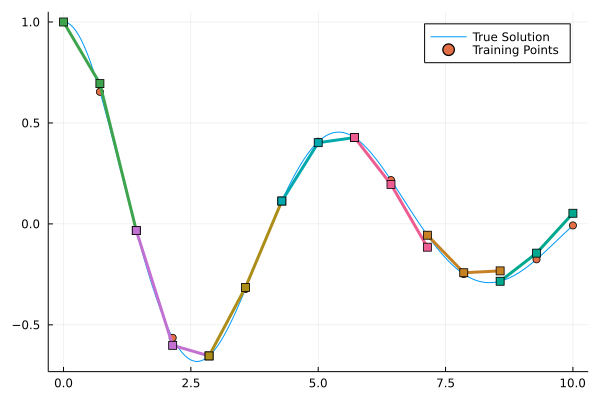

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.46068955954002

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


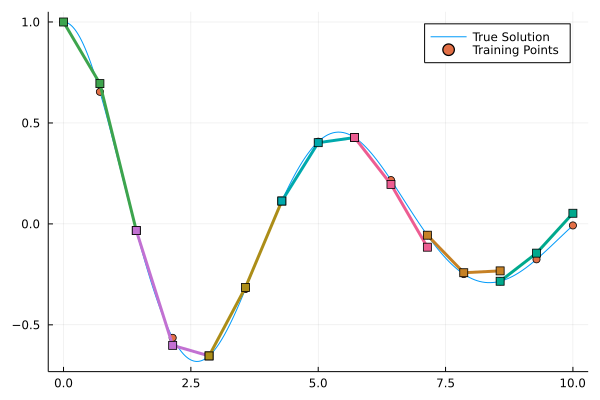

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.45904915225704

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


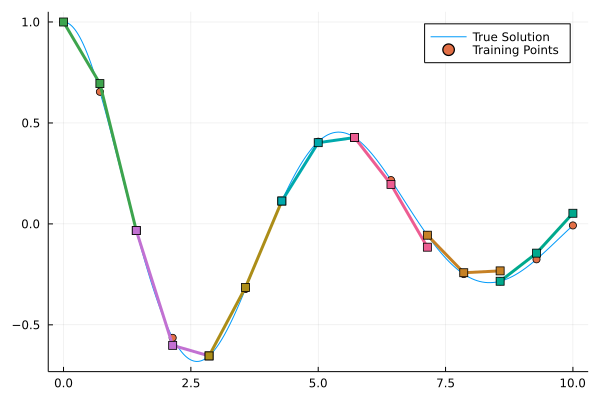

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.45136388092678

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


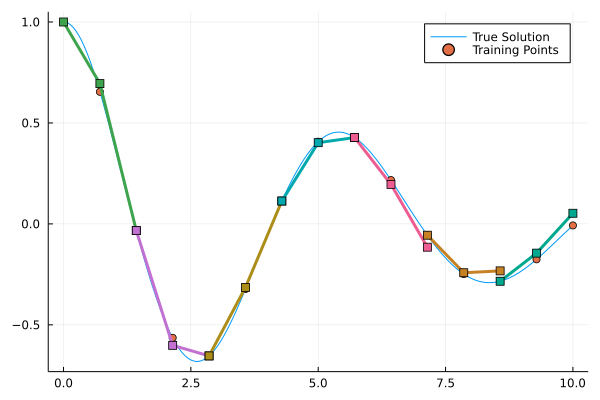

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.450467001629505

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


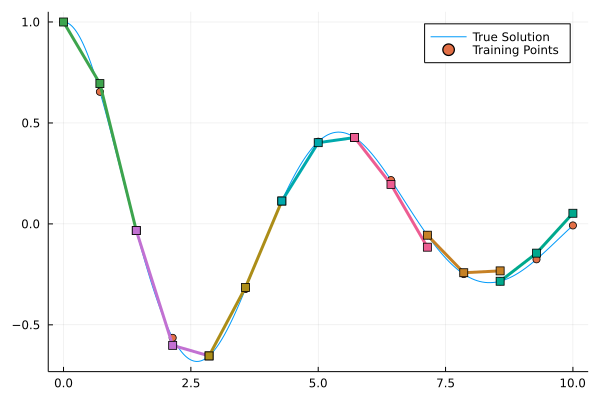

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.445720522207445

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


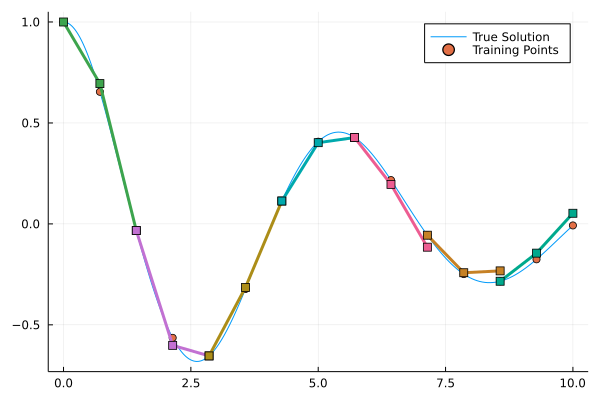

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.44526136485081

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


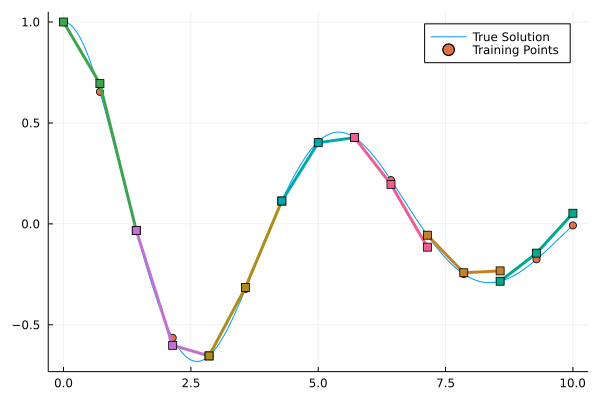

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.43441625125153

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


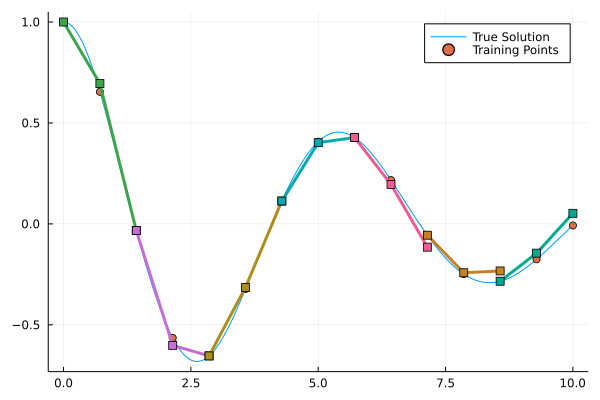

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.403657743578435

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


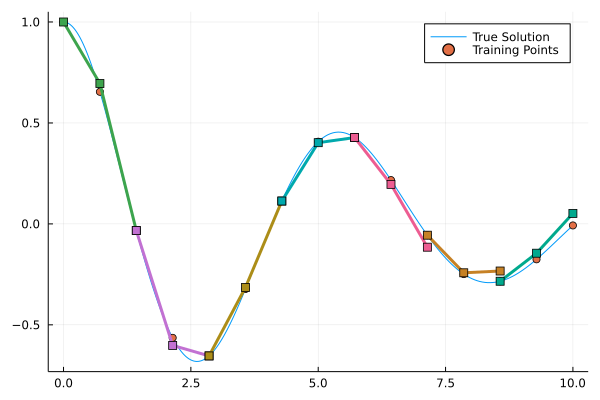

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


32.39457854037839

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


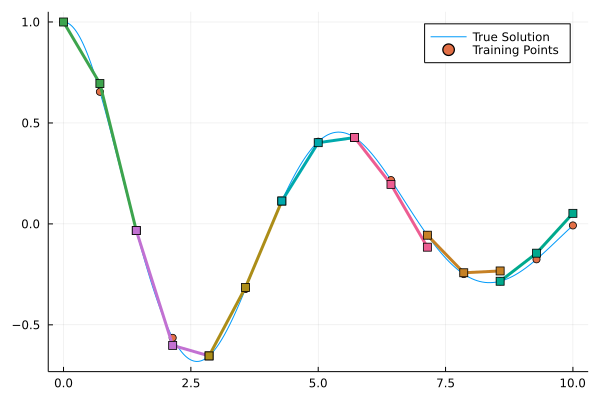

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


u: ComponentVector{Float32}(layer_1 = (weight = Float32[0.26111904 0.3757393; -0.008524864 0.29834425; … ; 0.020301573 -0.27960956; 0.2444923 0.019548621], bias = Float32[0.27763453; 0.10398897; … ; 0.15687586; 0.17835003;;]), layer_2 = (weight = Float32[0.40347907 0.23201239 … -0.19987203 -0.26101792; -0.3310214 0.01764796 … 0.1849167 -0.39732224], bias = Float32[-0.6064685; -0.26812163;;]))

In [5]:
using Lux
using Random
rng = Random.default_rng()
using DiffEqFlux: group_ranges

nn = Lux.Chain(
                  Lux.Dense(2, 32, tanh),
                  Lux.Dense(32, 2))
p_init, st = Lux.setup(rng, nn)
tsteps = t_15
neuralode = NeuralODE(nn, (0,12), Tsit5(), saveat = 0.01)
prob_node = ODEProblem((u,p,t)->nn(u,p,st)[1], initial_1, (0,12), Lux.ComponentArray(p_init))

function plot_multiple_shoot(plt, preds, group_size)
    step = group_size-1
    ranges = group_ranges(15, group_size)

    for (i, rg) in enumerate(ranges)
        plot!(plt, t_15[rg], preds[i][1,:], markershape=:rect,label = "",width = 3)
    end
end




anim = Plots.Animation()
iter = 0
callback = function (p, l, preds; doplot = true)
  display(l)
  global iter
  iter += 1
  if doplot && iter%1 == 0
    # plot the original data
    plt = plot(t_true,Array(sol_Duffing_true)[1,:],label = "True Solution")
    global plt
    scatter!(plt,t_15, sol_Duffing_15[1,:], label = "Training Points")

    # plot the different predictions for individual shoot
    plot_multiple_shoot(plt, preds, group_size)

    frame(anim)
    display(plot(plt))
  end
  return false
end

group_size = 3
continuity_term = 200

function loss_function(data, pred)
    return sum(abs2, data - pred)
end

function loss_multiple_shooting(p)
    return multiple_shoot(p, sol_Duffing_15, t_15, prob_node, loss_function, Tsit5(),
                          group_size; continuity_term)
end

adtype = Optimization.AutoZygote()
optf = Optimization.OptimizationFunction((x,p) -> loss_multiple_shooting(x), adtype)
optprob = Optimization.OptimizationProblem(optf, Lux.ComponentArray(p_init))
res_ms = Optimization.solve(optprob, PolyOpt(),
                                callback = callback,maxiters = 100)


In [6]:
sum((Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.006206258783124699

In [7]:
sum(abs.(Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]))/200

0.0689748502505866

In [ ]:
using Lux
using Random
rng = Random.default_rng()
using DiffEqFlux: group_ranges

nn = Lux.Chain(
                  Lux.Dense(2, 32, tanh),
                  Lux.Dense(32, 2))
p_init, st = Lux.setup(rng, nn)
tsteps = t_30
neuralode = NeuralODE(nn, (0,12), Tsit5(), saveat = 0.01)
prob_node = ODEProblem((u,p,t)->nn(u,p,st)[1], initial_1, (0,12), Lux.ComponentArray(p_init))

function plot_multiple_shoot(plt, preds, group_size)
    step = group_size-1
    ranges = group_ranges(30, group_size)

    for (i, rg) in enumerate(ranges)
        plot!(plt2, t_30[rg], preds[i][1,:], markershape=:rect,label = "",width = 3)
    end
end




anim = Plots.Animation()
iter = 0
callback = function (p, l, preds; doplot = true)
  display(l)
  global iter
  iter += 1
  if doplot && iter%1 == 0
    # plot the original data
    plt2 = plot(t_true,Array(sol_Duffing_true)[1,:],label = "True Solution")
    global plt2
    scatter!(plt2,t_30, sol_Duffing_30[1,:], label = "Training Points")
    xlabel!(plt2,"Time")

    # plot the different predictions for individual shoot
    plot_multiple_shoot(plt2, preds, group_size)

    frame(anim)
    display(plot(plt2))
  end
  return false
end

group_size = 3
continuity_term = 200

function loss_function(data, pred)
    return sum(abs2, data - pred)
end

function loss_multiple_shooting(p)
    return multiple_shoot(p, sol_Duffing_30, t_30, prob_node, loss_function, Tsit5(),
                          group_size; continuity_term)
end

adtype = Optimization.AutoZygote()
optf = Optimization.OptimizationFunction((x,p) -> loss_multiple_shooting(x), adtype)
optprob = Optimization.OptimizationProblem(optf, Lux.ComponentArray(p_init))
res_ms = Optimization.solve(optprob, PolyOpt(),
                                callback = callback,maxiters = 100)


In [9]:
sum((Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.0025481874715110675

In [10]:
sum(abs.(Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]))/200

0.04209306770894261

2256.185371394644

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


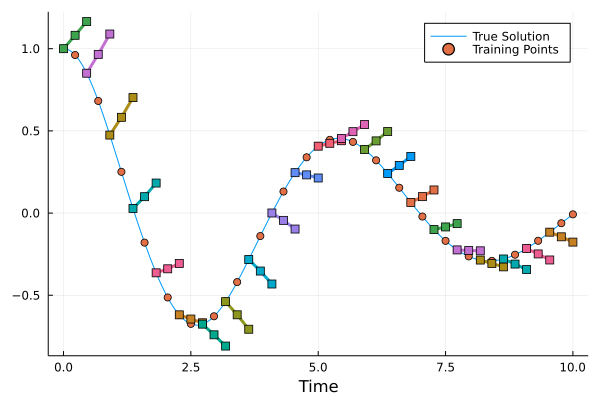

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


2014.8606320777667

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


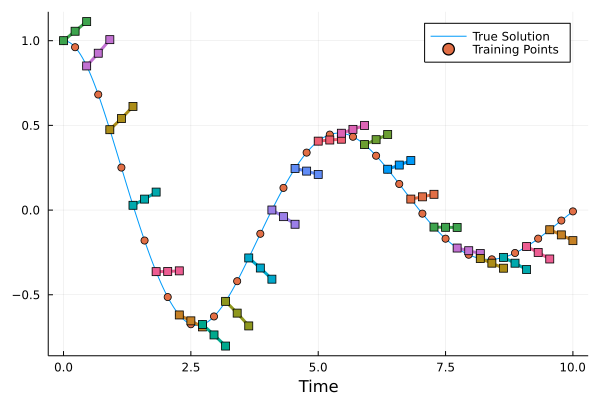

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1807.3513111465927

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


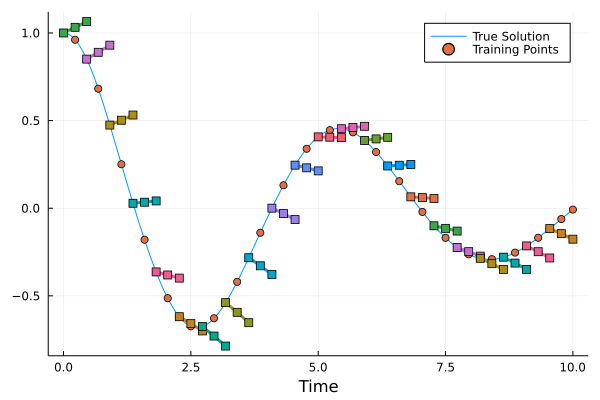

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1619.9285368069793

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


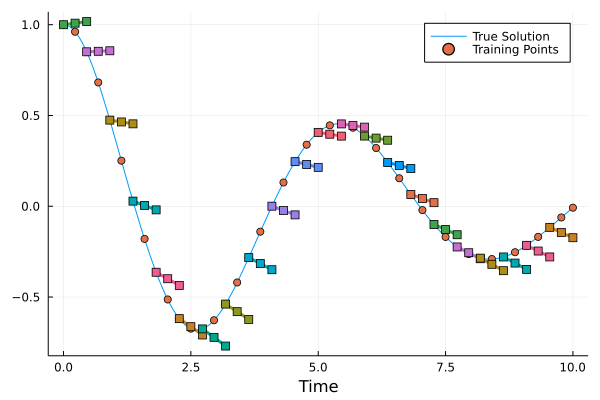

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1452.9063576187596

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


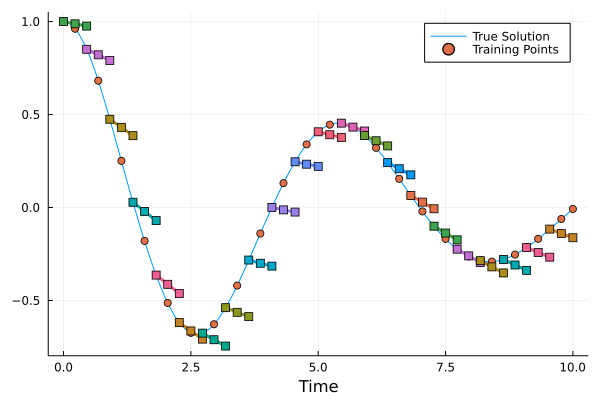

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1284.5082006629182

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


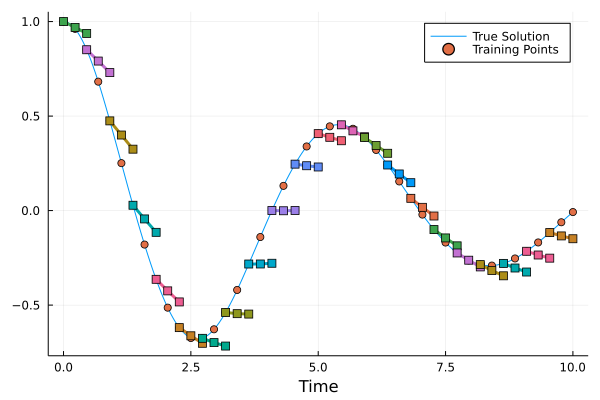

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


1117.8461019132944

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


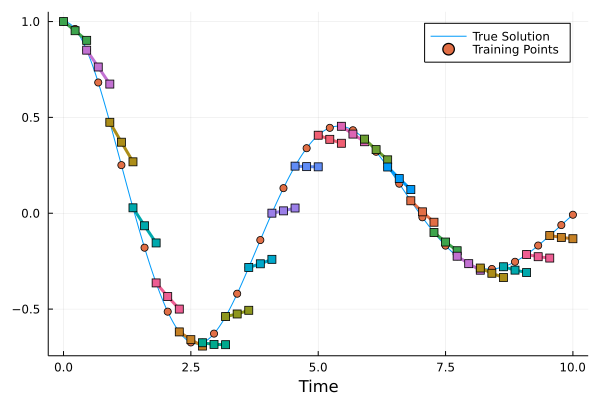

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


948.5435785009624

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


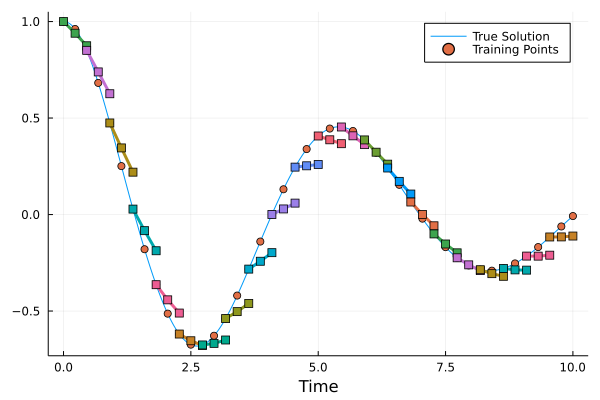

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


786.7437271469323

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


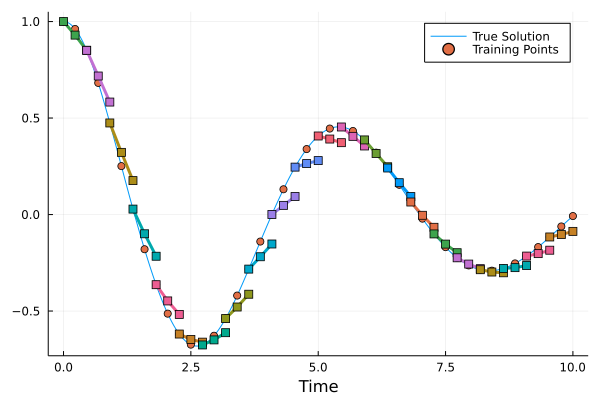

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


645.8786148802553

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


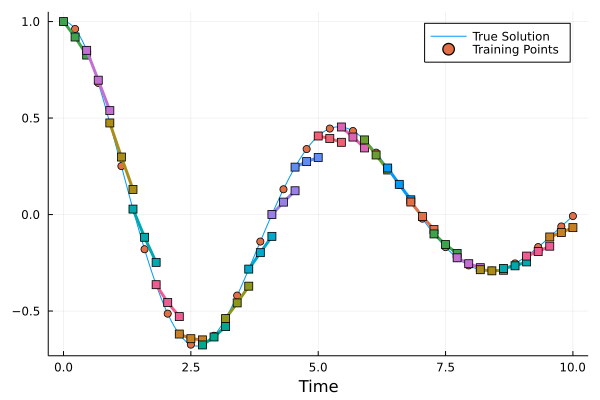

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


514.0546000746216

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


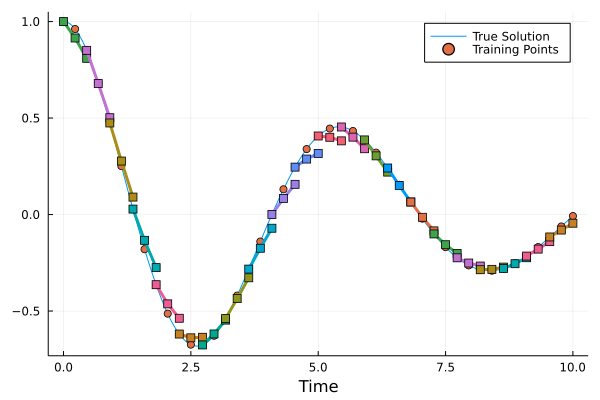

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


409.6492017836769

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


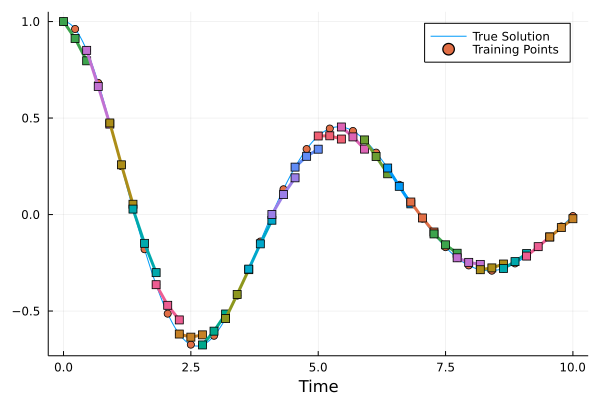

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


343.1187102355887

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


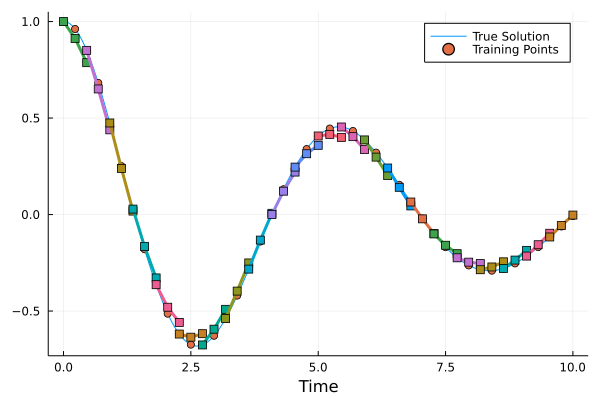

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


293.9227923178744

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


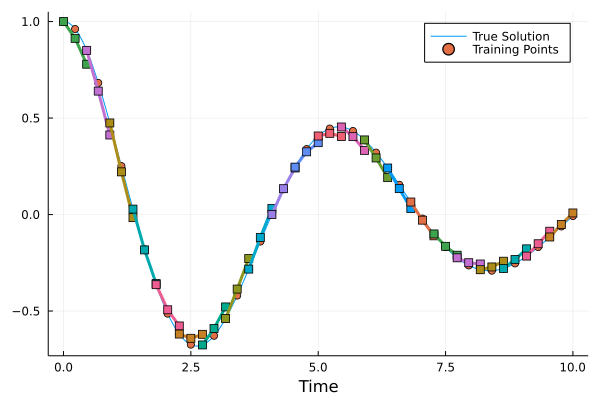

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


303.05188910923863

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


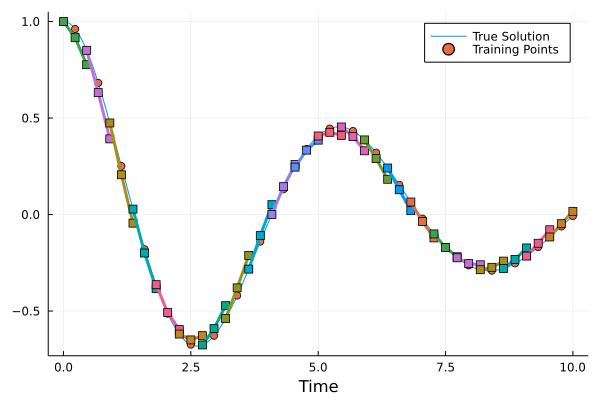

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


335.00003817998515

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


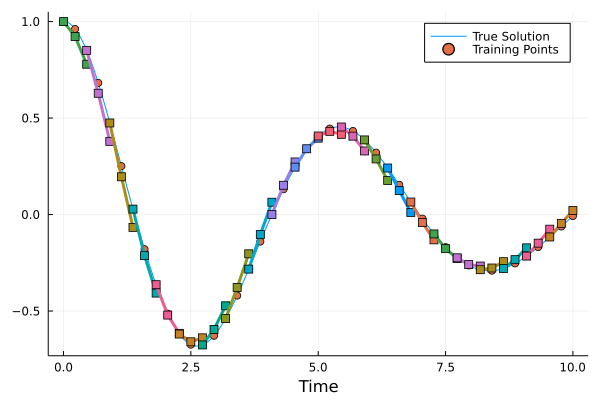

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


361.371137527988

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


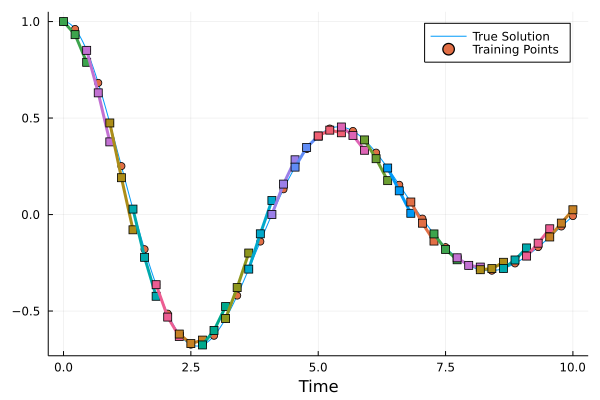

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


376.2647810946348

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


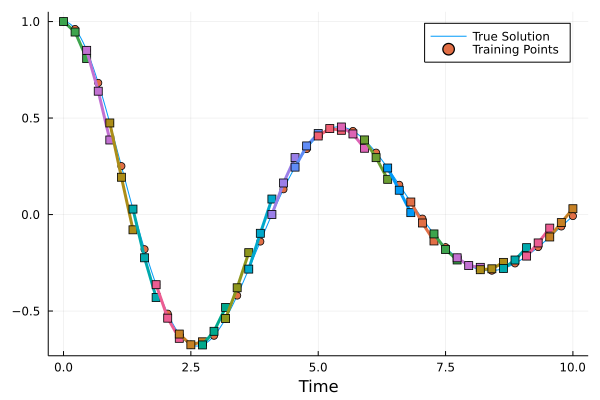

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


363.73994384291706

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


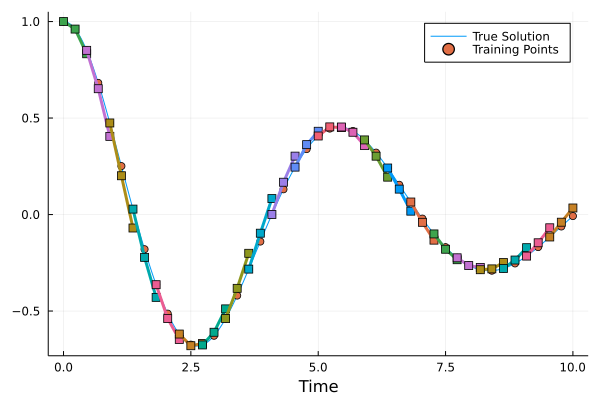

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


348.29971999351415

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


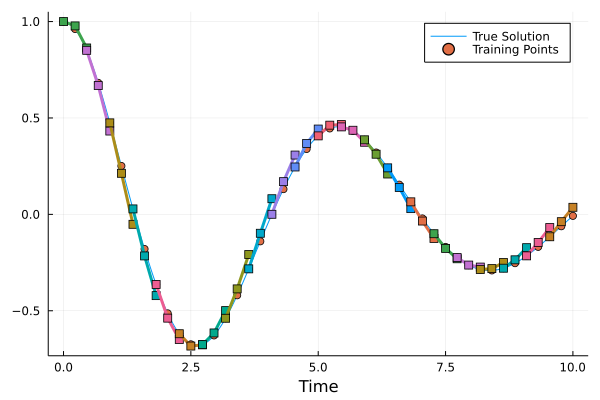

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


333.12282107585315

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


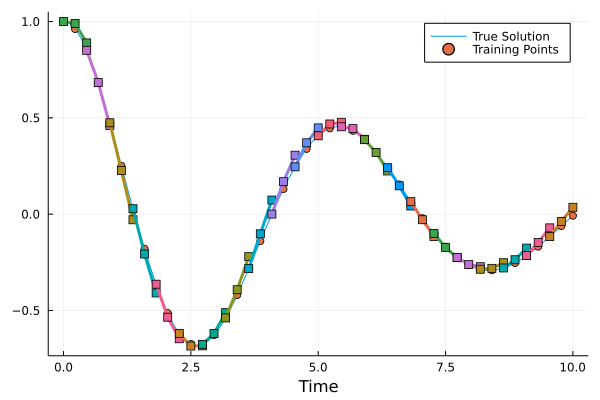

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


310.1684177540552

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


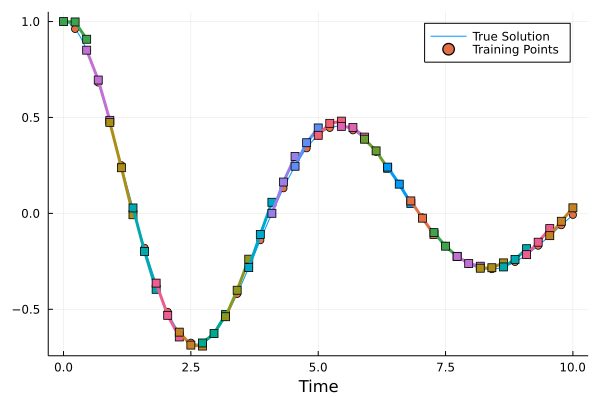

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


273.49212086634253

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


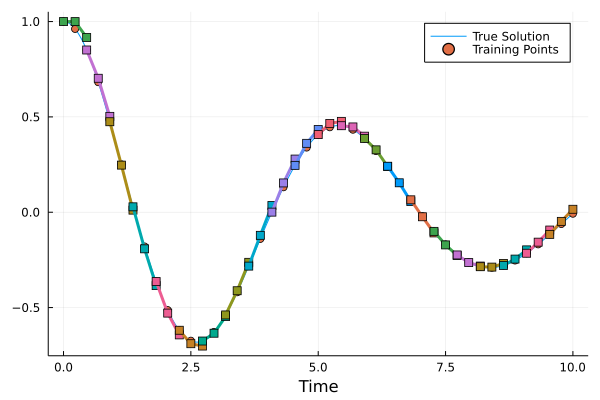

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


227.84975833005998

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


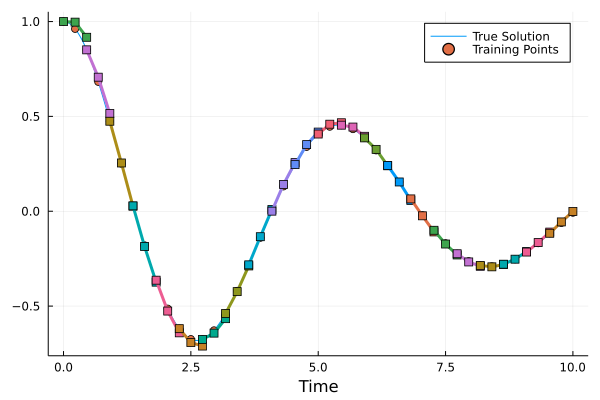

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


216.37226948501518

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


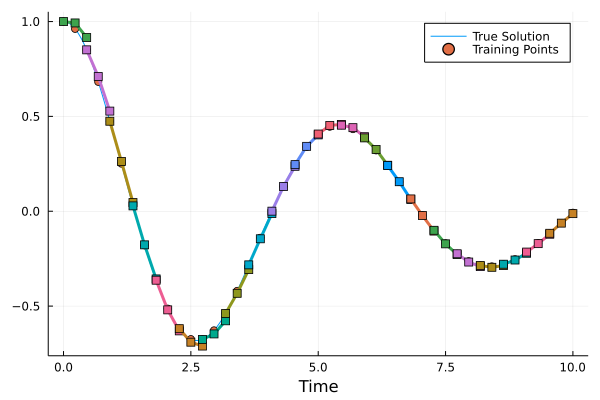

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


223.1151670930362

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


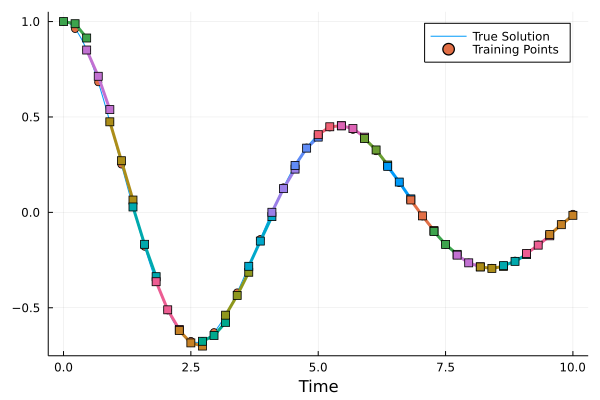

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


224.81188427168138

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


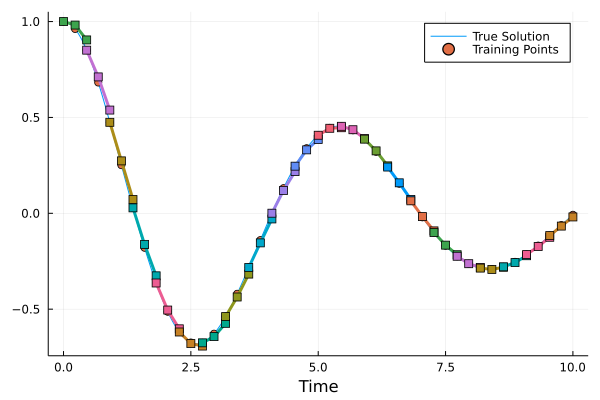

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


215.66331351277046

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


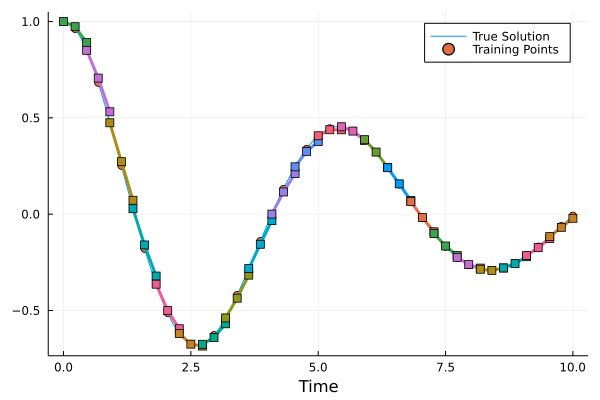

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


201.62072350469873

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


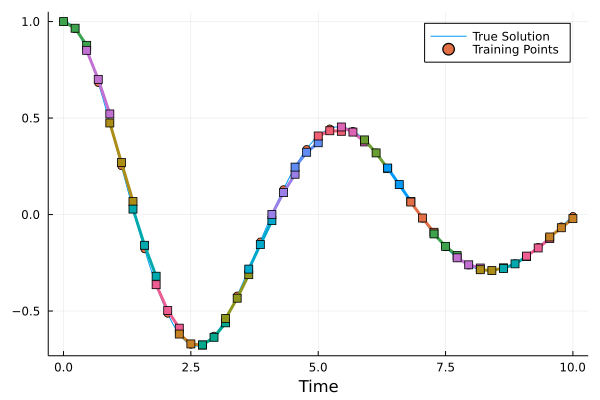

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


187.44266141449214

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


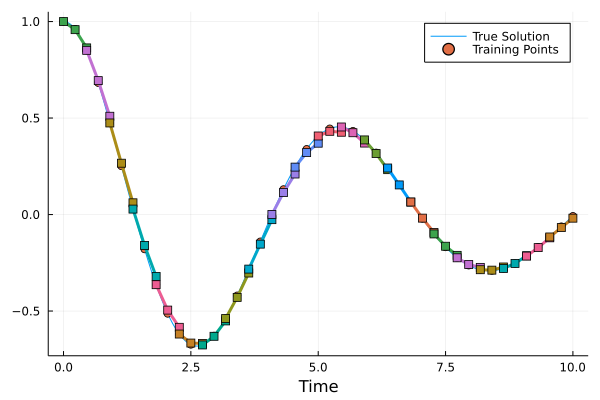

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


173.50763673603245

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


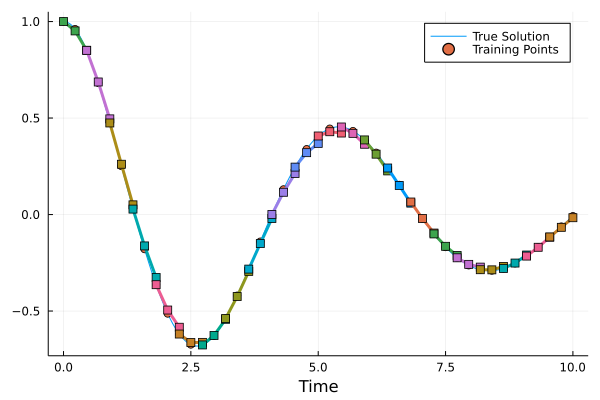

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


168.4569699752352

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


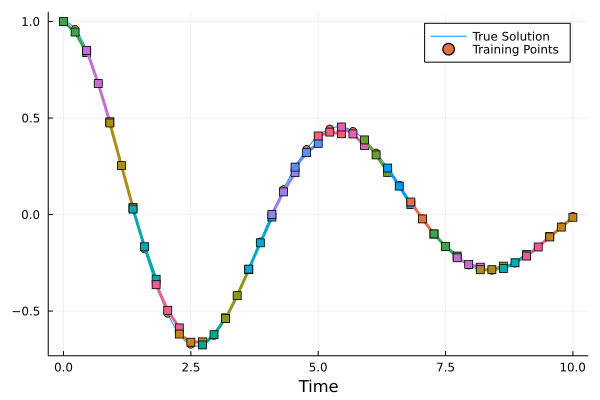

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


176.97244671266986

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


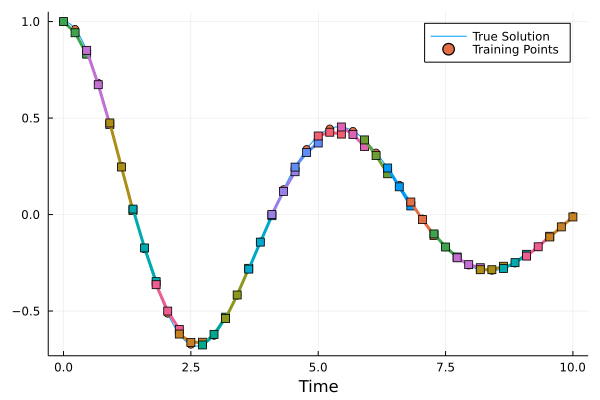

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


182.00161332987116

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


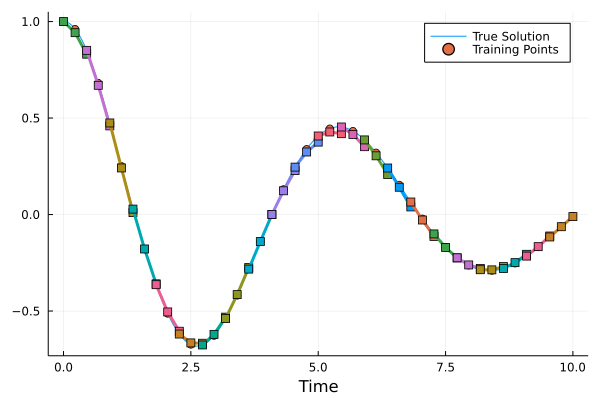

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


180.7182392093297

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


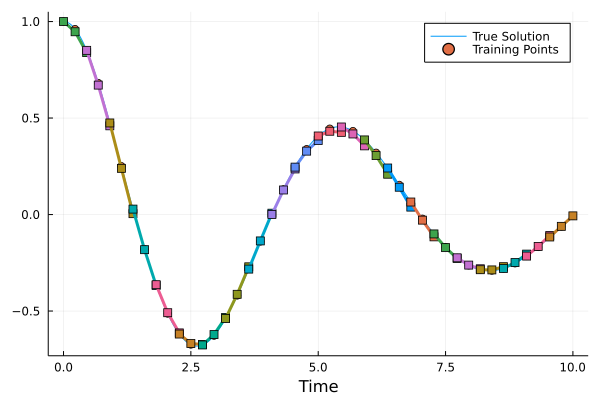

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


169.82590378139534

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


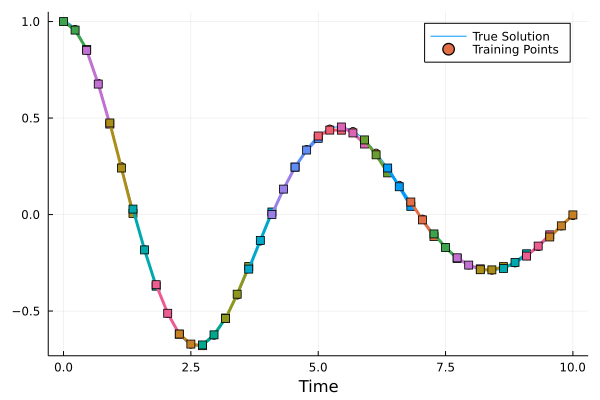

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


161.6601576128014

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


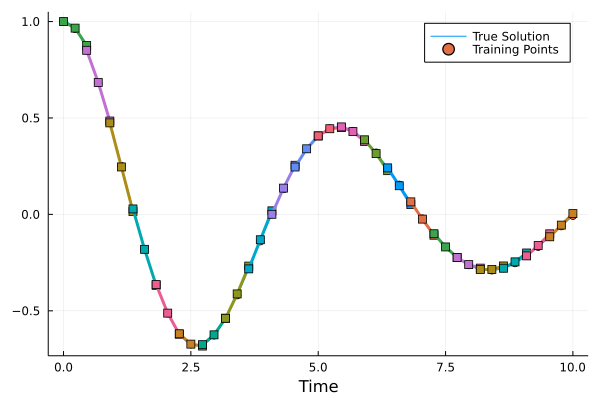

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


158.75319606260655

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


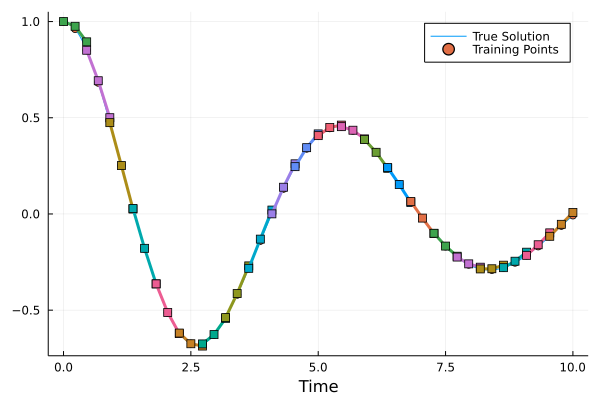

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


154.35402854073928

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


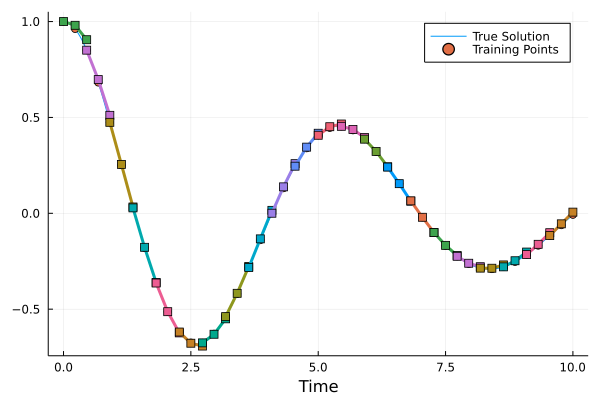

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


143.42268934210128

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


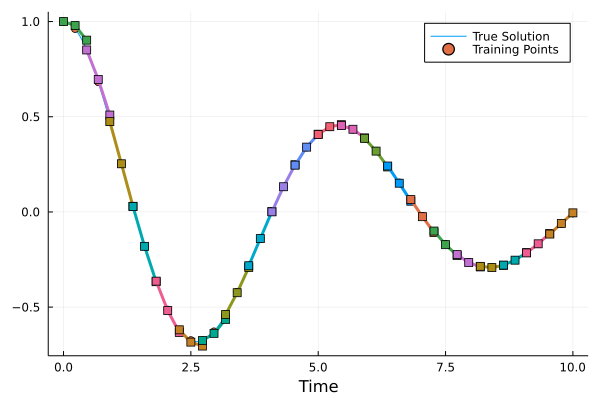

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


162.73991264971235

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


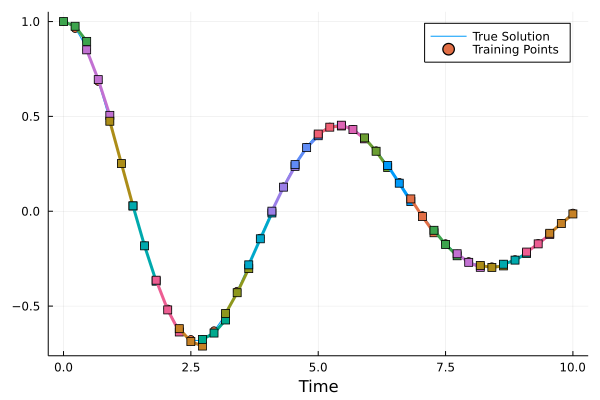

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


153.06172887162387

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


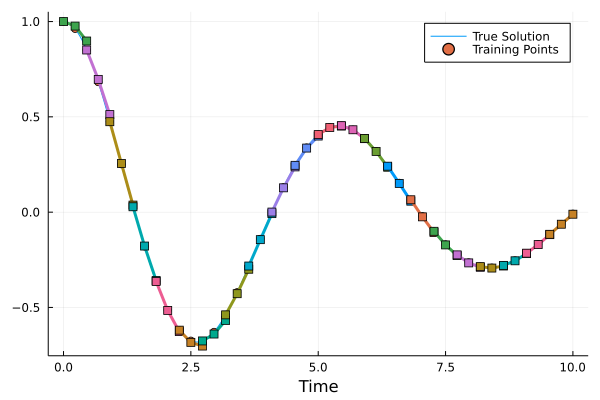

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


158.94755585690962

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


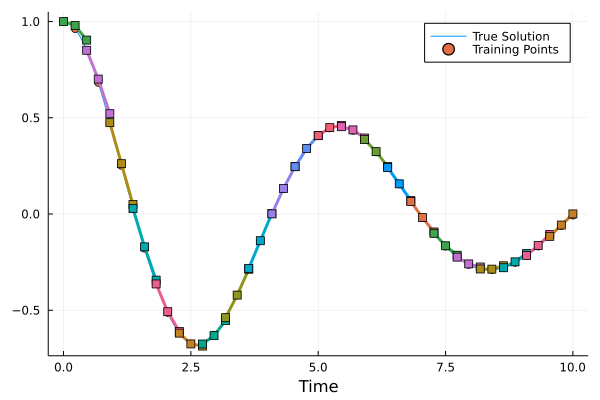

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


157.8604283117205

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


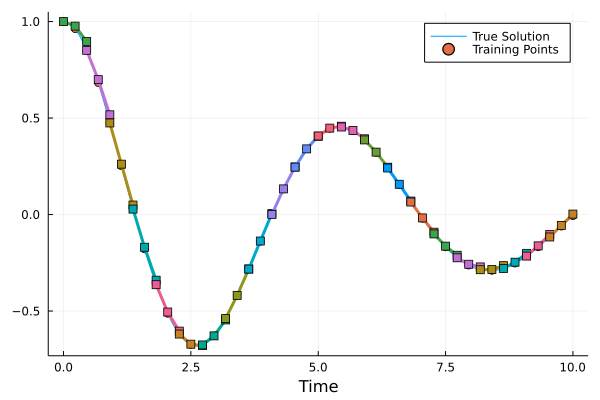

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


142.09591470778844

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


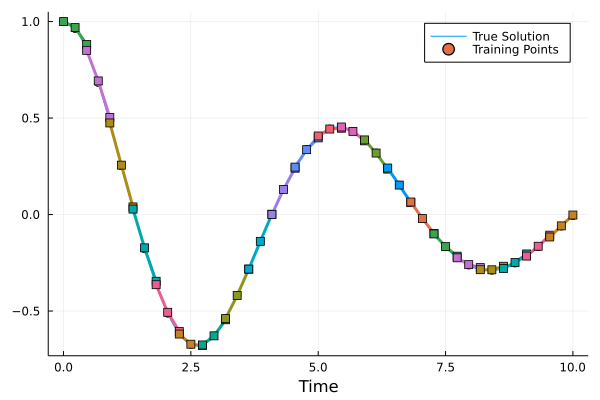

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


136.3990069375726

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


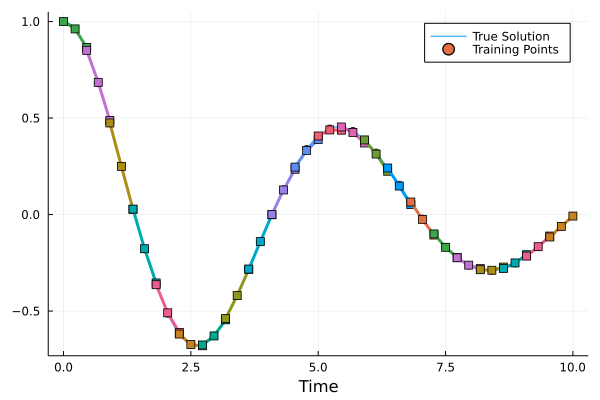

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


138.91089312043553

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


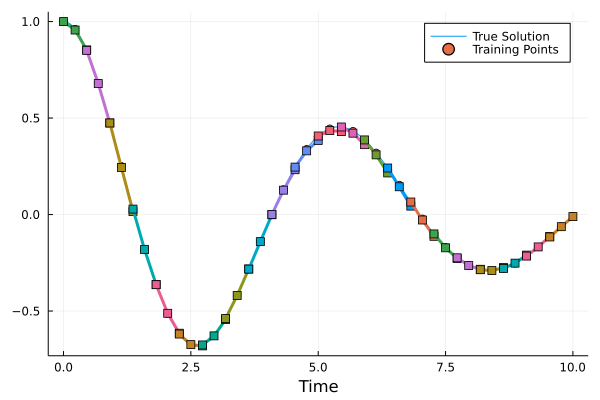

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


147.8154612822006

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


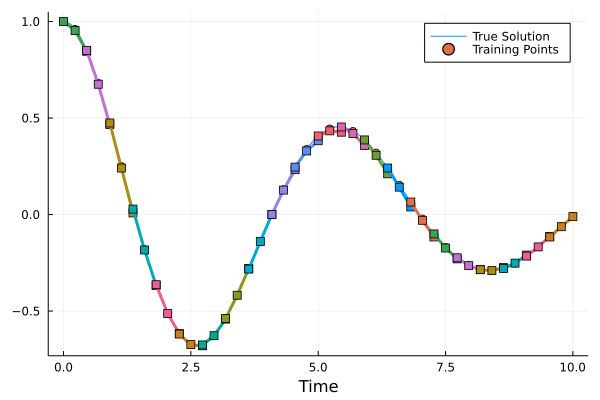

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


148.08436268632585

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


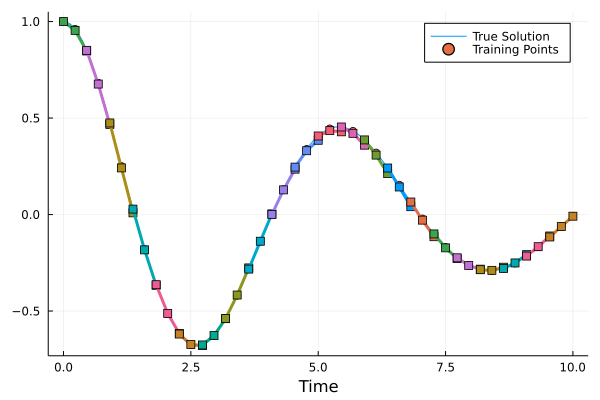

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


142.92556081246235

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


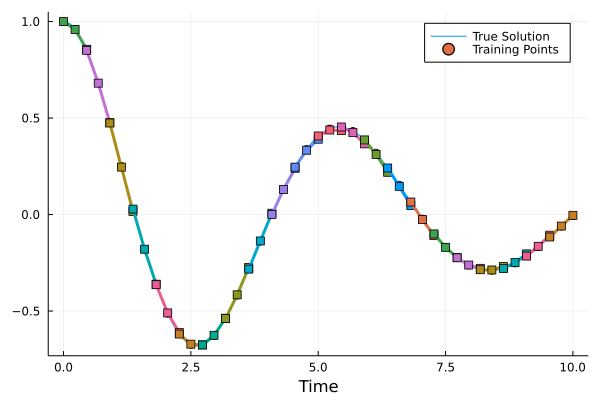

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


136.3990069375726

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


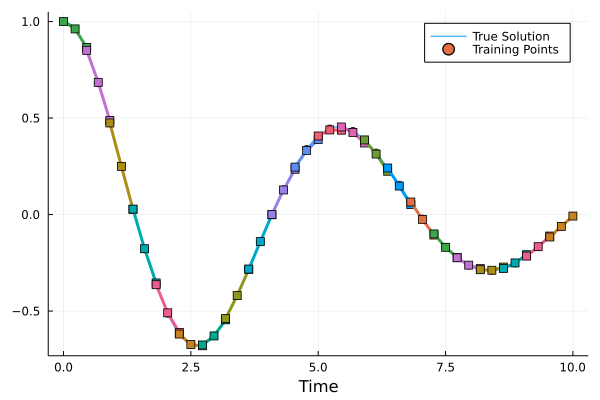

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


136.3990069375726

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


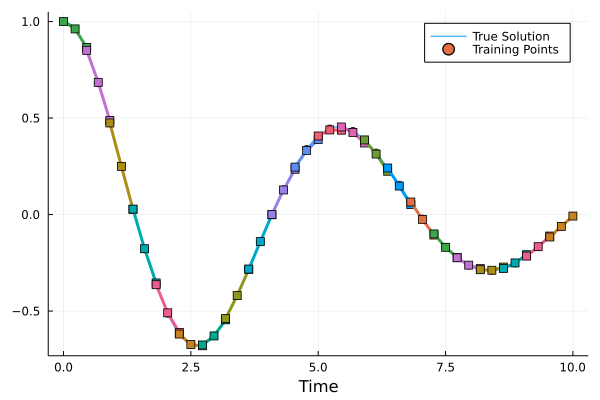

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


135.25958789090842

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


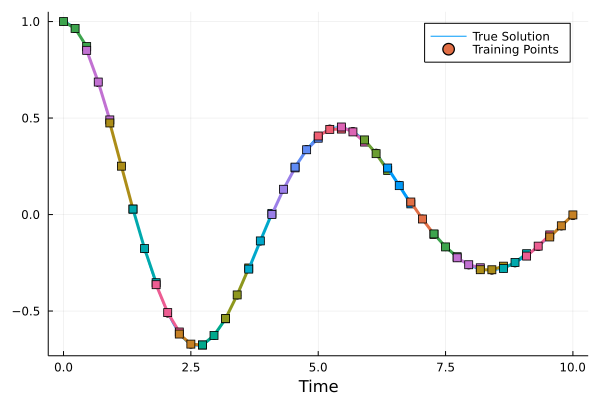

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


132.47965715485842

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


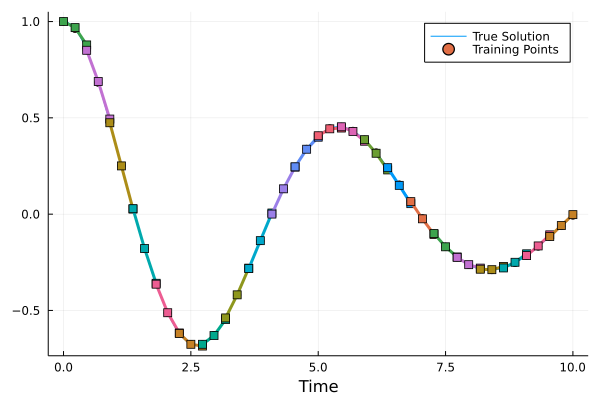

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


131.68056032557027

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


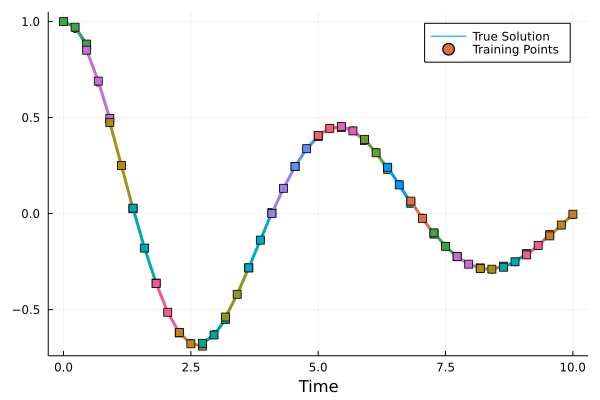

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


130.99815564875954

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


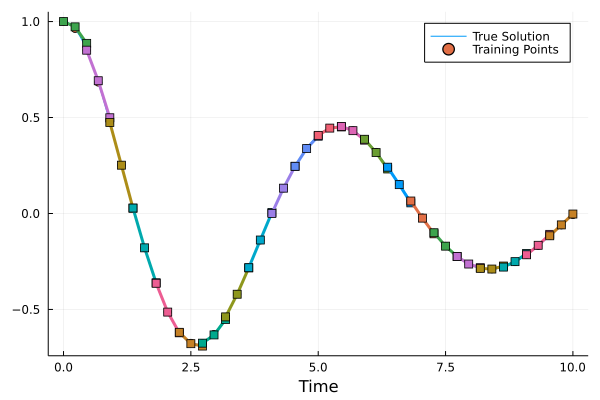

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


130.8171809662881

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


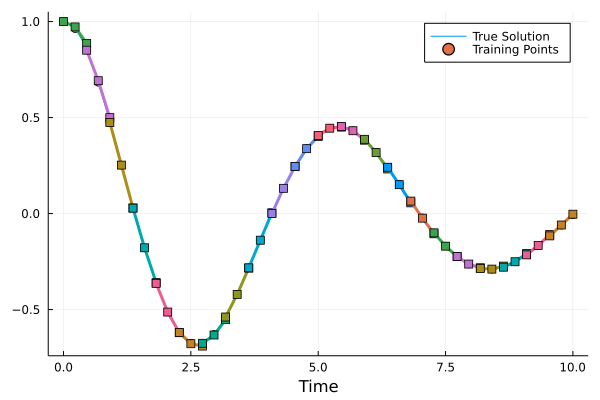

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


130.31389175014533

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


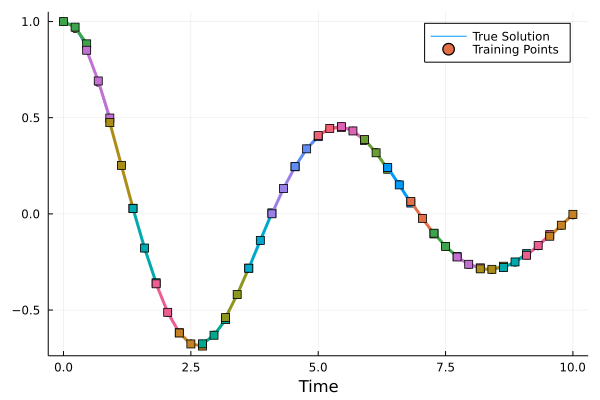

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


129.02565102029484

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


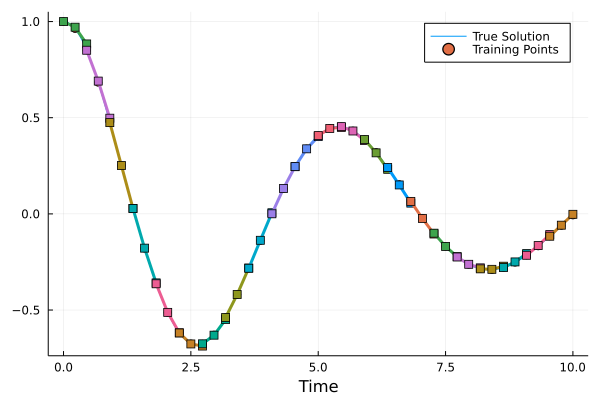

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


129.02059689049037

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


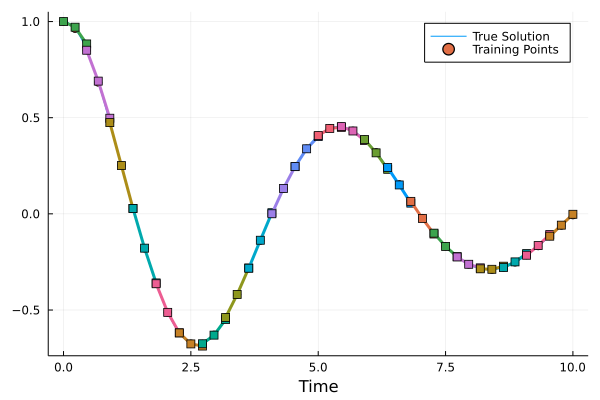

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.70679441136866

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


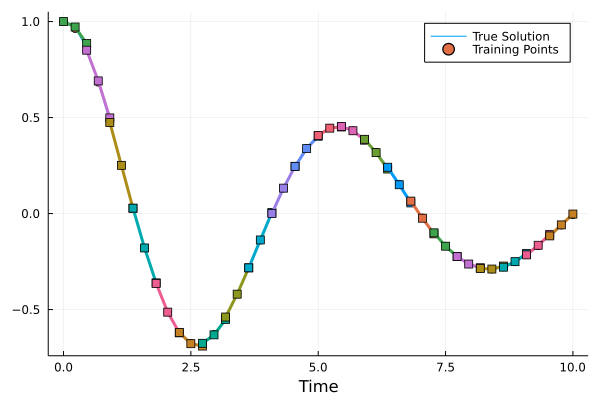

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.6866861125134

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


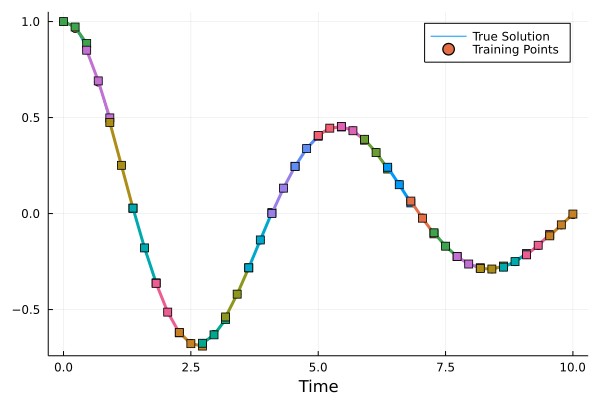

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.66079334633085

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


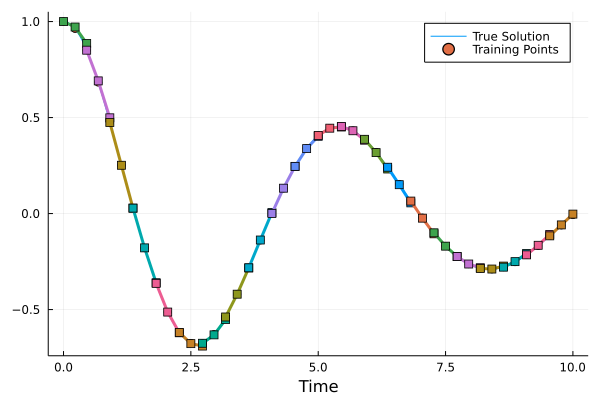

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.40591281939498

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


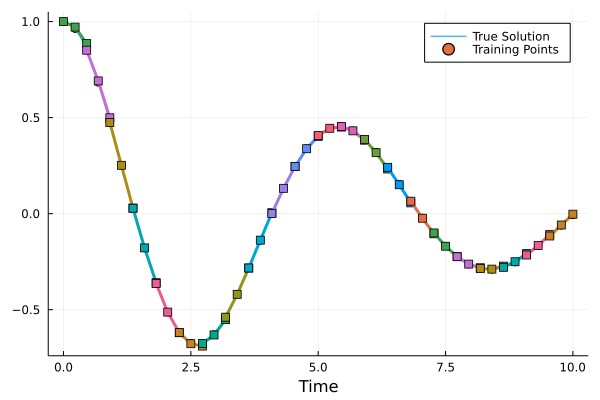

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


128.1302330727018

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


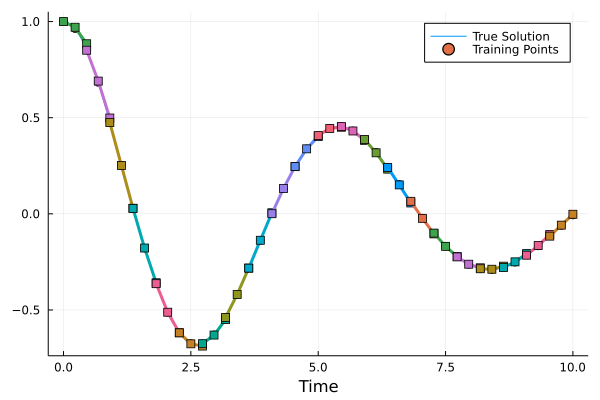

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.84192655365383

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


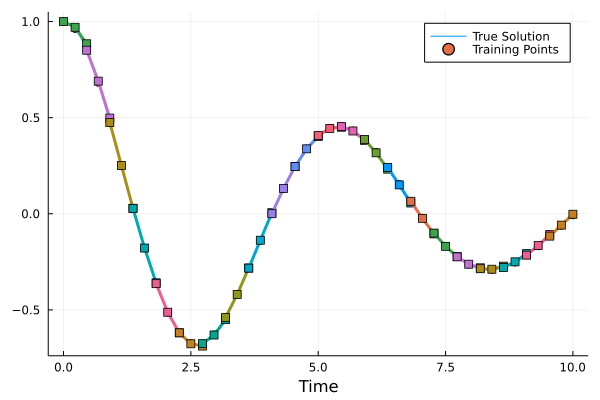

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.7365234095487

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


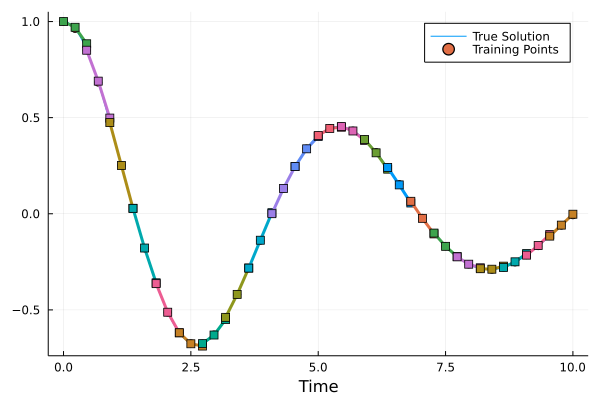

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.73558655490265

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


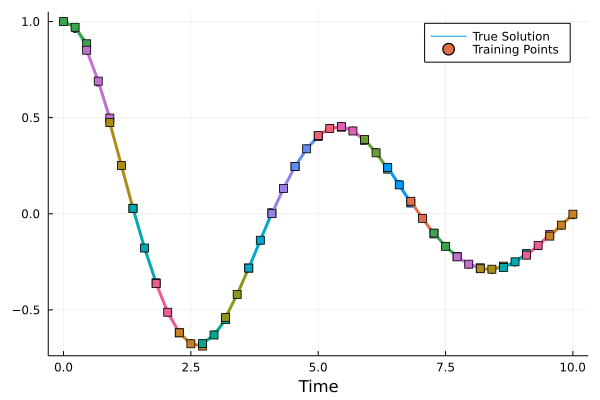

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.7149168983508

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


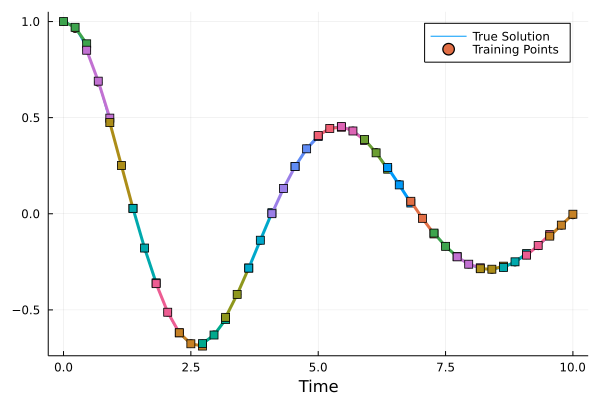

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.50051126669592

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


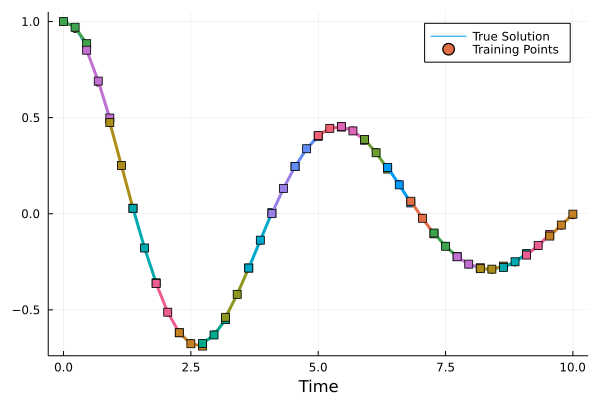

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.49375492227553

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


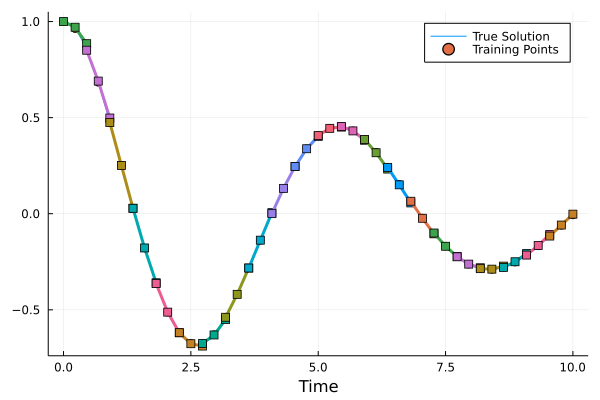

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.44938783057214

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


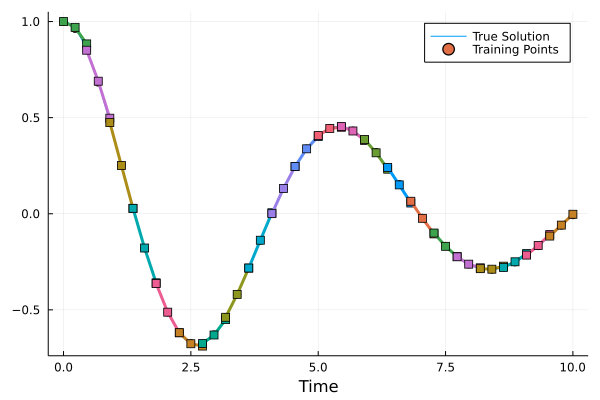

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


127.20571481306116

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


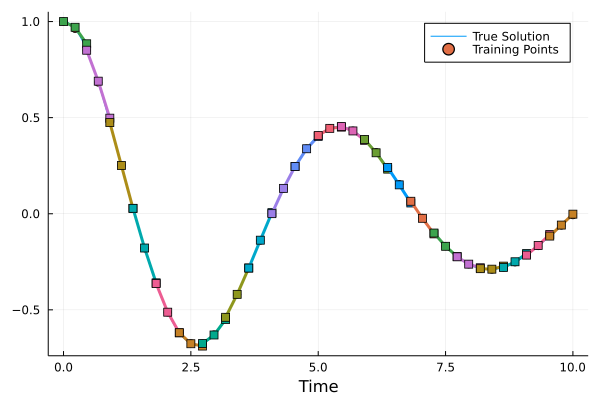

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


125.3957963484087

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


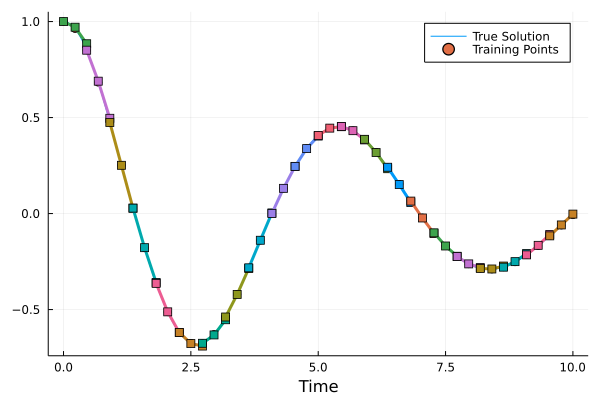

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


125.03449161152705

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


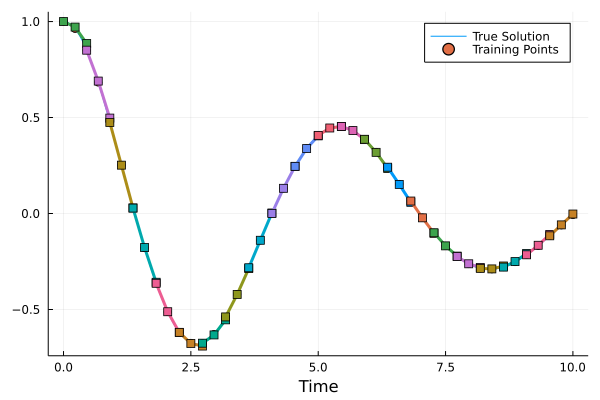

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


124.62738754982874

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


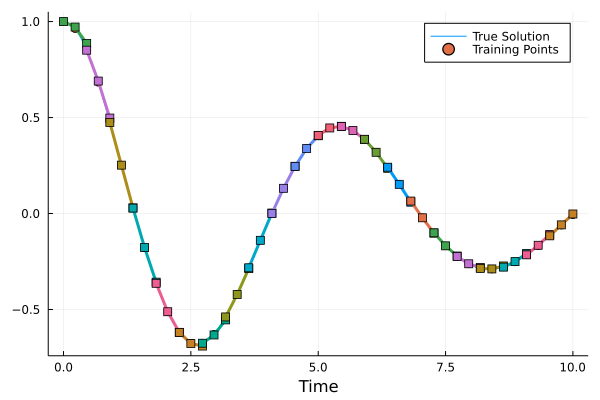

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


123.73595703692273

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


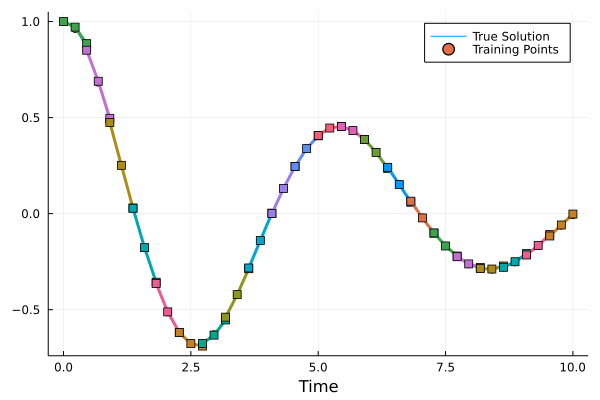

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


123.08990094222705

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


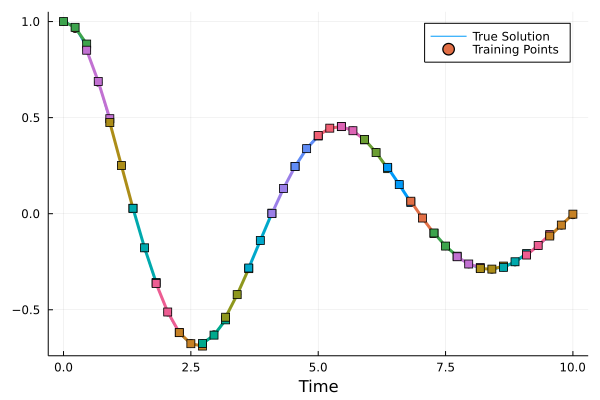

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


122.36868134746278

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


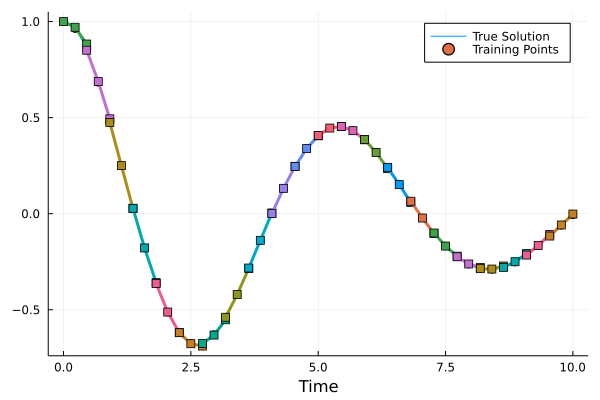

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


121.71965130853383

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


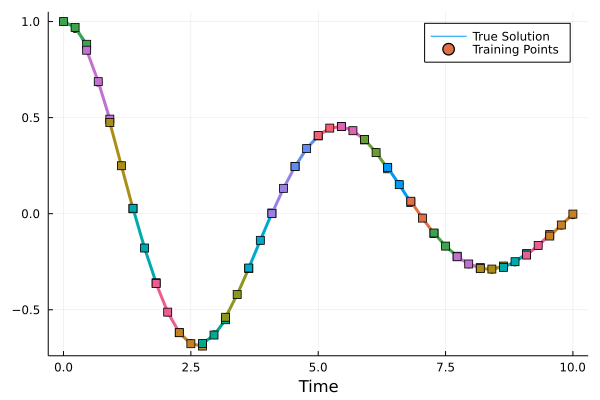

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


121.42056928895127

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


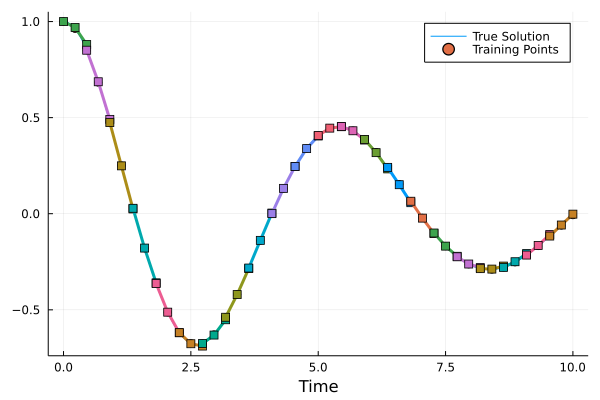

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


121.18796195429658

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


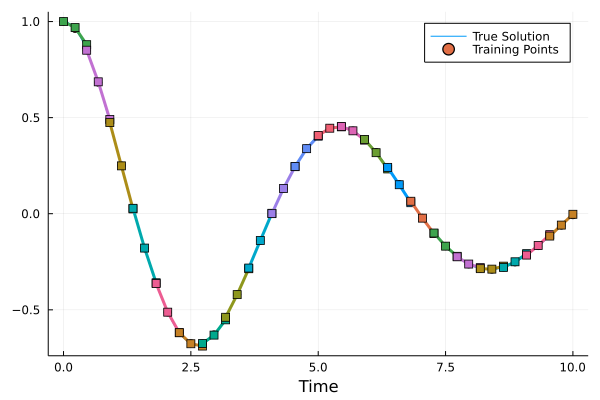

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


120.84634033679683

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


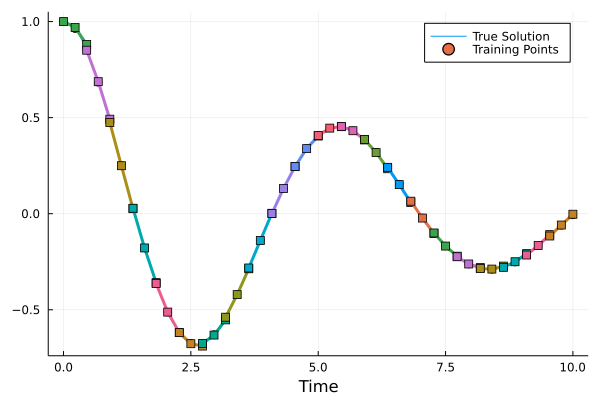

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


120.45823371546035

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


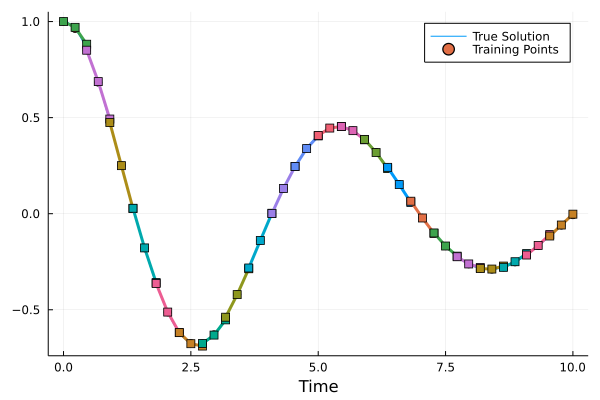

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


120.42503516419397

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


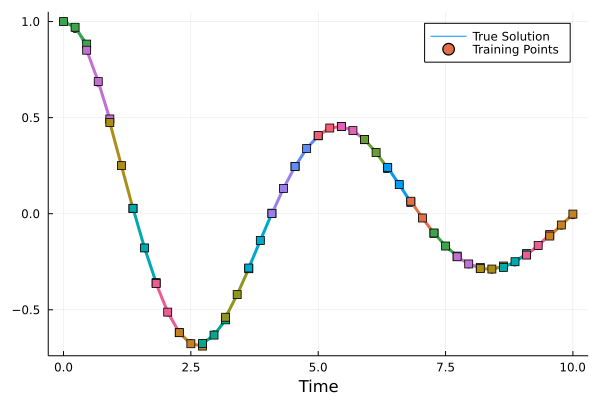

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


119.37251893460535

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


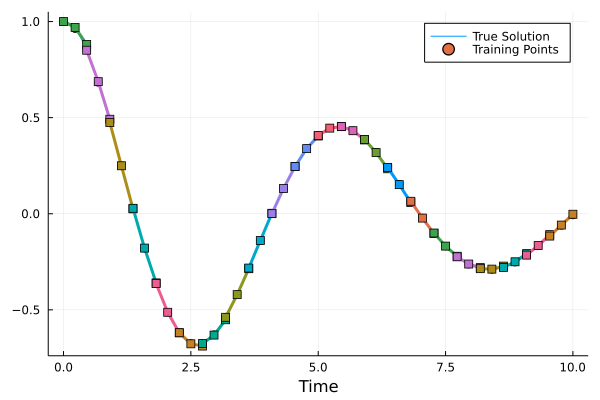

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


118.69737222027096

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


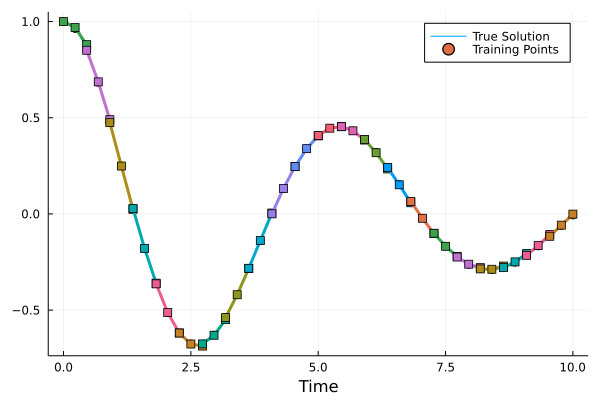

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


118.26003189163552

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


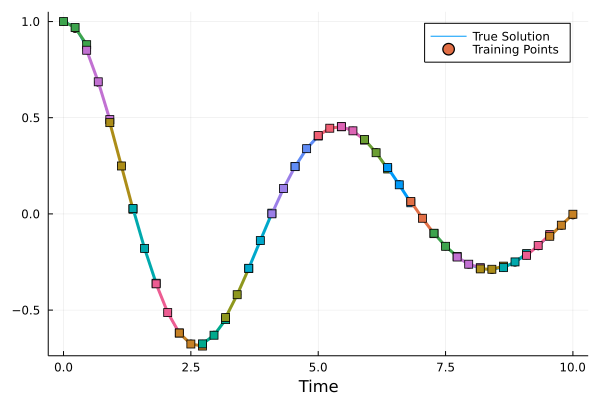

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


118.00814869240122

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


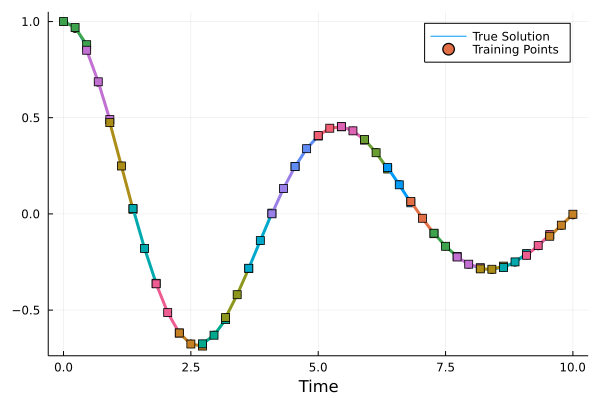

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.8627015094788

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


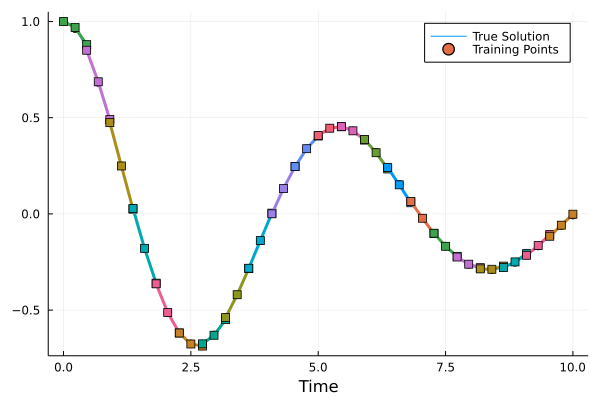

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.7361803215814

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


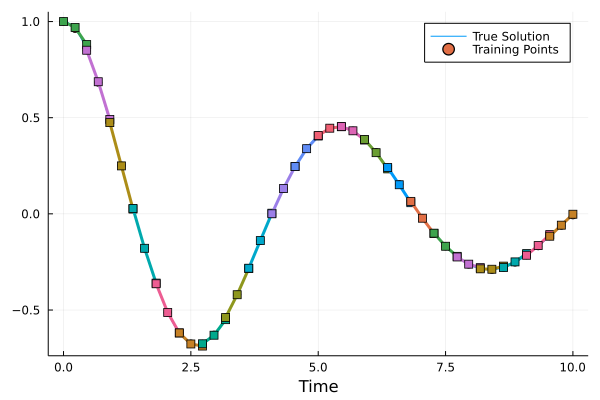

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.62583039957643

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


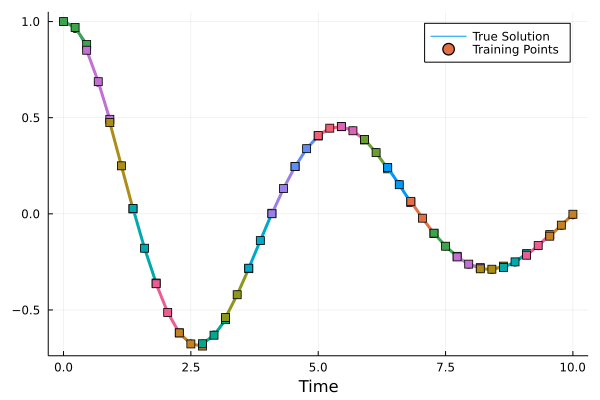

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.62592600952917

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


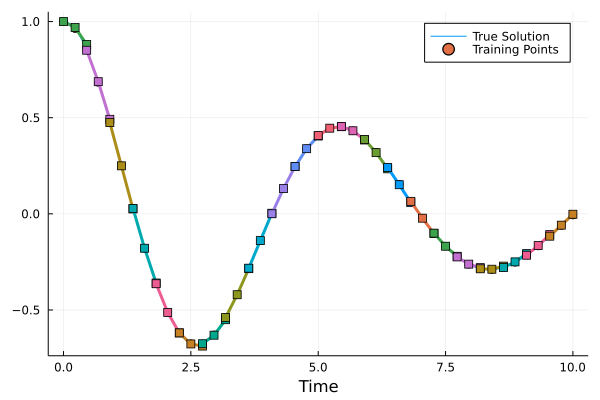

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.51856471029207

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


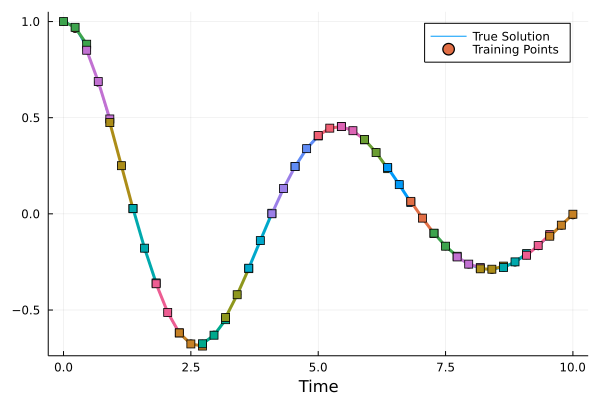

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.41645776379505

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


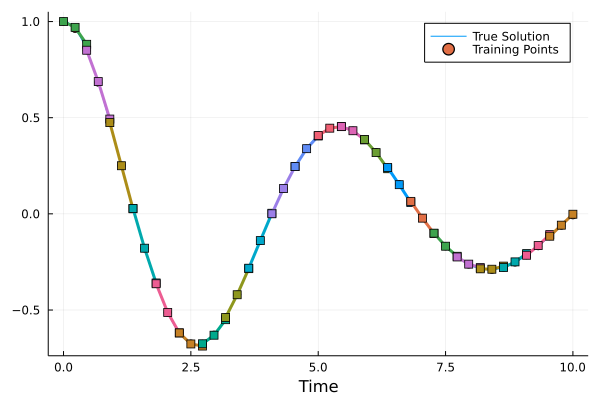

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.41634216076815

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


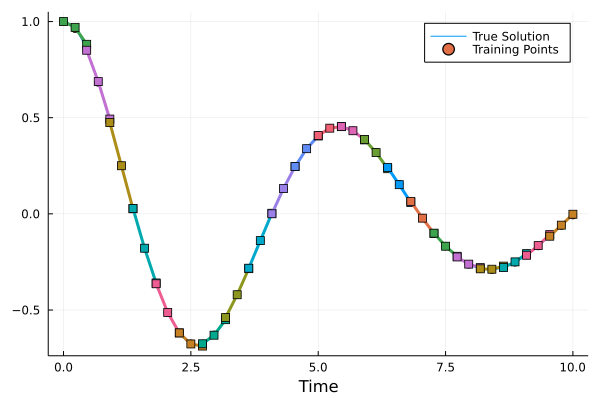

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.38730686452912

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


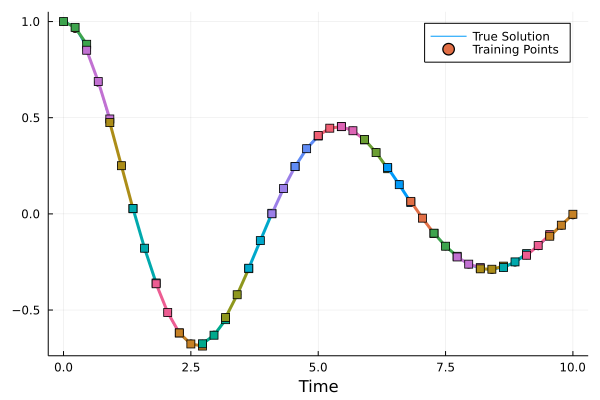

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.33332908547104

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


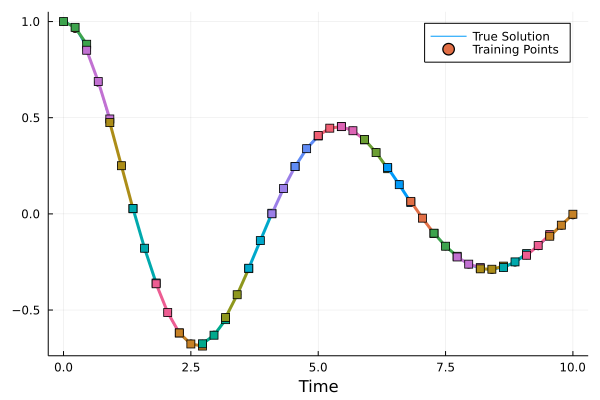

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.24451319413645

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


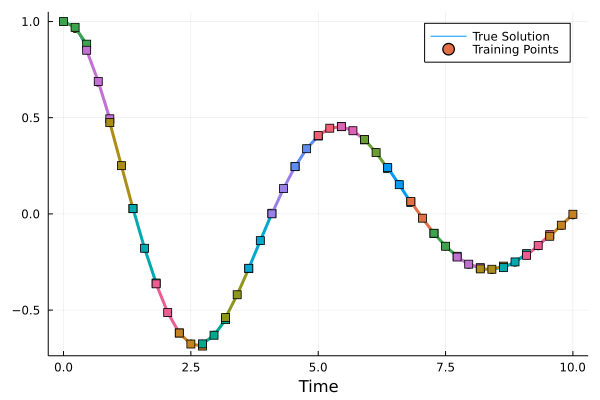

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.21726306589842

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


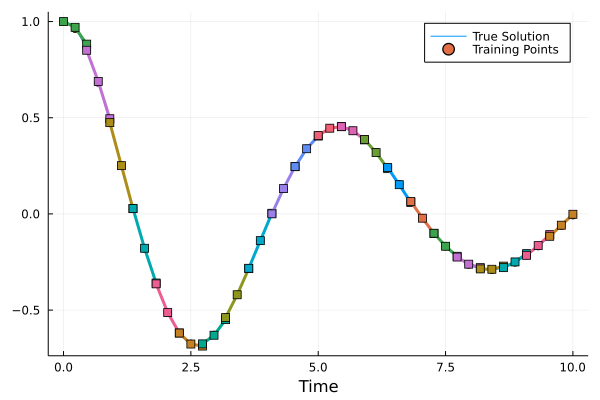

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.21697604879135

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


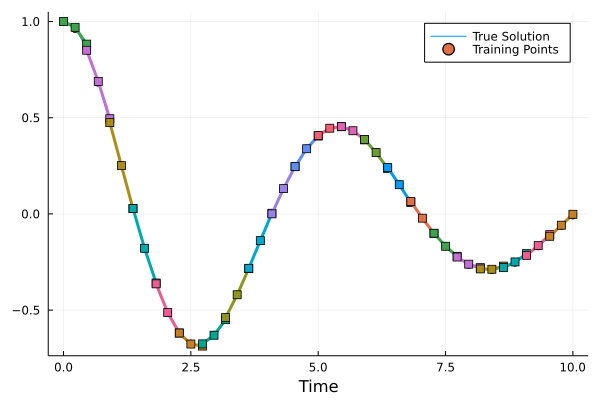

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


117.19259931309634

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


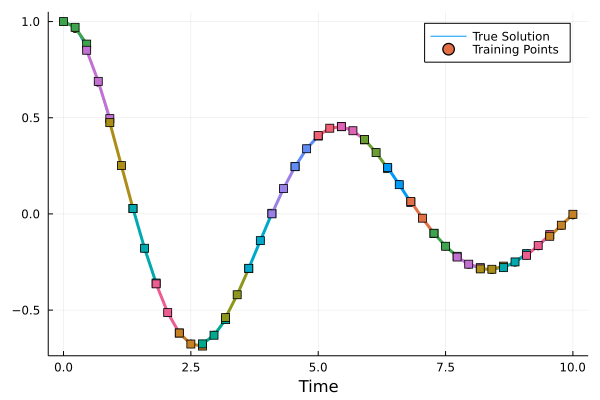

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


u: ComponentVector{Float32}(layer_1 = (weight = Float32[-0.13844739 -0.2152899; 0.14657682 0.003760952; … ; 0.029576104 -0.43463916; -0.06344916 0.23337081], bias = Float32[-0.021876547; -0.05199311; … ; 0.17548141; 0.36069533;;]), layer_2 = (weight = Float32[0.12122761 0.12716952 … -0.49189737 0.22919126; 0.017116899 -0.18098408 … -0.28198183 0.18481281], bias = Float32[-0.3052154; 0.022423957;;]))

In [11]:
using Lux
using Random
rng = Random.default_rng()
using DiffEqFlux: group_ranges

nn = Lux.Chain(
                  Lux.Dense(2, 32, tanh),
                  Lux.Dense(32, 2))
p_init, st = Lux.setup(rng, nn)
tsteps = t_45
neuralode = NeuralODE(nn, (0,12), Tsit5(), saveat = 0.01)
prob_node = ODEProblem((u,p,t)->nn(u,p,st)[1], initial_1, (0,12), Lux.ComponentArray(p_init))

function plot_multiple_shoot(plt, preds, group_size)
    step = group_size-1
    ranges = group_ranges(45, group_size)

    for (i, rg) in enumerate(ranges)
        plot!(plt3, t_45[rg], preds[i][1,:], markershape=:rect,label = "",width = 3)
    end
end




anim = Plots.Animation()
iter = 0
callback = function (p, l, preds; doplot = true)
  display(l)
  global iter
  iter += 1
  if doplot && iter%1 == 0
    # plot the original data
    plt3 = plot(t_true,Array(sol_Duffing_true)[1,:],label = "True Solution")
    global plt3
    scatter!(plt3,t_45, sol_Duffing_45[1,:], label = "Training Points")
    xlabel!(plt3,"Time")

    # plot the different predictions for individual shoot
    plot_multiple_shoot(plt3, preds, group_size)

    frame(anim)
    display(plot(plt3))
  end
  return false
end

group_size = 3
continuity_term = 200

function loss_function(data, pred)
    return sum(abs2, data - pred)
end

function loss_multiple_shooting(p)
    return multiple_shoot(p, sol_Duffing_45, t_45, prob_node, loss_function, Tsit5(),
                          group_size; continuity_term)
end

adtype = Optimization.AutoZygote()
optf = Optimization.OptimizationFunction((x,p) -> loss_multiple_shooting(x), adtype)
optprob = Optimization.OptimizationProblem(optf, Lux.ComponentArray(p_init))
res_ms = Optimization.solve(optprob, PolyOpt(),
                                callback = callback,maxiters = 50)

In [12]:
sum((Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.00042502126901947497

In [13]:
sum(abs.(Array(neuralode(initial_1,res_ms.u,st)[1])[1,1001:1201] - sol_Duffing_true_12[1,1001:1201]))/200

0.015841490569615844

## PINN Predict

In [14]:
NNODE = Flux.Chain(x -> [x],
           Flux.Dense(1,32,tanh),
           Flux.Dense(32,1),
           first)

g(t) = t*NNODE(t) + initial_1[1]
ϵ = sqrt(eps(Float32))
loss() = mean(([(g(t+ϵ)-g(t))/ϵ for t in t_15] .- sol_Duffing_15[2,:]).^2) 

#+ 0.1* mean((NNODE.(t_1) .- sol_Duffing[1,:]).^2)

opt = Flux.Adam(0.1)
data = Iterators.repeated((), 800)
iter = 0
cb = function () #callback function to observe training
  global iter += 1
  if iter % 500 == 0
    display(loss())
  end
end
display(loss())
Flux.train!(loss, Flux.params(NNODE), data, opt; cb=cb)


12.767140878980692

0.001884082176375589

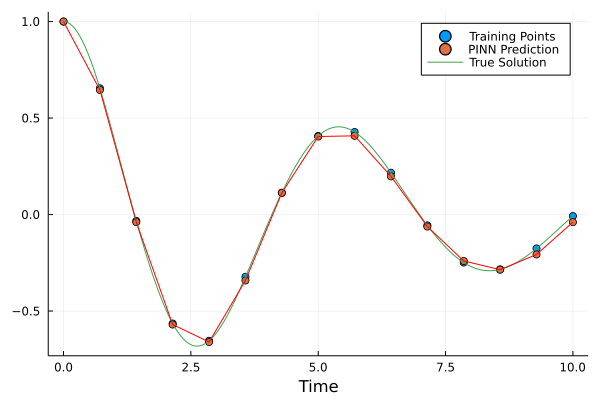

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [15]:
pinn_1 = plot()
scatter!(pinn_1,t_15,sol_Duffing_15[1,:],label = "Training Points")
scatter!(pinn_1,t_15,g.(t_15),label = "PINN Prediction")
plot!(pinn_1,t_true,Array(sol_Duffing_true)[1,:],label = "True Solution")
plot!(pinn_1,t_15,g.(t_15),label = "",color = "red")
xlabel!(pinn_1,"Time")

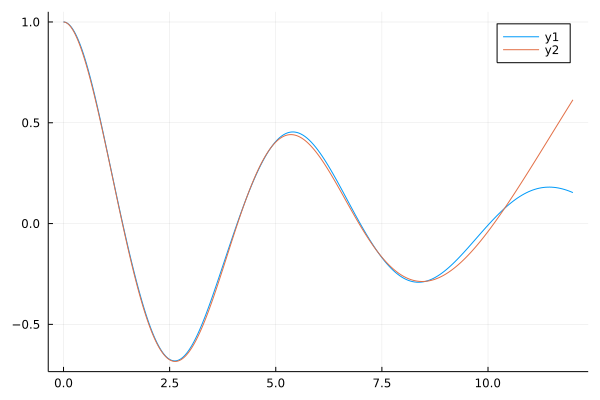

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [16]:
plot(t_true_12,sol_Duffing_true_12[1,:])
plot!(t_true_12,g.(t_true_12))

In [17]:
sum((g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.04359763203897337

In [18]:
sum(abs.(g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201])) /200

0.15546355667850512

In [19]:
NNODE = Flux.Chain(x -> [x],
           Flux.Dense(1,32,tanh),
           Flux.Dense(32,1),
           first)

g(t) = t*NNODE(t) + initial_1[1]
ϵ = sqrt(eps(Float32))
loss() = mean(([(g(t+ϵ)-g(t))/ϵ for t in t_30] .- sol_Duffing_30[2,:]).^2) 

#+ 0.1* mean((NNODE.(t_1) .- sol_Duffing[1,:]).^2)

opt = Flux.Adam(0.1)
data = Iterators.repeated((), 600)
iter = 0
cb = function () #callback function to observe training
  global iter += 1
  if iter % 500 == 0
    display(loss())
  end
end
display(loss())
Flux.train!(loss, Flux.params(NNODE), data, opt; cb=cb)

6.438133930896746

0.0002130428737774988

In [20]:
sum((g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.02840027460601714

In [21]:
sum(abs.(g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201])) /200

0.1240399439364807

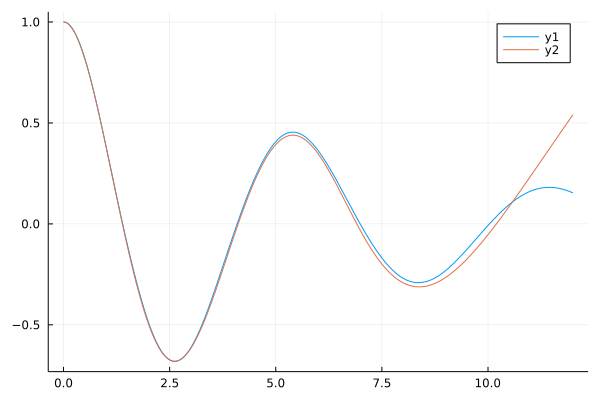

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [22]:
plot(t_true_12,sol_Duffing_true_12[1,:])
plot!(t_true_12,g.(t_true_12))

In [23]:
NNODE = Flux.Chain(x -> [x],
           Flux.Dense(1,32,tanh),
           Flux.Dense(32,1),
           first)

g(t) = t*NNODE(t) + initial_1[1]
ϵ = sqrt(eps(Float32))
loss() = mean(([(g(t+ϵ)-g(t))/ϵ for t in t_45] .- sol_Duffing_45[2,:]).^2) 

#+ 0.1* mean((NNODE.(t_1) .- sol_Duffing[1,:]).^2)

opt = Flux.Adam(0.1)
data = Iterators.repeated((), 400)
iter = 0
cb = function () #callback function to observe training
  global iter += 1
  if iter % 100 == 0
    display(loss())
  end
end
display(loss())
Flux.train!(loss, Flux.params(NNODE), data, opt; cb=cb)

0.20884997723492976

0.030732124653905332

0.025021956557391832

0.022215390253619086

0.000581981676884022

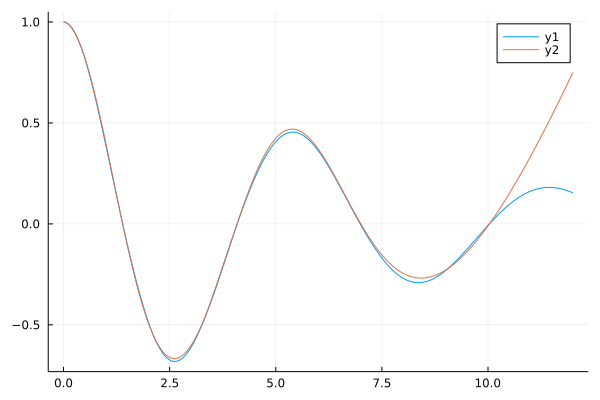

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [24]:
plot(t_true_12,sol_Duffing_true_12[1,:])
plot!(t_true_12,g.(t_true_12))

In [25]:
sum((g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201]).^2) /200

0.07831279357743894

In [26]:
sum(abs.(g.(t_true_12)[1001:1201] - sol_Duffing_true_12[1,1001:1201])) /200

0.21603052077414886

## Echo State 

In [27]:
t_true_15 = range(timespan_2[1],timespan_2[2],length = 24)
data_ESN = sol_Duffing_true_15 = solve(prob_Duffing_2,Tsit5(),saveat=t_true_15)

retcode: Success
Interpolation: 1st order linear
t: 24-element Vector{Float64}:
  0.0
  0.5217391304347826
  1.0434782608695652
  1.565217391304348
  2.0869565217391304
  2.608695652173913
  3.130434782608696
  3.652173913043478
  4.173913043478261
  4.695652173913044
  5.217391304347826
  5.739130434782608
  6.260869565217392
  6.782608695652174
  7.304347826086956
  7.826086956521739
  8.347826086956522
  8.869565217391305
  9.391304347826088
  9.91304347826087
 10.434782608695652
 10.956521739130435
 11.478260869565217
 12.0
u: 24-element Vector{Vector{Float64}}:
 [1.0, 0.0]
 [0.8062937796263642, -0.6960348567680923]
 [0.34281887474801054, -0.9950499577223635]
 [-0.15726549711285162, -0.8719054066631919]
 [-0.5361477758959853, -0.5365006655521688]
 [-0.6813460940879269, -0.009978834437736516]
 [-0.5619523883036818, 0.4374202759767495]
 [-0.2728696096038944, 0.6174361260998896]
 [0.04956718558004122, 0.5903829542391049]
 [0.31022683727782757, 0.38945199743462544]
 [0.4444625008093078

In [28]:
shift = 5
train_len = 15
predict_len = 4
t_esn = range(0,12,length=24)

#split the data accordingly
input_data = data_ESN[:, shift:shift+train_len-1]
t_input = t_esn[shift:shift+train_len-1]

target_data = data_ESN[:, shift+1:shift+train_len]
t_target = t_esn[shift+1:shift+train_len]


test_data = data_ESN[:,shift+train_len+1:shift+train_len+predict_len]
t_test = t_esn[shift+train_len+1:shift+train_len+predict_len]

10.434782608695652:0.5217391304347826:12.0

In [29]:
using ReservoirComputing
res_size = 10
res_radius = 1.0
res_sparsity = 1.0
input_scaling = 0.1

#build ESN struct
esn = ESN(input_data; 
    variation = Default(),
    reservoir = RandSparseReservoir(res_size, radius=res_radius, sparsity=res_sparsity),
    input_layer = WeightedLayer(scaling=input_scaling),
    
    nla_type = NLADefault(),
    states_type = StandardStates())

ESN{Int64, Matrix{Float64}, Default, NLADefault, Matrix{Float64}, ReservoirComputing.RNN{typeof(tanh_fast), Float64}, Matrix{Float64}, Matrix{Float64}, StandardStates, Int64, Matrix{Float64}}(10, [-0.5361477758959853 -0.6813460940879269 … -0.2523895008247586 -0.15204439319726468; -0.5365006655521688 -0.009978834437736516 … 0.1418526854684617 0.23325691231386195], Default(), NLADefault(), [0.07908493695314928 0.0; -0.054227376722358736 0.0; … ; 0.0 -0.02102330753421451; 0.0 -0.011497981824089232], ReservoirComputing.RNN{typeof(tanh_fast), Float64}(NNlib.tanh_fast, 1.0), [0.1346882936532806 -0.10093919763836326 … -0.11665418494791922 -0.22911938401989648; -0.0006099917594332438 0.21076003889376865 … -0.34748869146710804 0.10472637845603545; … ; -0.19902343147458293 -0.19889134734289046 … -0.07716353857002956 0.2797615319489912; -0.33291926293621 -0.02993195681329906 … -0.13584151376024498 0.30547551508586335], [0.0; 0.0; … ; 0.0; 0.0;;], StandardStates(), 0, [-0.04237582079269437 -0.0662

In [30]:
#define training method
training_method = StandardRidge(0.0)

#obtain output layer
output_layer = train(esn, target_data, training_method)

output1 = esn(Generative(4), output_layer)

2×4 Matrix{Float64}:
 0.0798769  0.145557    0.158385    0.121807
 0.17487    0.0731045  -0.0267212  -0.108271

In [31]:
test_data

2×4 Matrix{Float64}:
 0.0838303  0.157996    0.180567     0.153614
 0.192199   0.0906575  -0.00752244  -0.0869976

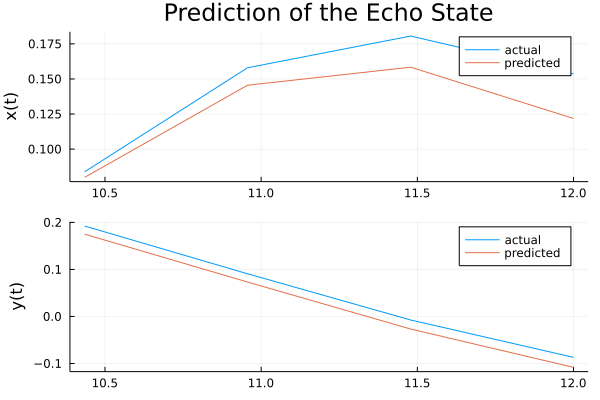

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [32]:
p1 = plot(t_test, [test_data[1,:] output1[1,:]], label = ["actual" "predicted"], 
    ylabel = "x(t)");



p2 = plot(t_test, [test_data[2,:] output1[2,:]], label = ["actual" "predicted"], 
    ylabel = "y(t)");


plot(p1, p2, plot_title = "Prediction of the Echo State", 
    layout=(2,1))

In [33]:
sum((test_data[1,:] - output1[1,:]).^2) / 4

0.0004185070929706433

In [34]:
sum(abs.(test_data[1,:] - output1[1,:])) / 4

0.017595090808172547

In [35]:
t_true_30 = range(timespan_2[1],timespan_2[2],length = 48)
data_ESN  = solve(prob_Duffing_2,Tsit5(),saveat=t_true_30)

shift = 10
train_len = 30
predict_len = 8
t_esn = range(0,12,length=48)

#split the data accordingly
input_data = data_ESN[:, shift:shift+train_len-1]
t_input = t_esn[shift:shift+train_len-1]

target_data = data_ESN[:, shift+1:shift+train_len]
t_target = t_esn[shift+1:shift+train_len]


test_data = data_ESN[:,shift+train_len+1:shift+train_len+predict_len]
t_test = t_esn[shift+train_len+1:shift+train_len+predict_len]

using ReservoirComputing
res_size = 10
res_radius = 1.0
res_sparsity = 1.0
input_scaling = 0.1

#build ESN struct
esn = ESN(input_data; 
    variation = Default(),
    reservoir = RandSparseReservoir(res_size, radius=res_radius, sparsity=res_sparsity),
    input_layer = WeightedLayer(scaling=input_scaling),
    
    nla_type = NLADefault(),
    states_type = StandardStates())



ESN{Int64, Matrix{Float64}, Default, NLADefault, Matrix{Float64}, ReservoirComputing.RNN{typeof(tanh_fast), Float64}, Matrix{Float64}, Matrix{Float64}, StandardStates, Int64, Matrix{Float64}}(10, [-0.6277990305656783 -0.6790979250403499 … -0.13928990587596668 -0.07862943158113034; -0.3381338016480109 -0.0718805771533392 … 0.23325893703074538 0.23808112079589927], Default(), NLADefault(), [0.08824310393195542 0.0; -0.06100632209553698 0.0; … ; 0.0 0.06973411746771227; 0.0 -0.011984155032436578], ReservoirComputing.RNN{typeof(tanh_fast), Float64}(NNlib.tanh_fast, 1.0), [0.40164558749401175 0.3247807805154354 … 0.27916934397448834 -0.031079151160614212; -0.4636937438062594 -0.10939113214494621 … -0.3325857273795965 -0.3846027410467656; … ; -0.13481809618372184 -0.009504287285535758 … 0.1641028916159241 0.4489443837215146; 0.22137169686017497 0.09775713260845396 … 0.5108932391041753 -0.13635390802181604], [0.0; 0.0; … ; 0.0; 0.0;;], StandardStates(), 0, [-0.05534233070369493 -0.07699027929

In [36]:
#define training method
training_method = StandardRidge(0.0)

#obtain output layer
output_layer = train(esn, target_data, training_method)

output1 = esn(Generative(predict_len), output_layer)

2×8 Matrix{Float64}:
 0.0392797  0.0899418  0.129764  …   0.156588    0.139582    0.113718
 0.221918   0.182836   0.131451     -0.0491204  -0.0900401  -0.127944

In [37]:
sum((test_data[1,:] - output1[1,:]).^2) / 8

0.00043295960917933877

In [38]:
sum(abs.(test_data[1,:] - output1[1,:])) / 8

0.014642467011104625

In [39]:
t_true_45 = range(timespan_2[1],timespan_2[2],length = 72)
data_ESN  = solve(prob_Duffing_2,Tsit5(),saveat=t_true_45)

shift = 15
train_len = 45
predict_len = 12
t_esn = range(0,12,length=72)

#split the data accordingly
input_data = data_ESN[:, shift:shift+train_len-1]
t_input = t_esn[shift:shift+train_len-1]

target_data = data_ESN[:, shift+1:shift+train_len]
t_target = t_esn[shift+1:shift+train_len]


test_data = data_ESN[:,shift+train_len+1:shift+train_len+predict_len]
t_test = t_esn[shift+train_len+1:shift+train_len+predict_len]

using ReservoirComputing
res_size = 10
res_radius = 1.0
res_sparsity = 1.0
input_scaling = 0.1

#build ESN struct
esn = ESN(input_data; 
    variation = Default(),
    reservoir = RandSparseReservoir(res_size, radius=res_radius, sparsity=res_sparsity),
    input_layer = WeightedLayer(scaling=input_scaling),
    
    nla_type = NLADefault(),
    states_type = StandardStates())

#define training method
training_method = StandardRidge(0.0)

#obtain output layer
output_layer = train(esn, target_data, training_method)

output1 = esn(Generative(predict_len), output_layer)

2×12 Matrix{Float64}:
 0.0242177  0.0618962  0.099439  …   0.22343     0.216712    0.203247
 0.225989   0.213399   0.204006     -0.0190715  -0.0547829  -0.0926145

In [40]:
sum((test_data[1,:] - output1[1,:]).^2) / 12

0.001057410939984041

In [41]:
sum(abs.(test_data[1,:] - output1[1,:])) / 12

0.0271536708268532

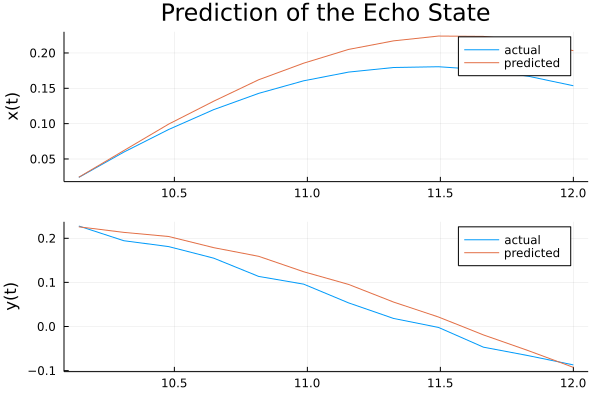

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [42]:
p1 = plot(t_test, [test_data[1,:] output1[1,:]], label = ["actual" "predicted"], 
    ylabel = "x(t)");



p2 = plot(t_test, [test_data[2,:] output1[2,:]], label = ["actual" "predicted"], 
    ylabel = "y(t)");


plot(p1, p2, plot_title = "Prediction of the Echo State", 
    layout=(2,1))

## Surrogate

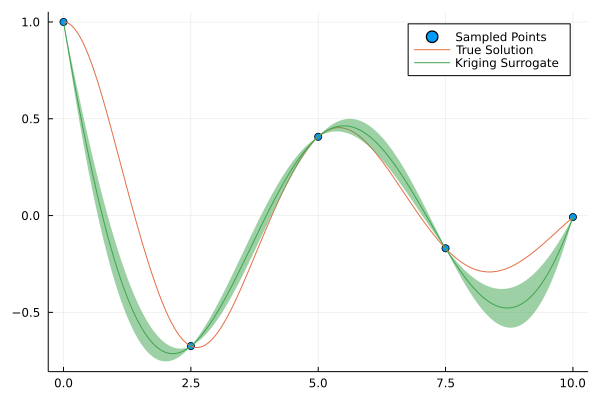

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [43]:
kriging_surrogate = Kriging(t_5, sol_Duffing_5[1,:], 0.0, 10.0);
s_1 = plot()
plot!(s_1,t_5, sol_Duffing_5[1,:], seriestype=:scatter, label="Sampled Points")
plot!(s_1,t_true, sol_Duffing_true[1,:], label="True Solution")
plot!(s_1,t_true, kriging_surrogate.(t_true), label="Kriging Surrogate", ribbon=p->std_error_at_point(kriging_surrogate, p))
#plot!(s_1,t_true_12,kriging_surrogate.(t_true_12))

In [44]:
t_true_12

0.0:0.01:12.0

In [45]:
sum((kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

0.053676220786530913

In [46]:
sum(abs.(kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.15498694519670306

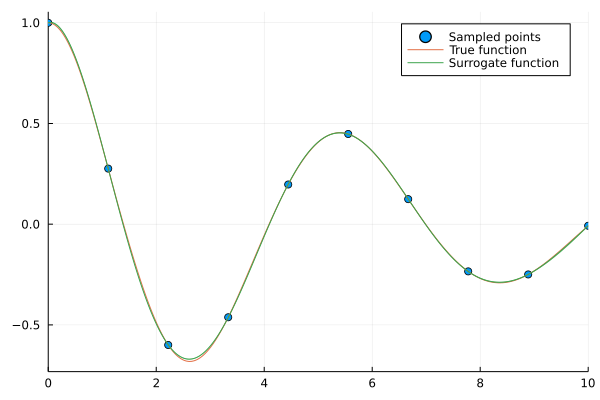

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [47]:
kriging_surrogate = Kriging(t_10, sol_Duffing_10[1,:], 0.0, 10.0);
s_2 = plot()
plot!(s_2,t_10, sol_Duffing_10[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_2,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_2,t_true, kriging_surrogate.(t_true), label="Surrogate function", ribbon=p->std_error_at_point(kriging_surrogate, p))

In [48]:
sum((kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

2.7805374694778987e-5

In [49]:
sum(abs.(kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.003907969822847183

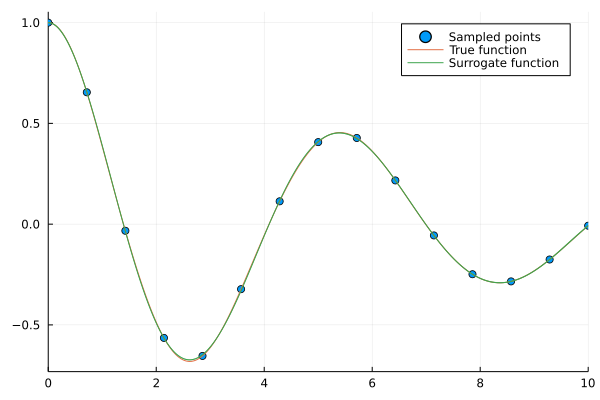

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [50]:
kriging_surrogate = Kriging(t_15, sol_Duffing_15[1,:], 0.0, 10.0);
s_3 = plot()
plot!(s_3,t_15, sol_Duffing_15[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_3,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_3,t_true, kriging_surrogate.(t_true), label="Surrogate function", ribbon=p->std_error_at_point(kriging_surrogate, p))

In [51]:
sum((kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

1.0830798647715359e-5

In [52]:
sum(abs.(kriging_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.00234514199005371

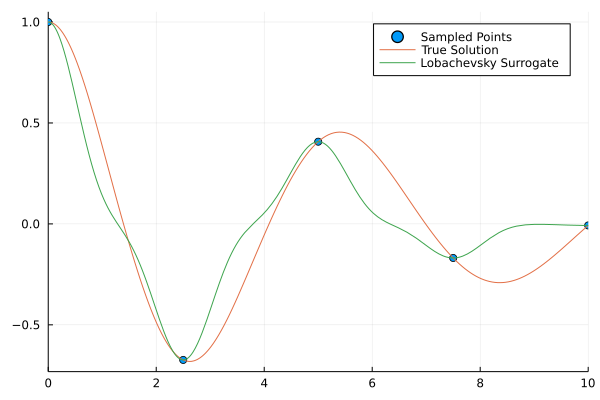

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [53]:
lobachevsky_surrogate = LobachevskySurrogate(t_5, sol_Duffing_5[1,:], 0,10, alpha = 2.0, n = 6)
s_4 = plot()
plot!(s_4,t_5, sol_Duffing_5[1,:], seriestype=:scatter, label="Sampled Points", xlims=(0, 10))
plot!(s_4,t_true, sol_Duffing_true[1,:], label="True Solution")
plot!(s_4,lobachevsky_surrogate, label="Lobachevsky Surrogate")

In [54]:
sum((lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

0.02847049890821865

In [55]:
sum(abs.(lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.1387663712861944

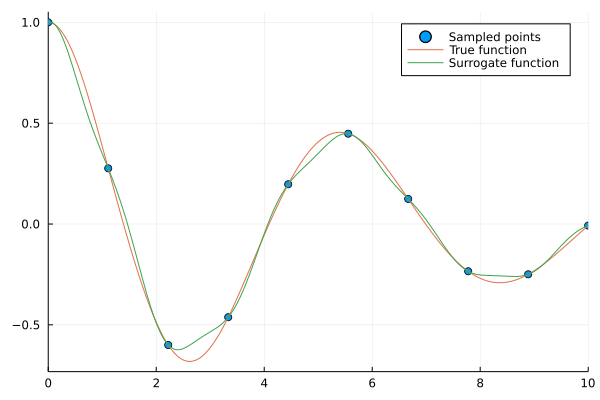

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [56]:
lobachevsky_surrogate = LobachevskySurrogate(t_10, sol_Duffing_10[1,:], 0,10, alpha = 2.0, n = 6)
s_5 = plot()
plot!(s_5,t_10, sol_Duffing_10[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_5,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_5,lobachevsky_surrogate, label="Surrogate function")

In [57]:
sum((lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

0.001468642134463066

In [58]:
sum(abs.(lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.02803612675059899

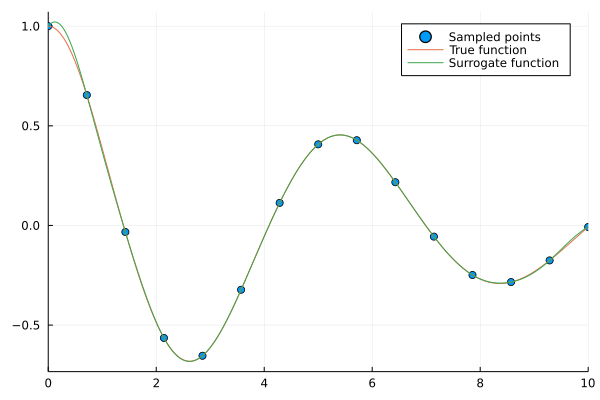

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [59]:
lobachevsky_surrogate = LobachevskySurrogate(t_15, sol_Duffing_15[1,:], 0,10, alpha = 2.0, n = 6)
s_6 = plot()
plot!(s_6,t_15, sol_Duffing_15[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_6,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_6,lobachevsky_surrogate, label="Surrogate function")

In [60]:
sum((lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

9.005973670516932e-5

In [61]:
sum(abs.(lobachevsky_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.003982881188022221

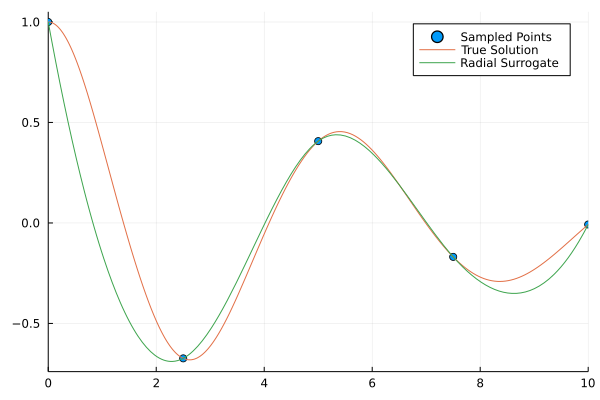

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [62]:
radial_surrogate = RadialBasis(t_5, sol_Duffing_5[1,:], 0,10, rad = cubicRadial())
s_7 = plot()
plot!(s_7,t_5, sol_Duffing_5[1,:], seriestype=:scatter, label="Sampled Points", xlims=(0, 10))
plot!(s_7,t_true, sol_Duffing_true[1,:], label="True Solution")
plot!(s_7,radial_surrogate, label="Radial Surrogate")

In [63]:
sum((radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

0.03714722219996923

In [64]:
sum(abs.(radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.11122684812064047

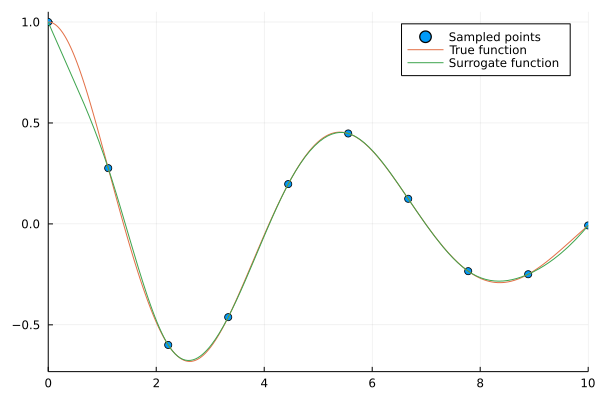

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [65]:
radial_surrogate = RadialBasis(t_10, sol_Duffing_10[1,:], 0,10, rad = cubicRadial())
s_8 = plot()
plot!(s_8,t_10, sol_Duffing_10[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_8,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_8,radial_surrogate, label="Surrogate function")

In [66]:
sum((radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

0.0009619870439020955

In [67]:
sum(abs.(radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.014048562801430275

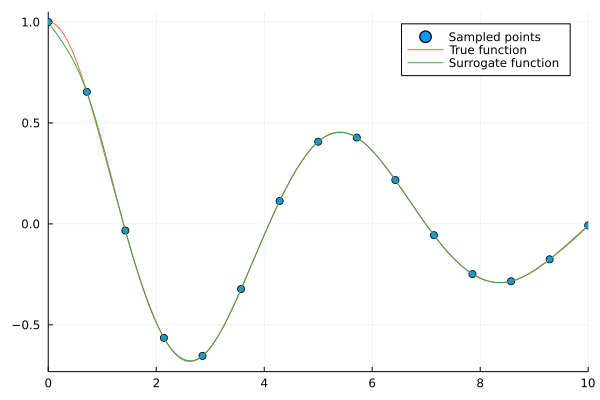

base64 binary data: b3BlbjogTm8gc3VjaCBmaWxlIG9yIGRpcmVjdG9yeQpvcGVuOiBObyBzdWNoIGZpbGUgb3IgZGlyZWN0b3J5CkdLUzogZmlsZSBvcGVuIGVycm9yIChDOlxVc2Vyc1zW3MzsuuNcLmp1bGlhXGFydGlmYWN0c1xjOTM1MTE2YzljN2I5MWI0ZjI3YmEyYjNjOWY3YzZiNjM5YjMwMmFjXGJpblwuLlxGT05UU1xHS1NGT05ULkRBVCkKR0tTOiBmaWxlIG9wZW4gZXJyb3IgKEM6XFVzZXJzXNbczOy641wuanVsaWFcYXJ0aWZhY3RzXGM5MzUxMTZjOWM3YjkxYjRmMjdiYTJiM2M5ZjdjNmI2MzliMzAyYWNcYmluXC4uXEZPTlRTXEdLU0ZPTlQuREFUKQo=


In [68]:
radial_surrogate = RadialBasis(t_15, sol_Duffing_15[1,:], 0,10, rad = cubicRadial())
s_9 = plot()
plot!(s_9,t_15, sol_Duffing_15[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_9,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_9,radial_surrogate, label="Surrogate function")

In [69]:
sum((radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001

9.731511671173149e-5

In [70]:
sum(abs.(radial_surrogate.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001

0.003841888574952201

In [71]:
InverseDistance = InverseDistanceSurrogate(t_5, sol_Duffing_5[1,:], 0,10)

s_10 = plot()
plot!(s_10,t_5, sol_Duffing_5[1,:], seriestype=:scatter, label="Sampled Points", xlims=(0, 10))
plot!(s_10,t_true, sol_Duffing_true[1,:], label="True Solution")
plot!(s_10,InverseDistance, label="Inverse Distance Surrogate")

println(sum((InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001)
println(sum(abs.(InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001)

0.03552200104298845
0.1614809713106749


In [72]:
InverseDistance = InverseDistanceSurrogate(t_10, sol_Duffing_10[1,:], 0,10)

s_11 = plot()
plot!(s_11,t_10, sol_Duffing_10[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_11,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_11,InverseDistance, label="Surrogate function")

println(sum((InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001)
println(sum(abs.(InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001)

0.04333324180310843
0.16251780290219742


In [73]:

InverseDistance = InverseDistanceSurrogate(t_15, sol_Duffing_15[1,:], 0,10)
s_12 = plot()
plot!(s_12,t_15, sol_Duffing_15[1,:], seriestype=:scatter, label="Sampled points", xlims=(0, 10))
plot!(s_12,t_true, sol_Duffing_true[1,:], label="True function")
plot!(s_12,InverseDistance, label="Surrogate function")
println(sum((InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]).^2)/1001)
println(sum(abs.(InverseDistance.(0:0.01:10) - sol_Duffing_true_12[1,1:1001]))/1001)

0.03377123339764625
0.14187510099343975
